# Speech Recording Analysis Pipeline for Experimental Phonetics

**Author:** Chem Vatho, PhD  
**Affiliation:** University of Cologne  
**Date:** February 2026

## Overview

This notebook demonstrates a comprehensive speech recording analysis pipeline suitable for experimental phonetics and linguistic research. The workflow includes:

1. Audio file loading and preprocessing
2. F0 (pitch) extraction and analysis
3. Formant analysis (F1, F2, F3)
4. Voice quality measures
5. Spectral analysis
6. Duration and intensity measurements
7. Statistical analysis and visualization

**Dataset:** This analysis uses the [Speech Accent Archive](https://www.kaggle.com/datasets/rtatman/speech-accent-archive) from Kaggle, which contains recordings of speakers from various linguistic backgrounds reading the same English passage.

## 1. Environment Setup

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install praat-parselmouth
!pip install 'praatio<5'

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.7/10.7 MB 41.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 3.1 MB/s eta 0:00:00


# **Silent detection**

In [ ]:
!pip install pydub

/usr/local/lib/python3.12/dist-packages/pydub/utils.py:300: SyntaxWarning: invalid escape sequence '\('
  m = re.match('([su]([0-9]{1,2})p?) \(([0-9]{1,2}) bit\)$', token)
/usr/local/lib/python3.12/dist-packages/pydub/utils.py:301: SyntaxWarning: invalid escape sequence '\('
  m2 = re.match('([su]([0-9]{1,2})p?)( \(default\))?$', token)
/usr/local/lib/python3.12/dist-packages/pydub/utils.py:310: SyntaxWarning: invalid escape sequence '\('
  elif re.match('(flt)p?( \(default\))?$', token):
/usr/local/lib/python3.12/dist-packages/pydub/utils.py:314: SyntaxWarning: invalid escape sequence '\('
  elif re.match('(dbl)p?( \(default\))?$', token):


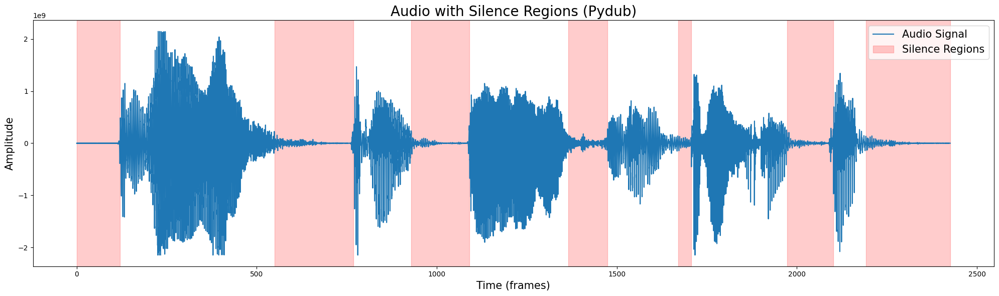

In [ ]:
from pydub import AudioSegment
from pydub.silence import detect_nonsilent
import matplotlib.pyplot as plt
import numpy as np

# Load the audio file
audio_path = "/content/NSNW-1-01.wav"  # Replace with your audio file path
audio = AudioSegment.from_wav(audio_path)

# Detect nonsilent regions (returns in ms)
nonsilent_regions = detect_nonsilent(
    audio,
    min_silence_len=20,  # Minimum silence length in ms
    silence_thresh=-30  # Silence threshold in dBFS
)

# Calculate silence regions
silence_regions = []
start_time = 0
for start, end in nonsilent_regions:
    if start > start_time:
        silence_regions.append((start_time, start))  # Add silence region before the non-silent region
    start_time = end
if start_time < len(audio):
    silence_regions.append((start_time, len(audio)))  # Add silence region after the last non-silent region

# Plot the silence regions
# Plot the silence regions
def plot_audio_silence(audio, silence_regions):
    # Convert the audio to samples for plotting
    samples = np.array(audio.get_array_of_samples())
    duration_ms = len(audio)  # Length of the audio in milliseconds

    # Create the x-axis in milliseconds
    x_ms = np.linspace(0, duration_ms, len(samples))

    plt.figure(figsize=(20, 6))

    # Plot the full audio waveform
    plt.plot(x_ms, samples, label="Audio Signal")

    # Plot silence regions
    label_added = False  # Track if the label for silence regions has been added
    for start, end in silence_regions:
        # Add the label only for the first silence region
        if not label_added:
            plt.axvspan(start, end, color="red", alpha=0.2, label="Silence Regions")
            label_added = True
        else:
            plt.axvspan(start, end, color="red", alpha=0.2)

    plt.title("Audio with Silence Regions (Pydub)", fontsize=20)
    plt.xlabel("Time (frames)", fontsize=15)  # Use time in milliseconds for the x-axis
    plt.ylabel("Amplitude", fontsize=15)
    plt.legend(fontsize=15, loc='upper right')  # Adjust the font size as desired
    plt.grid(False)
    plt.tight_layout()
    plt.savefig("audio_with_silence_regions.png", dpi=1000)
    plt.show()


# Plot the audio with the silence regions
plot_audio_silence(audio, silence_regions)


# MEL spectrogram and chroma

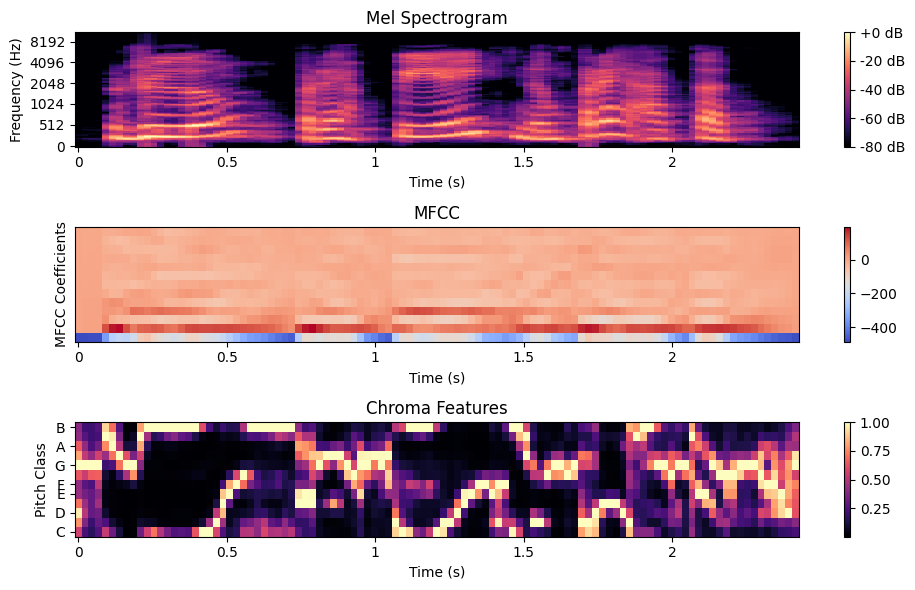

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

# Load the audio file
audio_path = "/content/NSNW-1-01.wav"
y, sr = librosa.load(audio_path)

# Compute Features
mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
spectrogram = librosa.feature.melspectrogram(y=y, sr=sr)
chroma = librosa.feature.chroma_stft(y=y, sr=sr)

# Plot Features
plt.figure(figsize=(10, 6))

# Plot Spectrogram
plt.subplot(3, 1, 1)
librosa.display.specshow(librosa.power_to_db(spectrogram, ref=np.max), sr=sr, x_axis='time', y_axis='mel')
plt.title("Mel Spectrogram")
plt.colorbar(format="%+2.0f dB")
plt.xlabel("Time (s)")
plt.ylabel("Frequency (Hz)")

# Plot MFCC
plt.subplot(3, 1, 2)
librosa.display.specshow(mfcc, sr=sr, x_axis='time')
plt.title("MFCC")
plt.colorbar()
plt.xlabel("Time (s)")
plt.ylabel("MFCC Coefficients")

# Plot Chroma Features
plt.subplot(3, 1, 3)
librosa.display.specshow(chroma, sr=sr, x_axis='time', y_axis='chroma')
plt.title("Chroma Features")
plt.colorbar()
plt.xlabel("Time (s)")
plt.ylabel("Pitch Class")

plt.tight_layout()
plt.savefig("audio_features.png", dpi=1500, bbox_inches='tight')
plt.show()


/tmp/ipython-input-52678410.py:17: UserWarning: With fmin=16.352, sr=22050 and frame_length=2048, less than two periods of fmin fit into the frame, which can cause inaccurate pitch detection. Consider increasing to fmin=21.533 or frame_length=2699.
  f0, voiced_flag, voiced_probs = librosa.pyin(y, sr=sr, fmin=librosa.note_to_hz('C0'), fmax=librosa.note_to_hz('C7'))  # Pitch


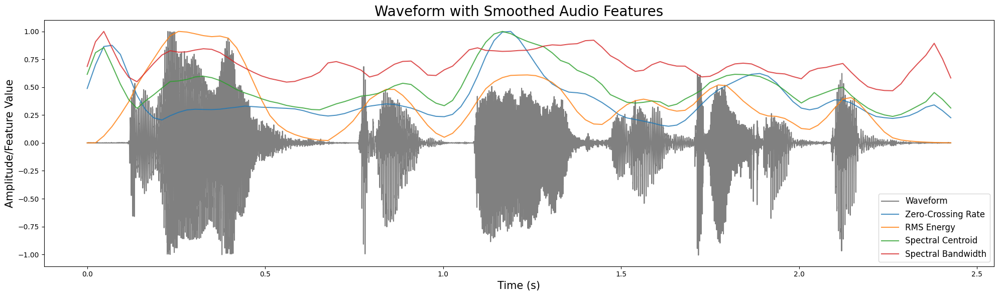

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

def smooth(data, window_size=5):
    """Smooth data using a simple moving average."""
    return np.convolve(data, np.ones(window_size) / window_size, mode='same')

# Load the audio file
audio_path = "/content/NSNW-1-01.wav"  # Replace with your audio file path
y, sr = librosa.load(audio_path)

# Calculate features
zcr = librosa.feature.zero_crossing_rate(y=y)[0]  # Zero-Crossing Rate
rms = librosa.feature.rms(y=y)[0]  # RMS Energy
f0, voiced_flag, voiced_probs = librosa.pyin(y, sr=sr, fmin=librosa.note_to_hz('C0'), fmax=librosa.note_to_hz('C7'))  # Pitch
centroid = librosa.feature.spectral_centroid(y=y, sr=sr)[0]  # Spectral Centroid
bandwidth = librosa.feature.spectral_bandwidth(y=y, sr=sr)[0]  # Spectral Bandwidth

# Smooth the features
zcr_smoothed = smooth(zcr)
rms_smoothed = smooth(rms)
if f0 is not None:
    f0_smoothed = smooth(np.nan_to_num(f0))  # Handle NaN values before smoothing
else:
    f0_smoothed = None
centroid_smoothed = smooth(centroid)
bandwidth_smoothed = smooth(bandwidth)

# Time axis for waveform and features
time_waveform = np.linspace(0, len(y) / sr, len(y))
time_features = np.linspace(0, len(y) / sr, len(zcr))  # Features like ZCR and others have lower resolution

# Plot the waveform and smoothed features
plt.figure(figsize=(20, 6))

# Plot waveform
plt.plot(time_waveform, y, label="Waveform", alpha=1, color='gray')

# Plot Zero-Crossing Rate
plt.plot(time_features, zcr_smoothed / np.max(zcr_smoothed), label="Zero-Crossing Rate", alpha=0.8)

# Plot RMS Energy
plt.plot(time_features, rms_smoothed / np.max(rms_smoothed), label="RMS Energy", alpha=0.8)

# Plot Pitch/F0
#if f0_smoothed is not None:
    #plt.plot(time_features, f0_smoothed / np.max(f0_smoothed), label="Pitch/F0", alpha=0.8)

# Plot Spectral Centroid
plt.plot(time_features, centroid_smoothed / np.max(centroid_smoothed), label="Spectral Centroid", alpha=0.8)

# Plot Spectral Bandwidth
plt.plot(time_features, bandwidth_smoothed / np.max(bandwidth_smoothed), label="Spectral Bandwidth", alpha=0.8)

# Configure plot
plt.title("Waveform with Smoothed Audio Features", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Amplitude/Feature Value", fontsize=15)
plt.legend(fontsize=12, loc='lower right')
#plt.grid()
plt.tight_layout()
plt.savefig("audio_features_smoothed.png", dpi=1000)
plt.show()


# Extract acoustic cues from dataset, audio + textgrid

In [ ]:
import os
import parselmouth
import pandas as pd
import numpy as np
from praatio import tgio


# Define the list of vowels
vowels = [
    'iː', 'ɨː', 'uː', 'eː', 'ɘː', 'oː', 'ɛː', 'ɔː', 'aː', 'ɑː',
    'i', 'ɨ', 'u', 'e', 'ɘ', 'o', 'ɛ', 'ɜ', 'ɔ', 'a', 'ɑ', 'ə',
    'iɜ', 'ɨɜ', 'uɜ', 'aɛ', 'aɜ', 'aɔ', 'oa', 'ɛe', 'ou', 'ɜɘ',
    'ĭɜ', 'ŭɜ', 'ɛ̆a', 'iə',
]


def extract_features(audio_path, textgrid_path, speaker):
    sound = parselmouth.Sound(audio_path)
    tg = tgio.openTextgrid(textgrid_path)

    # Check for required tiers
    if 'phones' not in tg.tierNameList or 'words' not in tg.tierNameList:
        print(f"Missing required tiers in {textgrid_path}")
        return []

    phones_tier = tg.tierDict['phones']
    words_tier = tg.tierDict['words']
    features = []

    for entry in phones_tier.entryList:
        phone_label = entry.label.strip().lower()
        start_time, end_time = entry.start, entry.end
        duration = end_time - start_time

        # Find corresponding word for this phone interval in the words tier
        word_label = ""
        for word_entry in words_tier.entryList:
            if start_time >= word_entry.start and end_time <= word_entry.end:
                word_label = word_entry.label.strip()
                break

        if phone_label in vowels:
            # Extract pitch (F0) and formants (F1, F2)
            pitch = sound.to_pitch()
            formant = sound.to_formant_burg(
                time_step=0.01, max_number_of_formants=5,
                maximum_formant=5500, window_length=0.025,
                pre_emphasis_from=30
            )

            # Select valid pitch values in the interval
            pitch_values = pitch.selected_array['frequency']
            pitch_times = pitch.xs()
            valid_pitch_indices = np.where((pitch_times >= start_time) & (pitch_times <= end_time) & (pitch_values > 0))

            mean_f0 = np.mean(pitch_values[valid_pitch_indices]) if valid_pitch_indices[0].size > 0 else np.nan

            # Extract formants F1 and F2 in the interval
            formant_values_f1 = []
            formant_values_f2 = []
            for t in np.arange(start_time, end_time, 0.01):
                f1 = formant.get_value_at_time(1, t)
                f2 = formant.get_value_at_time(2, t)
                if f1 is not None:
                    formant_values_f1.append(f1)
                if f2 is not None:
                    formant_values_f2.append(f2)

            mean_f1 = np.mean(formant_values_f1) if formant_values_f1 else np.nan
            mean_f2 = np.mean(formant_values_f2) if formant_values_f2 else np.nan

            # Extract harmonics (H1, H2) as an example
            harmonic_1 = formant.get_value_at_time(1, start_time) if formant.get_value_at_time(1, start_time) else np.nan
            harmonic_2 = formant.get_value_at_time(2, start_time) if formant.get_value_at_time(2, start_time) else np.nan

            features.append([
                os.path.basename(audio_path).replace('.wav', ''),
                speaker, word_label, phone_label, duration, mean_f0, mean_f1, mean_f2, harmonic_1, harmonic_2
            ])

    return features


# Define the root directory containing the folders with speaker data (audio and TextGrid files)
root_directory = '/content/drive/MyDrive/PP_vowel/tg_2/'

# Create an empty DataFrame to store the features
columns = ['file_name', 'speaker', 'word', 'vowel', 'duration', 'f0', 'f1', 'f2', 'H1', 'H2']
df = pd.DataFrame(columns=columns)

# Iterate through each speaker folder in the root directory
for folder in os.listdir(root_directory):
    folder_path = os.path.join(root_directory, folder)

    if os.path.isdir(folder_path):  # Ensure it's a directory (speaker folder)
        # Process each subfolder within the speaker folder
        for subfolder in os.listdir(folder_path):
            subfolder_path = os.path.join(folder_path, subfolder)

            if os.path.isdir(subfolder_path):  # Ensure it's a directory (subfolder)
                # Process each audio file and its corresponding TextGrid file in the subfolder
                for file in os.listdir(subfolder_path):
                    if file.endswith('.wav'):
                        audio_file = os.path.join(subfolder_path, file)
                        textgrid_file = os.path.join(subfolder_path, file.replace('.wav', '.TextGrid'))

                        if os.path.exists(textgrid_file):
                            print(f"Processing {audio_file}...")
                            features = extract_features(audio_file, textgrid_file, speaker=folder)

                            # Add the features to the DataFrame using pd.concat()
                            if features:
                                df = pd.concat([df, pd.DataFrame(features, columns=columns)], ignore_index=True)

# Print the extracted features
print("Extracted Features:")
print(df)

# Save the features to a CSV file
output_csv = '/content/khmer_vowel_features.csv'
df.to_csv(output_csv, index=False)
print(f'Features saved to {output_csv}')


Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_1.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_2.wav...


/tmp/ipython-input-2522496362.py:113: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, pd.DataFrame(features, columns=columns)], ignore_index=True)


Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_3.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_4.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_5.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_6.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_7.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_8.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_9.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_10.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_11.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_12.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_13.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_14.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_15.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_16.wav...

# Compare duration

Average durations for long and short vowels, split by monophthong and diphthong:
vowel_length  vowel_type 
long          diphthong      0.241509
              monophthong    0.265776
short         diphthong      0.190000
              monophthong    0.116907
Name: duration, dtype: float64


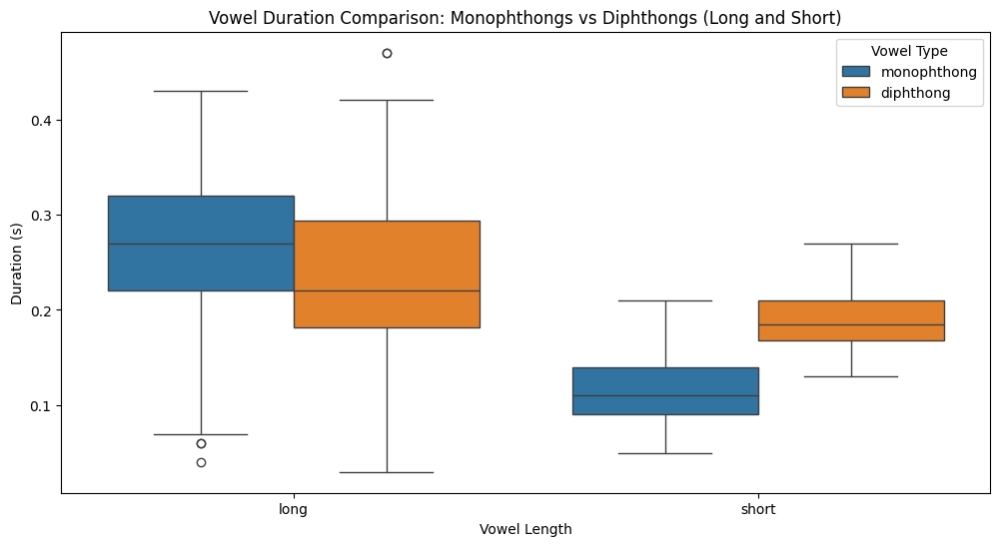

In [ ]:
# Import matplotlib.pyplot for plotting
import matplotlib.pyplot as plt
# Import seaborn for statistical data visualization
import seaborn as sns



# Define lists of long and short monophthongs and diphthongs
long_monophthongs = ['iː', 'ɨː', 'uː', 'eː', 'ɘː', 'oː', 'ɛː', 'ɔː', 'aː', 'ɑː']
short_monophthongs = ['i', 'ɨ', 'u', 'e', 'ɘ', 'o', 'ɛ', 'ɜ', 'ɔ', 'a', 'ɑ']
long_diphthongs = ['iɜ', 'ɨɜ', 'uɜ', 'aɛ', 'aɜ', 'aɔ', 'oa', 'ɛe', 'ou', 'ɜɘ', 'iə']
short_diphthongs = ['ĭɜ', 'ŭɜ', 'ɛ̆a']

# Add columns for vowel length and vowel type
def classify_vowel(vowel):
    if vowel in long_monophthongs:
        return 'long', 'monophthong'
    elif vowel in short_monophthongs:
        return 'short', 'monophthong'
    elif vowel in long_diphthongs:
        return 'long', 'diphthong'
    elif vowel in short_diphthongs:
        return 'short', 'diphthong'
    else:
        return 'unknown', 'unknown'

df[['vowel_length', 'vowel_type']] = df['vowel'].apply(lambda x: pd.Series(classify_vowel(x)))

# Calculate average durations for each vowel length and type
average_durations = df[(df['vowel_length'] != 'unknown') & (df['vowel_type'] != 'unknown')].groupby(['vowel_length', 'vowel_type'])['duration'].mean()
print("Average durations for long and short vowels, split by monophthong and diphthong:")
print(average_durations)

# Visualize the results
plt.figure(figsize=(12, 6))
sns.boxplot(x='vowel_length', y='duration', hue='vowel_type', data=df[(df['vowel_length'] != 'unknown') & (df['vowel_type'] != 'unknown')])
plt.title("Vowel Duration Comparison: Monophthongs vs Diphthongs (Long and Short)")
plt.xlabel("Vowel Length")
plt.ylabel("Duration (s)")
plt.legend(title="Vowel Type")
plt.show()


# all vowels

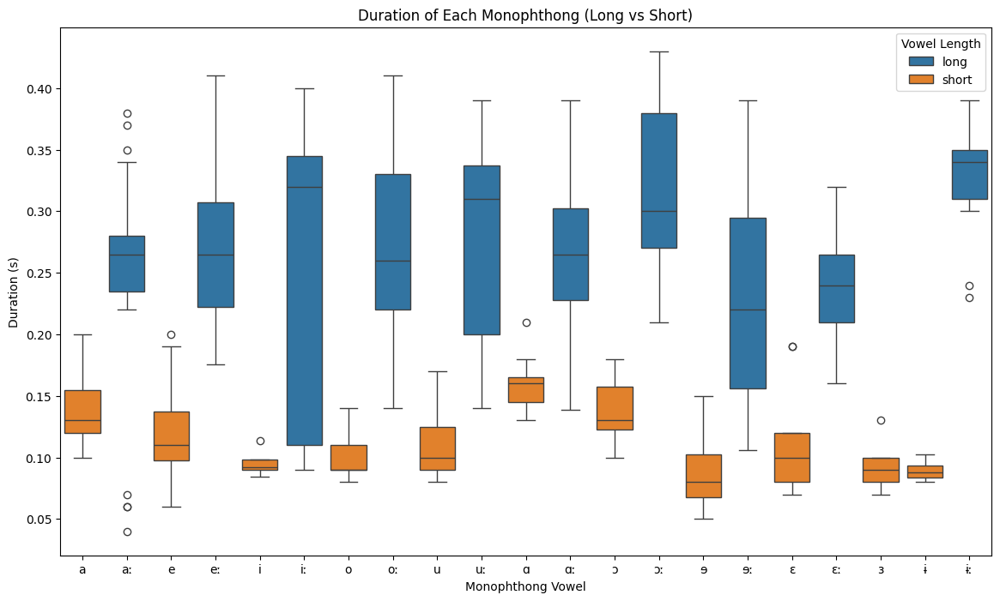

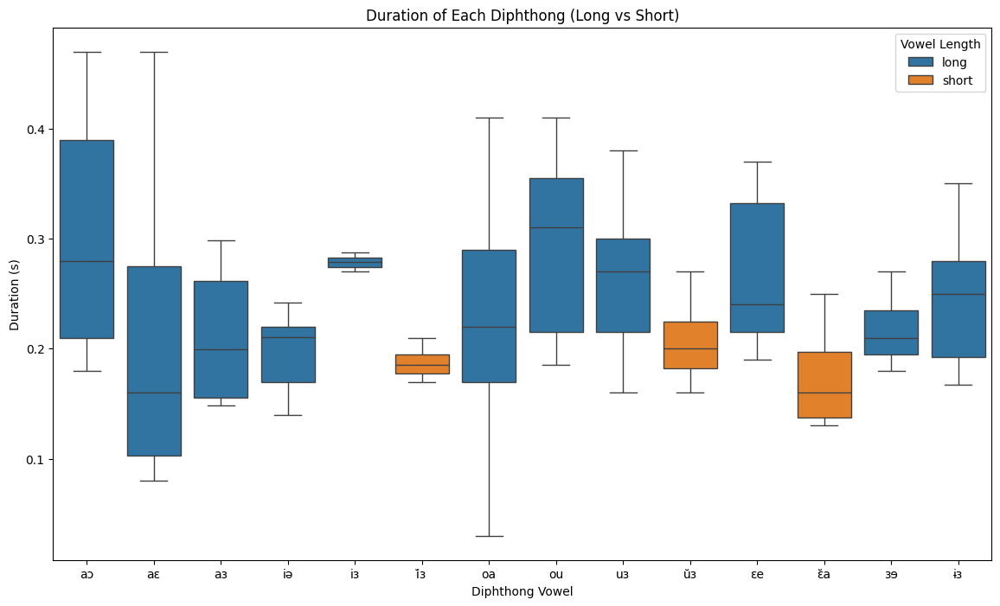

In [ ]:
# Filter the DataFrame for monophthongs and diphthongs
monophthongs_df = df[df['vowel_type'] == 'monophthong']
diphthongs_df = df[df['vowel_type'] == 'diphthong']

# Plot durations for each monophthong individually
plt.figure(figsize=(14, 8))
sns.boxplot(x='vowel', y='duration', hue='vowel_length', data=monophthongs_df, order=sorted(monophthongs_df['vowel'].unique()))
plt.title("Duration of Each Monophthong (Long vs Short)")
plt.xlabel("Monophthong Vowel")
plt.ylabel("Duration (s)")
plt.xticks(rotation=0)
plt.legend(title="Vowel Length")
plt.show()

# Plot durations for each diphthong individually
plt.figure(figsize=(14, 8))
sns.boxplot(x='vowel', y='duration', hue='vowel_length', data=diphthongs_df, order=sorted(diphthongs_df['vowel'].unique()))
plt.title("Duration of Each Diphthong (Long vs Short)")
plt.xlabel("Diphthong Vowel")
plt.ylabel("Duration (s)")
plt.xticks(rotation=0)
plt.legend(title="Vowel Length")
plt.show()


# duration by speakers

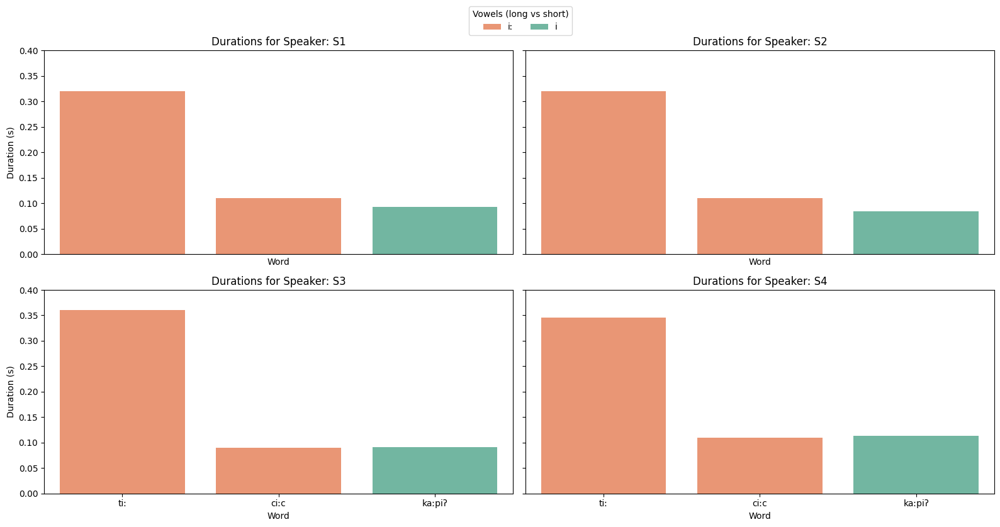

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import re
import math

# Define the target words and vowels, and the order you want to display them
target_words = ['កាពិ', 'ជីក', 'ទី']
word_order = ['ទី','ជីក','កាពិ',]
word_translations = {'កាពិ': 'kaːpiʔ', 'ជីក': 'ciːc', 'ទី': 'tiː'}
target_vowels = ['i', 'iː']

# Filter the DataFrame for only the target words and vowels
filtered_df = df[(df['word'].isin(target_words)) & (df['vowel'].isin(target_vowels))].copy()

# Standardize speaker names
def clean_speaker_name(name):
    name = re.sub(r'[\d\(\)]', '', name).strip()  # Remove numbers and parentheses
    name = name.lower()  # Convert to lowercase for consistency
    if name in ["sopheab", "sopheap"]:
        name = "sopheap"
    return name

# Apply the function to the 'file_name' column
filtered_df['speaker'] = filtered_df['file_name'].apply(clean_speaker_name)

# Map Khmer words to their transliterations
filtered_df['word_trans'] = filtered_df['word'].map(word_translations)

# Create a mapping for speaker names to generic labels S1, S2, ...
unique_speakers = filtered_df['speaker'].unique()
speaker_mapping = {speaker: f"S{i+1}" for i, speaker in enumerate(unique_speakers)}
filtered_df['speaker_label'] = filtered_df['speaker'].map(speaker_mapping)

# Set up a grid with 2 columns
num_speakers = len(unique_speakers)
cols = 2
rows = math.ceil(num_speakers / cols)

# Determine the maximum duration to set y-axis limits uniformly
max_duration = filtered_df['duration'].max()

# Define a color palette for vowels (long vs short)
palette = sns.color_palette("Set2", n_colors=len(target_vowels))

# Map vowels to colors based on the target vowels
vowel_color_mapping = {vowel: palette[i] for i, vowel in enumerate(target_vowels)}

fig, axes = plt.subplots(rows, cols, figsize=(16, rows * 4))
axes = axes.flatten()  # Flatten axes array for easy iteration

for i, (speaker, label) in enumerate(speaker_mapping.items()):
    # Filter data for the current speaker
    speaker_data = filtered_df[filtered_df['speaker'] == speaker]

    # Plot for each speaker in a separate subplot
    sns.barplot(x='word_trans', y='duration', hue='vowel', data=speaker_data,
                order=[word_translations[w] for w in word_order], palette=vowel_color_mapping, ax=axes[i], errorbar=None)

    # Set y-axis limits to ensure all plots have the same scale
    axes[i].set_ylim(0, max_duration)

    # Customize plot labels
    axes[i].set_title(f"Durations for Speaker: {label}")
    axes[i].set_xlabel("Word")

    # Only add y-axis label for plots in the first column
    if i % cols == 0:
        axes[i].set_ylabel("Duration (s)")
    else:
        axes[i].set_ylabel("")
        # Hide the y-axis ticks for plots in the second column
        axes[i].tick_params(axis='y', labelleft=False)

    # Hide x-axis labels and ticks for the first row
    if i < cols:
        axes[i].tick_params(axis='x', labelbottom=False)
        axes[i].set_xticks([])  # Completely remove the x-axis ticks and labels

    # Hide individual legends
    axes[i].get_legend().set_visible(False)

# Add one legend to the entire figure
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, title="Vowels (long vs short)", loc='upper center', bbox_to_anchor=(0.52, 1.05), ncol=2)

# Remove any empty subplots if the number of speakers is odd
for j in range(i + 1, rows * cols):
    fig.delaxes(axes[j])

plt.tight_layout()

# Save the plot as a PNG file
plt.savefig('vowel_durations_plot.png', dpi=500, bbox_inches='tight')

plt.show()


# **Vowel plot, f1 and f2**

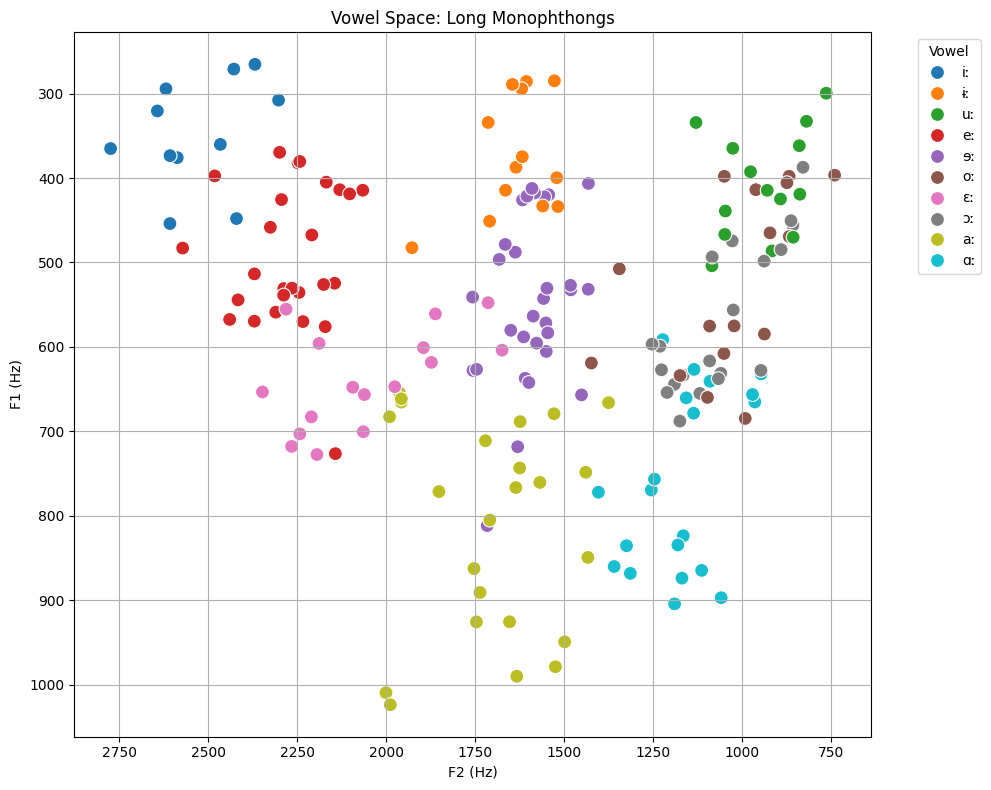

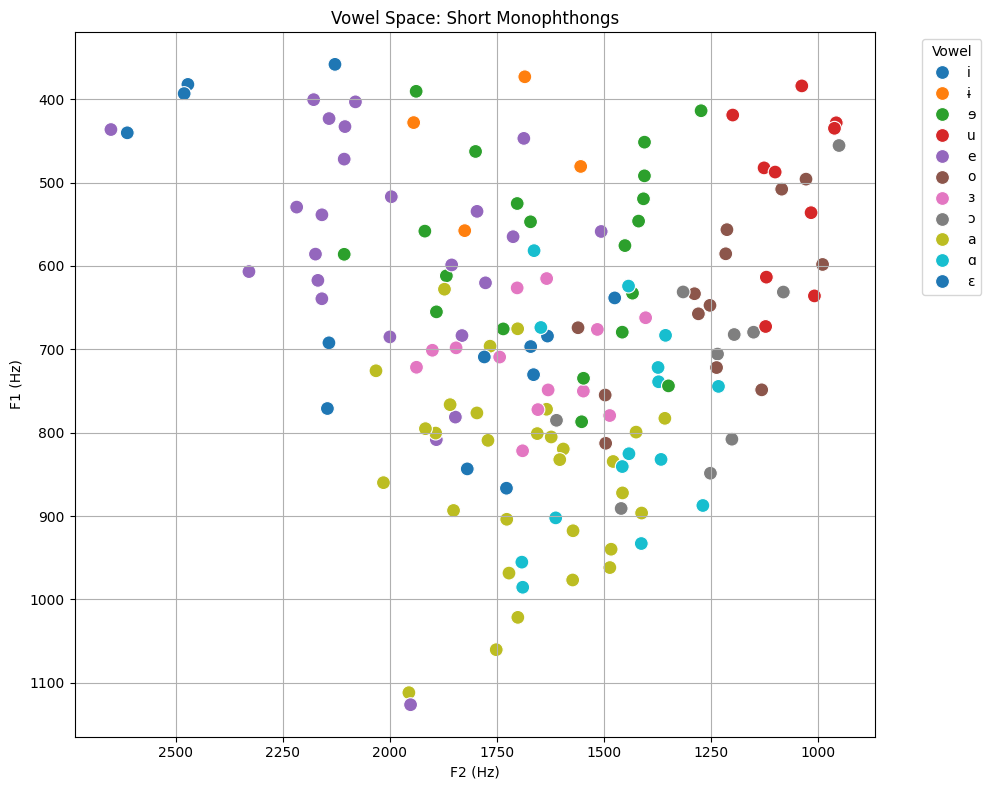

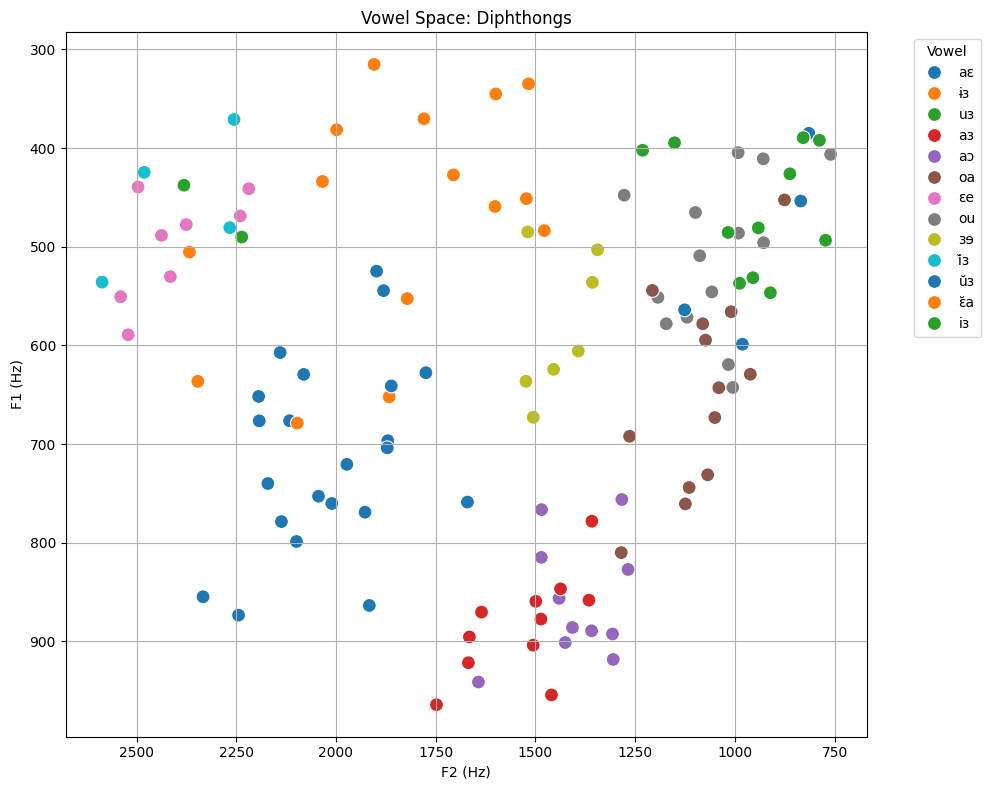

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Define vowel groups
long_monophthongs = ['iː', 'ɨː', 'uː', 'eː', 'ɘː', 'oː', 'ɛː', 'ɔː', 'aː', 'ɑː']
short_monophthongs = ['i', 'ɨ', 'u', 'e', 'ɘ', 'o', 'ɛ', 'ɜ', 'ɔ', 'a', 'ɑ']
diphthongs = ['iɜ', 'ɨɜ', 'uɜ', 'aɛ', 'aɜ', 'aɔ', 'oa', 'ɛe', 'ou', 'ɜɘ', 'ĭɜ', 'ŭɜ', 'ɛ̆a']

# Load the extracted features CSV
df = pd.read_csv('/content/khmer_vowel_features.csv')

# Function to plot vowel space using seaborn
def plot_vowel_space(vowel_group, title):
    filtered_df = df[df['vowel'].isin(vowel_group)]

    plt.figure(figsize=(10, 8))

    # Create the plot
    sns.scatterplot(data=filtered_df, x='f2', y='f1', hue='vowel', palette='tab10', s=100, edgecolor='w')

    plt.gca().invert_xaxis()  # Invert F2 axis (x-axis)
    plt.gca().invert_yaxis()  # Invert F1 axis (y-axis)

    plt.title(title)
    plt.xlabel('F2 (Hz)')
    plt.ylabel('F1 (Hz)')
    plt.legend(title='Vowel', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Plot for each vowel group
plot_vowel_space(long_monophthongs, 'Vowel Space: Long Monophthongs')
plot_vowel_space(short_monophthongs, 'Vowel Space: Short Monophthongs')
plot_vowel_space(diphthongs, 'Vowel Space: Diphthongs')


# vowel space with comparison metrics

Covariance matrix for iː: 
[[19969.07548812  2669.23387305]
 [ 2669.23387305  4106.4360464 ]]
Covariance matrix for ɨː: 
[[11962.03635438  2806.19965827]
 [ 2806.19965827  4844.84030305]]
Covariance matrix for uː: 
[[12692.9829777   2240.05006421]
 [ 2240.05006421  3932.91700609]]
Covariance matrix for eː: 
[[14786.55188355   406.23136617]
 [  406.23136617  7053.96576302]]
Covariance matrix for ɘː: 
[[8293.82594197 2391.43017114]
 [2391.43017114 9358.46373126]]
Covariance matrix for oː: 
[[30619.44765265 10030.48915003]
 [10030.48915003 10826.91667837]]
Covariance matrix for ɛː: 
[[42810.62727995  6471.0861651 ]
 [ 6471.0861651   3392.32520063]]
Covariance matrix for ɔː: 
[[18251.97879076  9122.00698196]
 [ 9122.00698196  7415.16455029]]
Covariance matrix for aː: 
[[37962.9833369   -231.24640969]
 [ -231.24640969 15782.54859291]]
Covariance matrix for ɑː: 
[[16199.31653095  5770.47861272]
 [ 5770.47861272 11250.89617814]]


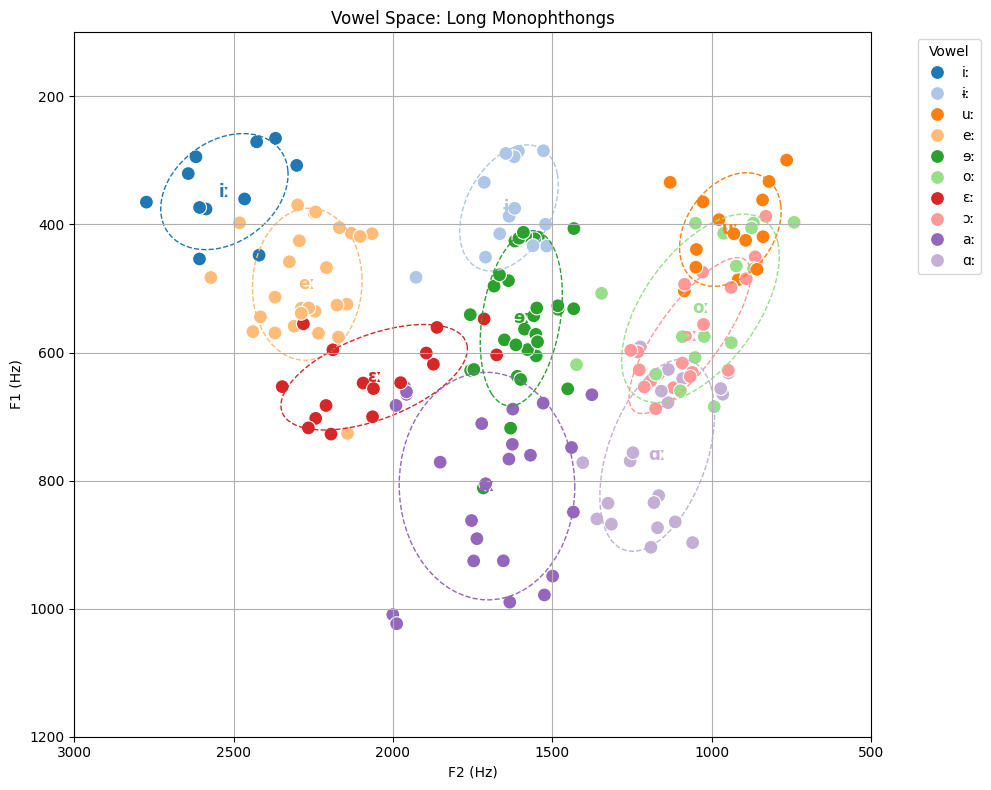

Covariance matrix for i: 
[[42966.02246477  6254.95892435]
 [ 6254.95892435  1188.1885926 ]]
Covariance matrix for ɨ: 
[[28680.29959313   916.72443589]
 [  916.72443589  6177.93956722]]
Covariance matrix for u: 
[[ 6442.03507394  1328.26434593]
 [ 1328.26434593 10156.23309428]]
Covariance matrix for e: 
[[59506.81939329 -9889.10068189]
 [-9889.10068189 25685.40036285]]
Covariance matrix for ɘ: 
[[57317.13746081 -1217.1792552 ]
 [-1217.1792552  12261.92793101]]
Covariance matrix for o: 
[[31821.42814235 11450.44925312]
 [11450.44925312  9380.866295  ]]
Covariance matrix for ɛ: 
[[51229.3324419   4592.58899273]
 [ 4592.58899273  5781.83705238]]
Covariance matrix for ɜ: 
[[ 2.58188519e+04 -1.43923948e+01]
 [-1.43923948e+01  3.65544108e+03]]
Covariance matrix for ɔ: 
[[34659.21869777 16609.64253981]
 [16609.64253981 16220.40994572]]
Covariance matrix for a: 
[[34456.49797246 -2549.83842536]
 [-2549.83842536 12496.71956532]]
Covariance matrix for ɑ: 
[[23649.021899    2869.36483001]
 [ 2869

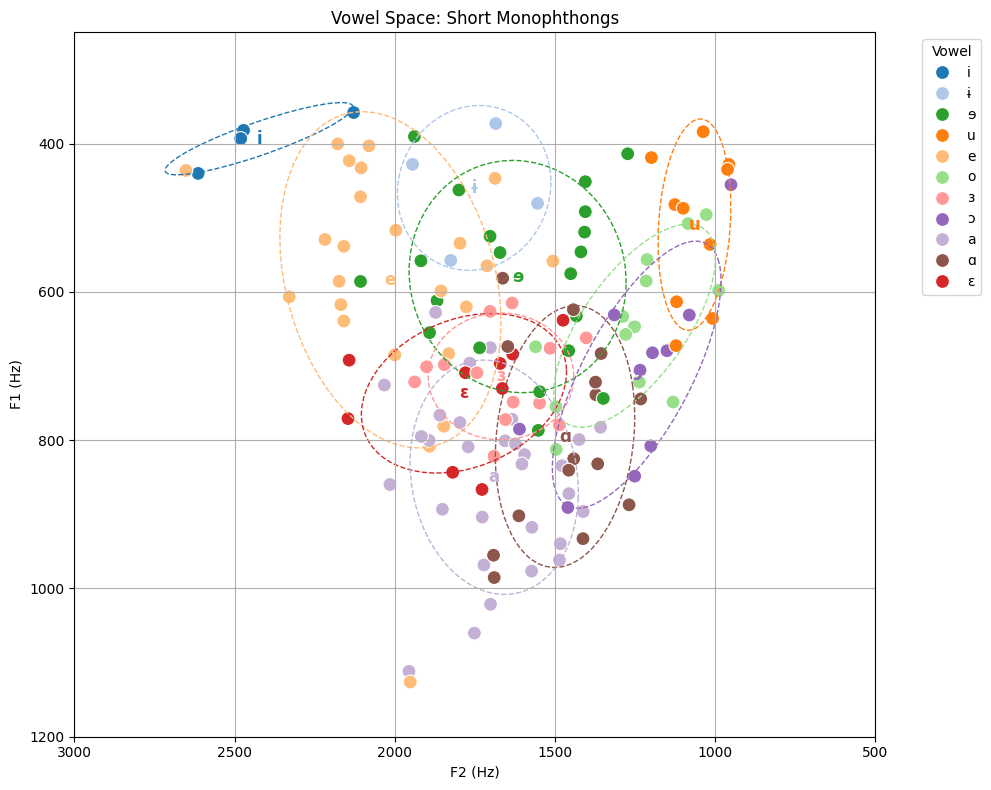

Covariance matrix for iɜ: 
[[10506.20037861 -3806.36114695]
 [-3806.36114695  1379.0318725 ]]
Covariance matrix is singular for iɜ. Skipping ellipse.
Covariance matrix for ɨɜ: 
[[39126.85422493 -1502.59041587]
 [-1502.59041587  5178.36523292]]
Covariance matrix for uɜ: 
[[20725.67360211 -1138.23117718]
 [-1138.23117718  3901.84065536]]
Covariance matrix for aɛ: 
[[27942.73110586  5067.01545711]
 [ 5067.01545711  9096.92882725]]
Covariance matrix for aɜ: 
[[16940.15936476  4425.97882655]
 [ 4425.97882655  2736.70920815]]
Covariance matrix for aɔ: 
[[12624.68513046  1574.22097384]
 [ 1574.22097384  3689.69762061]]
Covariance matrix for oa: 
[[13128.54099728  6935.97516842]
 [ 6935.97516842 10113.64794833]]
Covariance matrix for ɛe: 
[[14858.10846651  4053.5191632 ]
 [ 4053.5191632   2877.7916971 ]]
Covariance matrix for ou: 
[[16861.9016545   3387.56939904]
 [ 3387.56939904  6090.10488856]]
Covariance matrix for ɜɘ: 
[[6001.67151062 2278.1938924 ]
 [2278.1938924  5210.28248507]]
Covarian

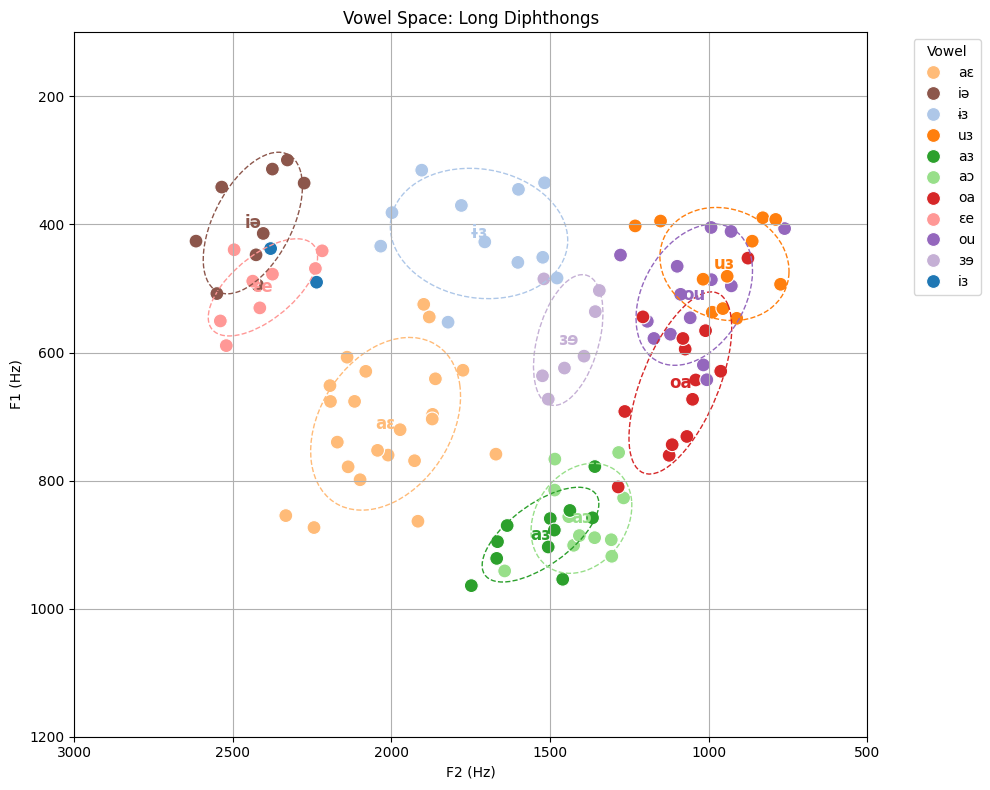

Covariance matrix for ĭɜ: 
[[26652.74667324  7092.27828132]
 [ 7092.27828132  5050.67662165]]
Covariance matrix for ŭɜ: 
[[21028.64256665 11747.89157856]
 [11747.89157856  9733.83825602]]
Covariance matrix for ɛ̆a: 
[[ 55804.14195016 -11261.64721169]
 [-11261.64721169   5954.85410409]]


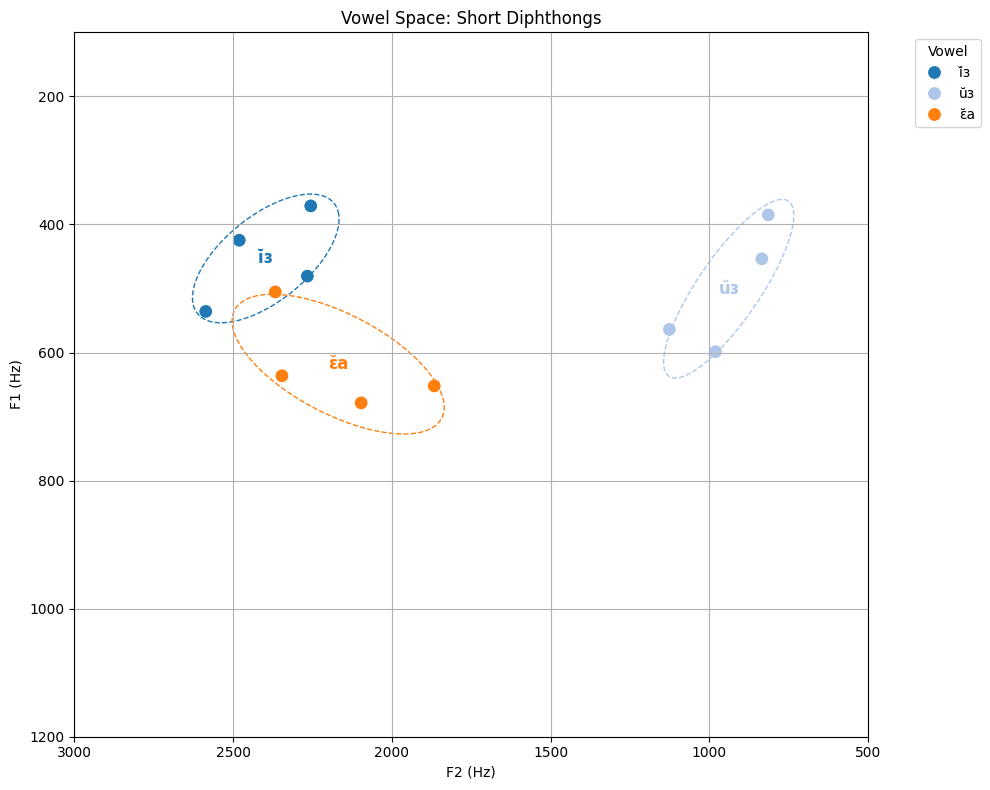

In [ ]:
import numpy as np
import matplotlib.patches as patches

# Assume df and vowel groups are already defined

def plot_vowel_space(vowel_group, title, xlim=None, ylim=None):
    filtered_df = df[df['vowel'].isin(vowel_group)]

    # Set up a larger color palette
    palette = sns.color_palette('tab20', n_colors=len(vowel_group))
    color_map = dict(zip(vowel_group, palette))

    plt.figure(figsize=(10, 8))

    # Plot the points using Seaborn
    sns.scatterplot(data=filtered_df, x='f2', y='f1', hue='vowel', palette=color_map, s=100, edgecolor='w')

    # Calculate and plot ellipses
    for vowel in vowel_group:
        vowel_df = filtered_df[filtered_df['vowel'] == vowel]

        if len(vowel_df) > 1:  # Ensure there's enough data to calculate an ellipse
            mean = vowel_df[['f2', 'f1']].mean().values
            cov = np.cov(vowel_df[['f2', 'f1']].values.T)
            print(f"Covariance matrix for {vowel}: \n{cov}")  # Debug print

            try:
                # Ensure covariance matrix is not singular
                if np.linalg.matrix_rank(cov) < 2:
                    print(f"Covariance matrix is singular for {vowel}. Skipping ellipse.")
                    continue

                v, w = np.linalg.eigh(cov)
                v = 2.0 * np.sqrt(2.0) * np.sqrt(v)  # Scaling factor for the ellipse

                # Ensure positive ellipse dimensions
                if any(dim <= 0 for dim in v):
                    print(f"Invalid ellipse dimensions for {vowel}: {v}. Skipping ellipse.")
                    continue

                u = w[:, 0] / np.linalg.norm(w[:, 0])
                angle = np.arctan2(u[1], u[0])

                ellipse = patches.Ellipse(
                    mean,
                    v[0],
                    v[1],
                    angle=np.degrees(angle),
                    edgecolor=color_map[vowel],
                    facecolor='none',
                    linestyle='--'
                )
                plt.gca().add_patch(ellipse)

                # Add vowel label at the center of the ellipse
                plt.text(mean[0], mean[1], vowel, fontsize=12, ha='center', va='center', color=color_map[vowel], weight='bold')
            except np.linalg.LinAlgError as e:
                print(f"Error computing ellipse for {vowel}: {e}")
        else:
            print(f"Not enough data to plot ellipse for vowel: {vowel}")

    # Invert x-axis so that smaller values are on the right
    plt.gca().invert_xaxis()
    # Invert y-axis so that smaller values are on the top
    plt.gca().invert_yaxis()

    # Set the scale for x and y axes
    if xlim is not None:
        plt.xlim(xlim)
    if ylim is not None:
        plt.ylim(ylim)

    plt.title(title)
    plt.xlabel('F2 (Hz)')
    plt.ylabel('F1 (Hz)')
    plt.legend(title='Vowel', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Define specific scales for each plot
long_monophthongs_xlim = (3000, 500)  # Example limits for Long Monophthongs
long_monophthongs_ylim = (1200, 100)

short_monophthongs_xlim = (3000, 500)  # Example limits for Short Monophthongs
short_monophthongs_ylim = (1200, 250)

long_diphthongs_xlim = (3000, 500)  # Example limits for Long Diphthongs
long_diphthongs_ylim = (1200, 100)

short_diphthongs_xlim = (3000, 500)  # Example limits for Short Diphthongs
short_diphthongs_ylim = (1200, 100)

# Plot for each vowel group with specific scales
plot_vowel_space(long_monophthongs, 'Vowel Space: Long Monophthongs', xlim=long_monophthongs_xlim, ylim=long_monophthongs_ylim)
plot_vowel_space(short_monophthongs, 'Vowel Space: Short Monophthongs', xlim=short_monophthongs_xlim, ylim=short_monophthongs_ylim)
plot_vowel_space(long_diphthongs, 'Vowel Space: Long Diphthongs', xlim=long_diphthongs_xlim, ylim=long_diphthongs_ylim)
plot_vowel_space(short_diphthongs, 'Vowel Space: Short Diphthongs', xlim=short_diphthongs_xlim, ylim=short_diphthongs_ylim)


# data point + vowel space + errorbar

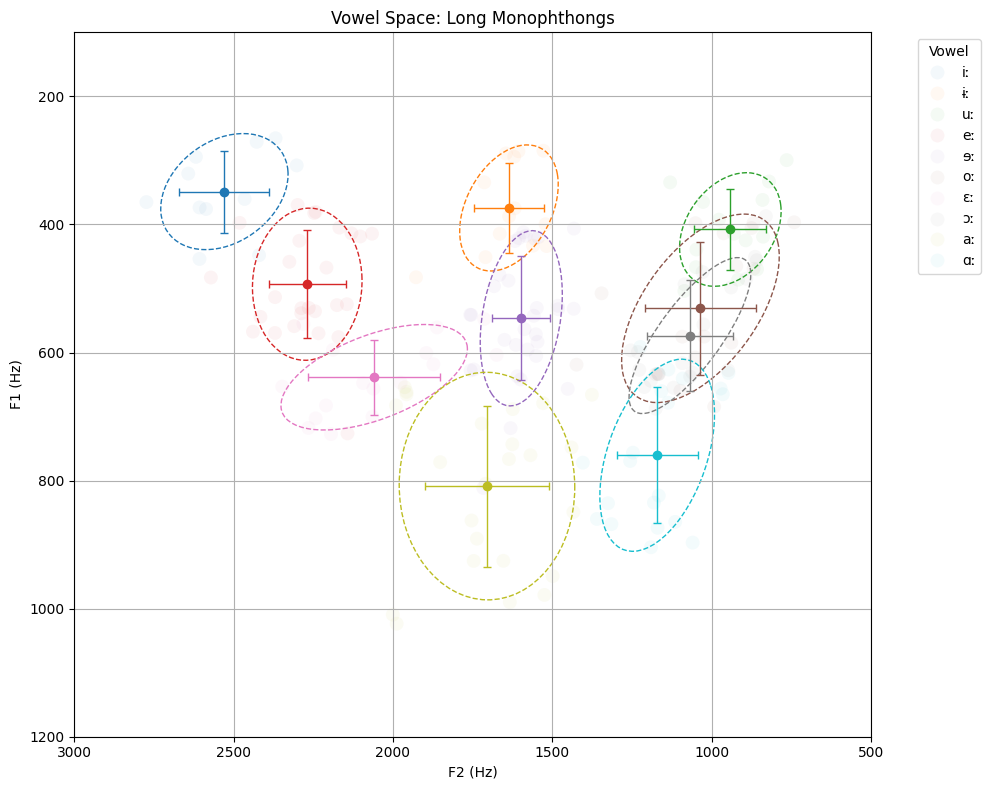

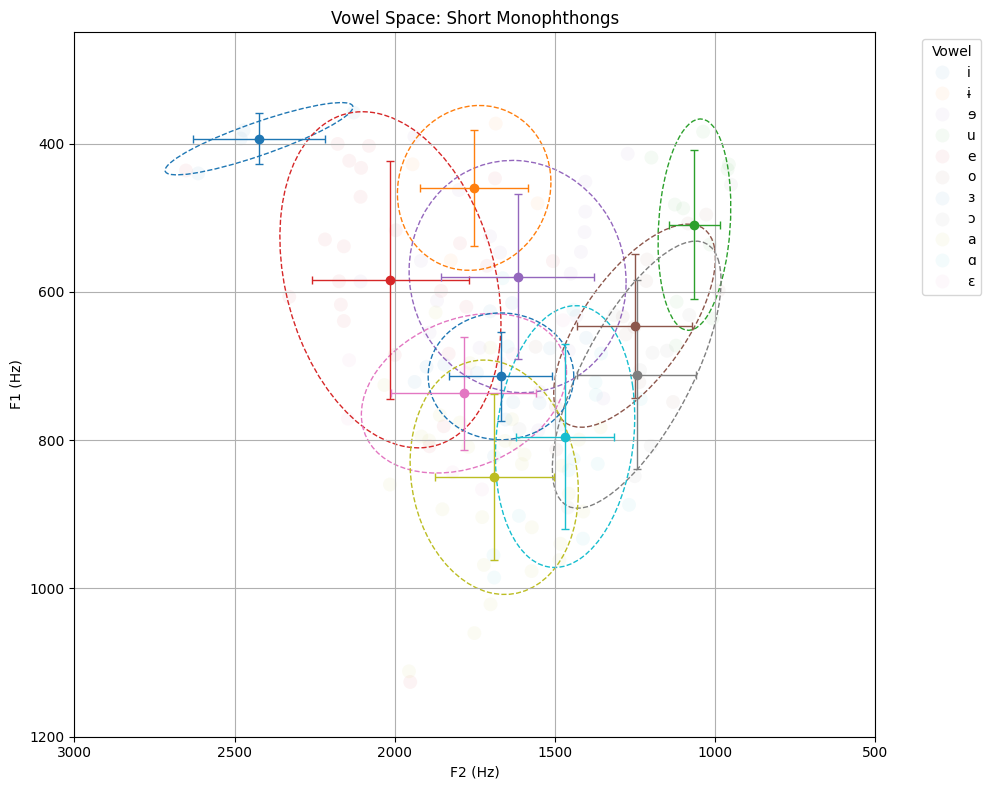

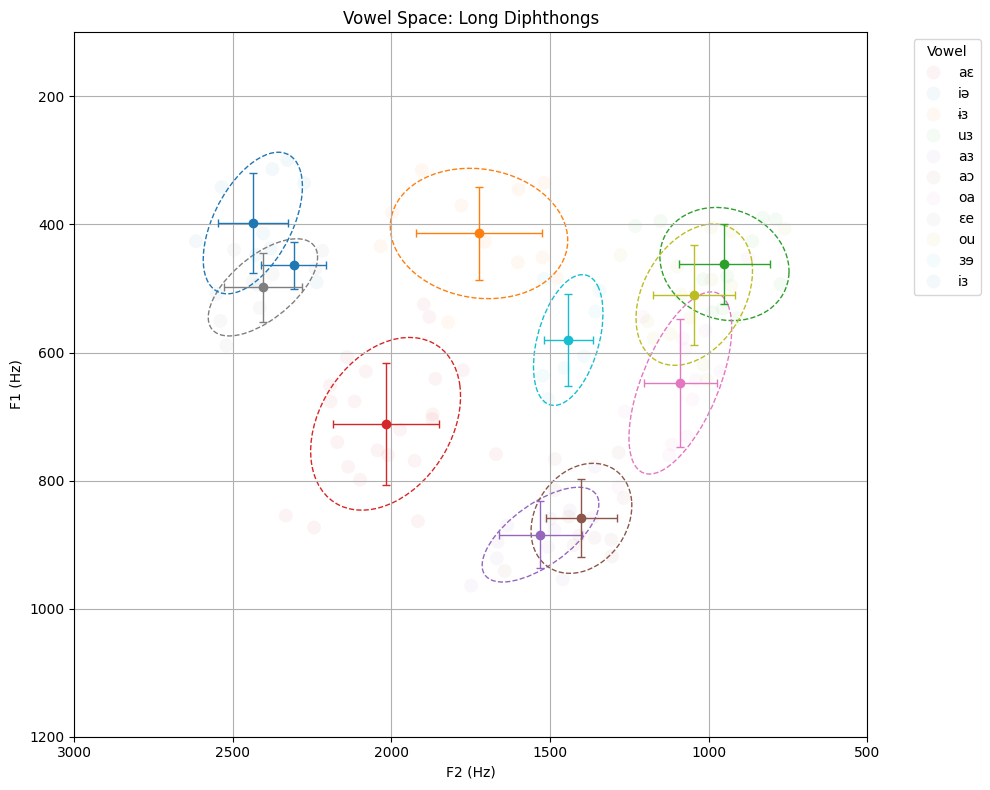

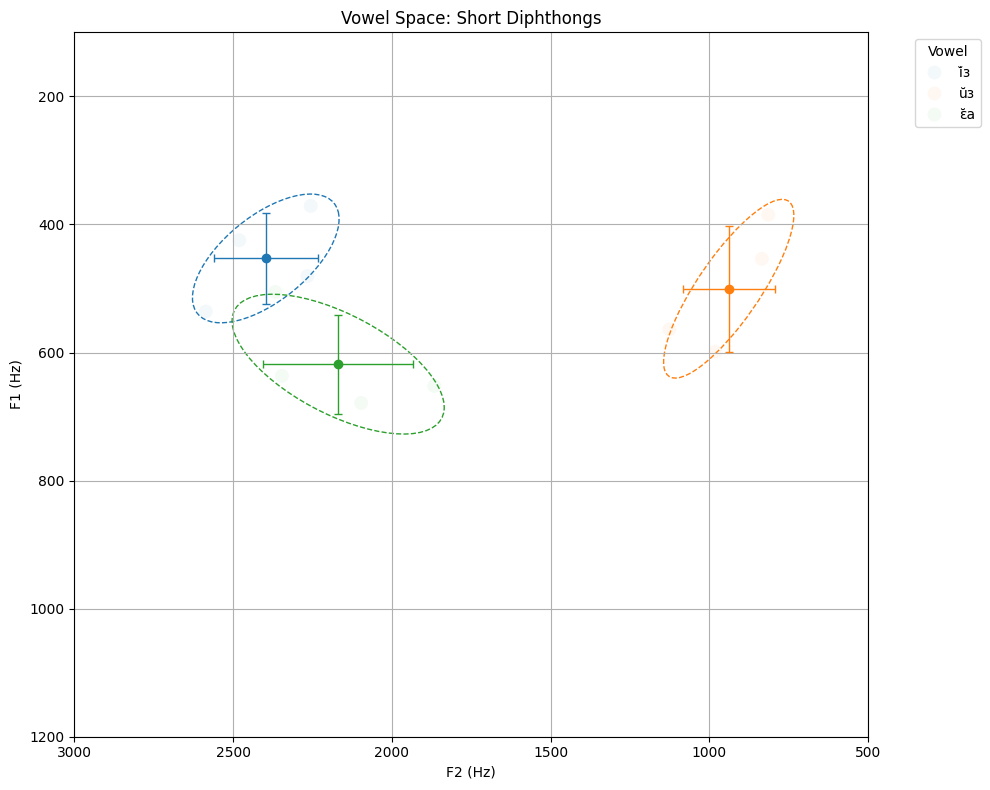

In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Define vowel groups
long_monophthongs = ['iː', 'ɨː', 'uː', 'eː', 'ɘː', 'oː', 'ɛː', 'ɔː', 'aː', 'ɑː']
short_monophthongs = ['i', 'ɨ', 'u', 'e', 'ɘ', 'o', 'ɛ', 'ɔ', 'a', 'ɑ', 'ɜ']
long_diphthongs = ['iɜ', 'ɨɜ', 'uɜ', 'aɛ', 'aɜ', 'aɔ', 'oa', 'ɛe', 'ou', 'ɜɘ', 'iə']
short_diphthongs = ['ĭɜ', 'ŭɜ', 'ɛ̆a']

# Function to plot vowel space using Seaborn with ellipses and error bars
def plot_vowel_space(vowel_group, title, xlim=None, ylim=None):
    filtered_df = df[df['vowel'].isin(vowel_group)]

    # Set up a larger color palette
    palette = sns.color_palette('tab10', n_colors=len(vowel_group))
    color_map = dict(zip(vowel_group, palette))

    plt.figure(figsize=(10, 8))

    # Plot the points using Seaborn, but make them invisible
    sns.scatterplot(data=filtered_df, x='f2', y='f1', hue='vowel', palette=color_map, s=100, edgecolor='w', alpha=0.05)

    # Calculate and plot ellipses with error bars
    for vowel in vowel_group:
        vowel_df = filtered_df[filtered_df['vowel'] == vowel]

        if len(vowel_df) > 1:  # Ensure there's enough data to calculate an ellipse and error bars
            if vowel_df[['f2', 'f1']].isna().any().any():
                continue

            # Mean and standard deviation for error bars
            mean = vowel_df[['f2', 'f1']].mean().values
            std_dev = vowel_df[['f2', 'f1']].std().values  # Standard deviation for error bars

            # Plot the error bars
            plt.errorbar(mean[0], mean[1], xerr=std_dev[0], yerr=std_dev[1], fmt='o', color=color_map[vowel],
                         ecolor=color_map[vowel], elinewidth=1, capsize=3, label=None)

            # Covariance and ellipse calculation
            cov = np.cov(vowel_df[['f2', 'f1']].values.T)

            try:
                if np.linalg.matrix_rank(cov) < 2:
                    continue

                v, w = np.linalg.eigh(cov)
                v = 2.0 * np.sqrt(2.0) * np.sqrt(v)  # Scaling factor for the ellipse

                if any(dim <= 0 for dim in v):
                    continue

                u = w[:, 0] / np.linalg.norm(w[:, 0])
                angle = np.arctan2(u[1], u[0])

                ellipse = patches.Ellipse(
                    mean,
                    v[0],
                    v[1],
                    angle=np.degrees(angle),
                    edgecolor=color_map[vowel],
                    facecolor='none',
                    linestyle='--'
                )
                plt.gca().add_patch(ellipse)

                # Add vowel label at the center of the ellipse
                plt.text(mean[0], mean[1], vowel, fontsize=0, ha='center', va='center', color=color_map[vowel], weight='bold')
            except np.linalg.LinAlgError:
                continue

    # Invert x-axis so that smaller values are on the right
    plt.gca().invert_xaxis()
    # Invert y-axis so that smaller values are on the top
    plt.gca().invert_yaxis()

    # Set the scale for x and y axes
    if xlim is not None:
        plt.xlim(xlim)
    if ylim is not None:
        plt.ylim(ylim)

    plt.title(title)
    plt.xlabel('F2 (Hz)')
    plt.ylabel('F1 (Hz)')
    plt.legend(title='Vowel', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Define specific scales for each plot
long_monophthongs_xlim = (3000, 500)
long_monophthongs_ylim = (1200, 100)

short_monophthongs_xlim = (3000, 500)
short_monophthongs_ylim = (1200, 250)

long_diphthongs_xlim = (3000, 500)
long_diphthongs_ylim = (1200, 100)

short_diphthongs_xlim = (3000, 500)
short_diphthongs_ylim = (1200, 100)

# Plot for each vowel group with specific scales
plot_vowel_space(long_monophthongs, 'Vowel Space: Long Monophthongs', xlim=long_monophthongs_xlim, ylim=long_monophthongs_ylim)
plot_vowel_space(short_monophthongs, 'Vowel Space: Short Monophthongs', xlim=short_monophthongs_xlim, ylim=short_monophthongs_ylim)
plot_vowel_space(long_diphthongs, 'Vowel Space: Long Diphthongs', xlim=long_diphthongs_xlim, ylim=long_diphthongs_ylim)
plot_vowel_space(short_diphthongs, 'Vowel Space: Short Diphthongs', xlim=short_diphthongs_xlim, ylim=short_diphthongs_ylim)


# ***Best vowel space with errorbar plot***

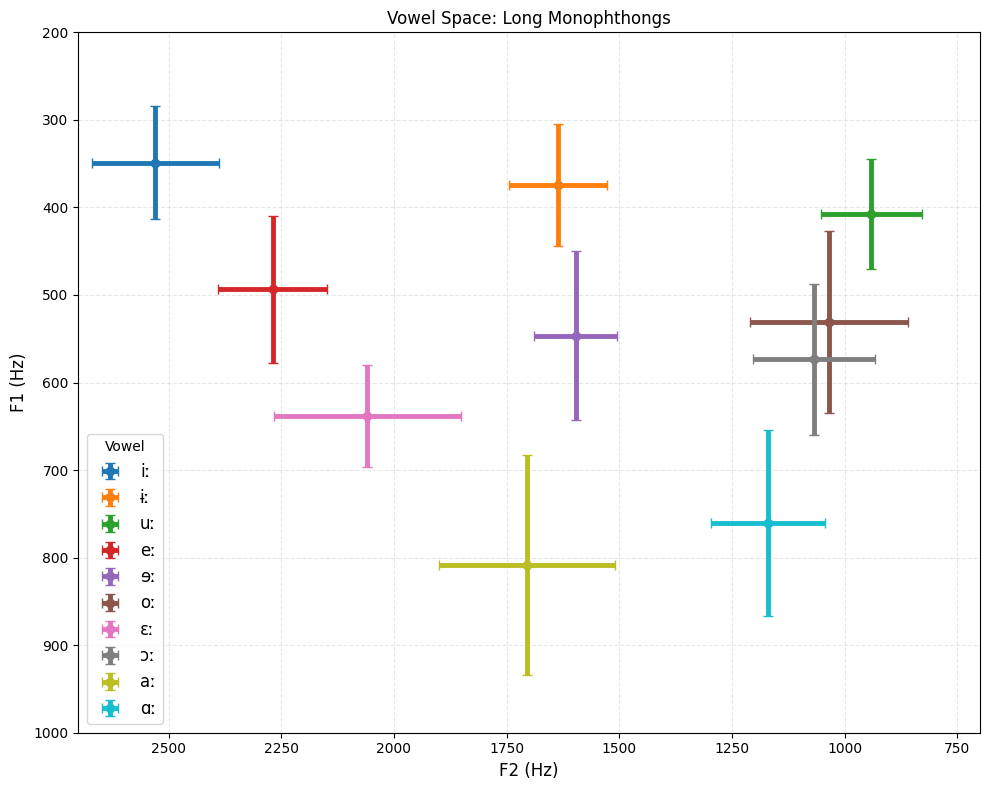

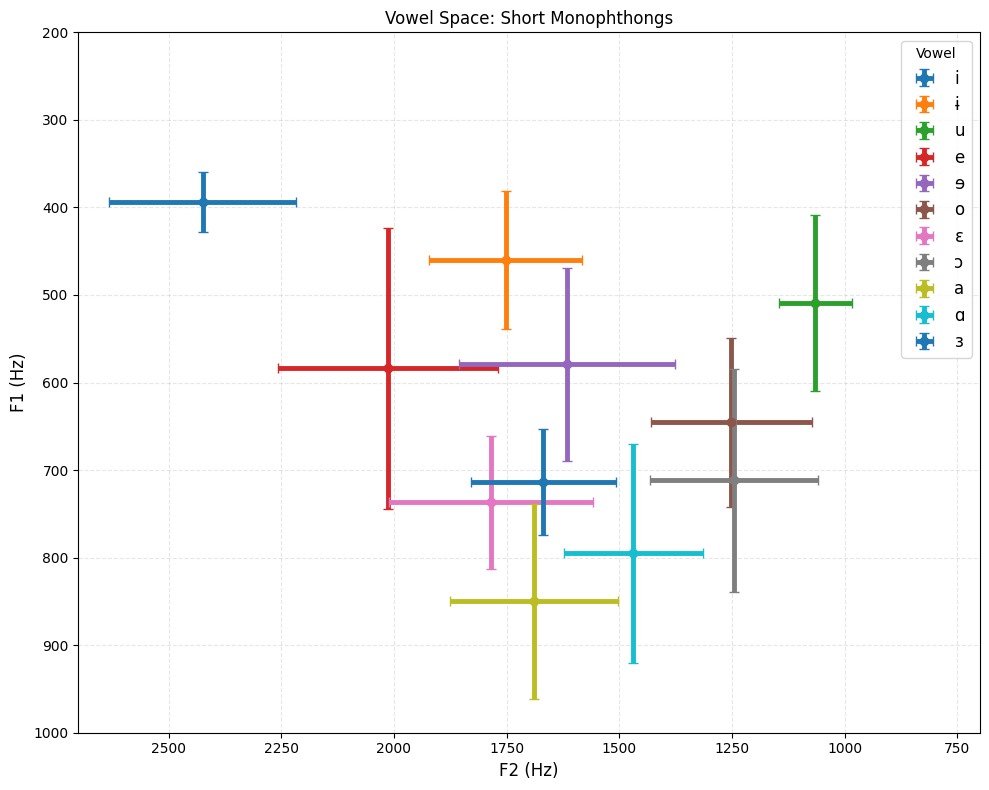

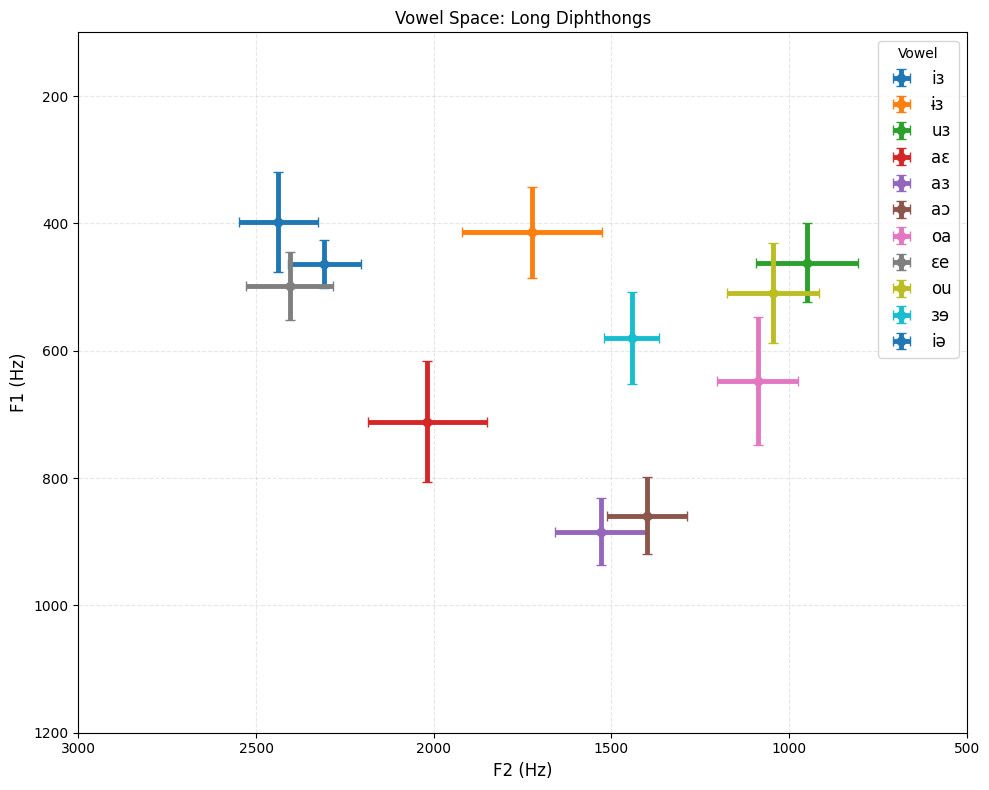

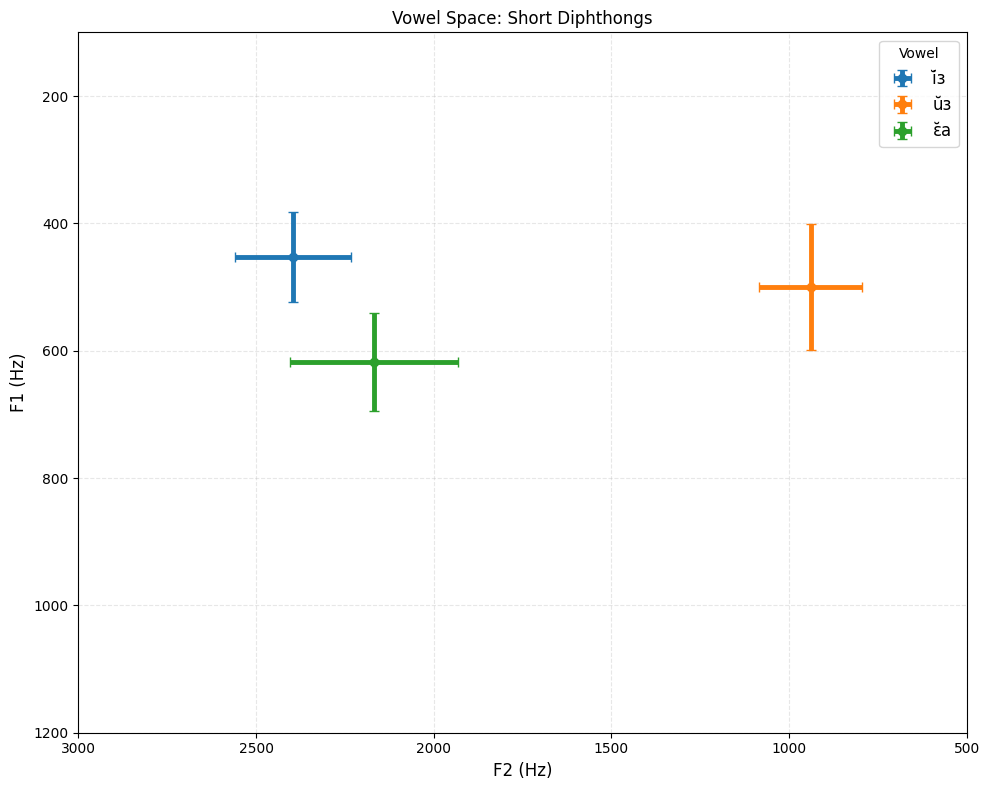

In [ ]:
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Function to plot vowel space using Seaborn with error bars and labels
def plot_vowel_space(vowel_group, title, xlim=None, ylim=None, save_dir="plots"):
    filtered_df = df[df['vowel'].isin(vowel_group)]

    # Create directory if it does not exist
    os.makedirs(save_dir, exist_ok=True)

    # Set up a larger color palette
    palette = sns.color_palette('tab10', n_colors=len(vowel_group))
    color_map = dict(zip(vowel_group, palette))

    plt.figure(figsize=(10, 8))

    # Calculate and plot error bars with vowel labels
    for vowel in vowel_group:
        vowel_df = filtered_df[filtered_df['vowel'] == vowel]

        if len(vowel_df) > 1:  # Ensure there's enough data to calculate error bars
            if vowel_df[['f2', 'f1']].isna().any().any():
                continue

            # Mean and standard deviation for error bars
            mean = vowel_df[['f2', 'f1']].mean().values
            std_dev = vowel_df[['f2', 'f1']].std().values  # Standard deviation for error bars

            # Plot the error bars
            plt.errorbar(mean[0], mean[1], xerr=std_dev[0], yerr=std_dev[1], fmt='o', color=color_map[vowel],
             ecolor=color_map[vowel], elinewidth=3.5, capsize=3.5, label=vowel, #mec='grey', ms=20, mew=4
                         )


            # Add vowel label at the center of the error bars
            #plt.text(mean[0], mean[1], vowel, fontsize=15, ha='center', va='center', color=color_map[vowel], weight='bold')

    # Invert x-axis so that smaller values are on the right
    plt.gca().invert_xaxis()
    # Invert y-axis so that smaller values are on the top
    plt.gca().invert_yaxis()

    # Set the scale for x and y axes
    if xlim is not None:
        plt.xlim(xlim)
    if ylim is not None:
        plt.ylim(ylim)

    plt.title(title)
    plt.xlabel('F2 (Hz)', fontsize=12)
    plt.ylabel('F1 (Hz)', fontsize=12)
    plt.legend(title='Vowel', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.3)
    plt.tight_layout()

    # Save the plot
    plot_path = os.path.join(save_dir, f"{title.replace(':', '').replace(' ', '_')}.png")
    plt.savefig(plot_path, format='png')

    plt.show()

# Define specific scales for each plot
long_monophthongs_xlim = (2700, 700)
long_monophthongs_ylim = (1000, 200)

short_monophthongs_xlim = (2700, 700)
short_monophthongs_ylim = (1000, 200)

long_diphthongs_xlim = (3000, 500)
long_diphthongs_ylim = (1200, 100)

short_diphthongs_xlim = (3000, 500)
short_diphthongs_ylim = (1200, 100)

# Plot for each vowel group with specific scales
plot_vowel_space(long_monophthongs, 'Vowel Space: Long Monophthongs', xlim=long_monophthongs_xlim, ylim=long_monophthongs_ylim)
plot_vowel_space(short_monophthongs, 'Vowel Space: Short Monophthongs', xlim=short_monophthongs_xlim, ylim=short_monophthongs_ylim)
plot_vowel_space(long_diphthongs, 'Vowel Space: Long Diphthongs', xlim=long_diphthongs_xlim, ylim=long_diphthongs_ylim)
plot_vowel_space(short_diphthongs, 'Vowel Space: Short Diphthongs', xlim=short_diphthongs_xlim, ylim=short_diphthongs_ylim)


# MONOPHTHONGS

In [ ]:
import os
import parselmouth
import pandas as pd
import numpy as np
from praatio import tgio

# Define the list of monophthongs (both long and short)
long_monophthongs = ['iː', 'ɨː', 'uː', 'eː', 'ɘː', 'oː', 'ɛː', 'ɔː', 'aː', 'ɑː']
short_monophthongs = ['i', 'ɨ', 'u', 'e', 'ɘ', 'o', 'ɛ', 'ɜ', 'ɔ', 'a', 'ɑ']

# Combine long and short monophthongs into a single list
monophthongs = long_monophthongs + short_monophthongs

# Define the percentiles to extract for F1 and F2
percentiles = [10, 20, 30, 40, 50, 60, 70, 80, 90, 95]

def extract_features(audio_path, textgrid_path, speaker):
    sound = parselmouth.Sound(audio_path)

    # Load the TextGrid using praatio
    tg = tgio.openTextgrid(textgrid_path)

    # Extract the phones tier
    if 'phones' not in tg.tierNameList:
        print(f"No phones tier found in {textgrid_path}")
        return []

    phones_tier = tg.tierDict['phones']

    # Initialize an empty list to collect features
    features = []

    for entry in phones_tier.entryList:
        label = entry.label.strip().lower()

        # If the label is in the list of monophthongs, extract features
        if label in monophthongs:
            start_time, end_time = entry.start, entry.end
            duration = end_time - start_time

            # Extract formants (F1, F2)
            formant = sound.to_formant_burg(
                time_step=0.01,
                max_number_of_formants=5,
                maximum_formant=5500,
                window_length=0.025,
                pre_emphasis_from=30
            )

            # Extract formants at specific temporal percentiles through the vowel duration
            for percentile in percentiles:
                # Calculate the time point at this percentile through the vowel
                t = start_time + (duration * percentile / 100.0)

                # Extract F1 and F2 at this specific time point
                f1 = formant.get_value_at_time(1, t)
                f2 = formant.get_value_at_time(2, t)

                # Only store if both formants are valid
                if f1 is not None and f2 is not None:
                    features.append([
                        os.path.basename(audio_path).replace('.wav', ''),
                        speaker, label, duration,
                        f'f1_{percentile}%', f1
                    ])
                    features.append([
                        os.path.basename(audio_path).replace('.wav', ''),
                        speaker, label, duration,
                        f'f2_{percentile}%', f2
                    ])

    return features

# Define the root directory containing the folders with audio and TextGrid files
root_directory = '/content/drive/MyDrive/PP_vowel/carrier_Phrase/'

# Create an empty DataFrame to store the features
columns = ['file_name', 'speaker', 'vowel', 'duration', 'feature', 'value']
df = pd.DataFrame(columns=columns)

# Iterate through each folder in the root directory
for folder in os.listdir(root_directory):
    folder_path = os.path.join(root_directory, folder)

    if os.path.isdir(folder_path):  # Ensure it's a directory
        # Process each audio file and its corresponding TextGrid file in the folder
        for file in os.listdir(folder_path):
            if file.endswith('.wav'):
                audio_file = os.path.join(folder_path, file)
                textgrid_file = os.path.join(folder_path, file.replace('.wav', '.TextGrid'))

                if os.path.exists(textgrid_file):
                    print(f"Processing {audio_file}...")
                    features = extract_features(audio_file, textgrid_file, speaker=folder)

                    # Add the features to the DataFrame using pd.concat()
                    if features:
                        df = pd.concat([df, pd.DataFrame(features, columns=columns)], ignore_index=True)

# Print the extracted features
print("Extracted Features:")
print(df)

# Save the features to a CSV file
output_csv = '/content/khmer_monophthongs_features.csv'
df.to_csv(output_csv, index=False)
print(f'Features saved to {output_csv}')

Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (57).wav...


/tmp/ipython-input-1989418707.py:98: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, pd.DataFrame(features, columns=columns)], ignore_index=True)


Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (27).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (42).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (29).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (31).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (7).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (14).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (54).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (38).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (13).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (25).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (6).wav...
Processing /content/drive/MyDrive/PP_vowel/carrier_Phrase/vatho/vath0 (17).wav...
Processing /conten

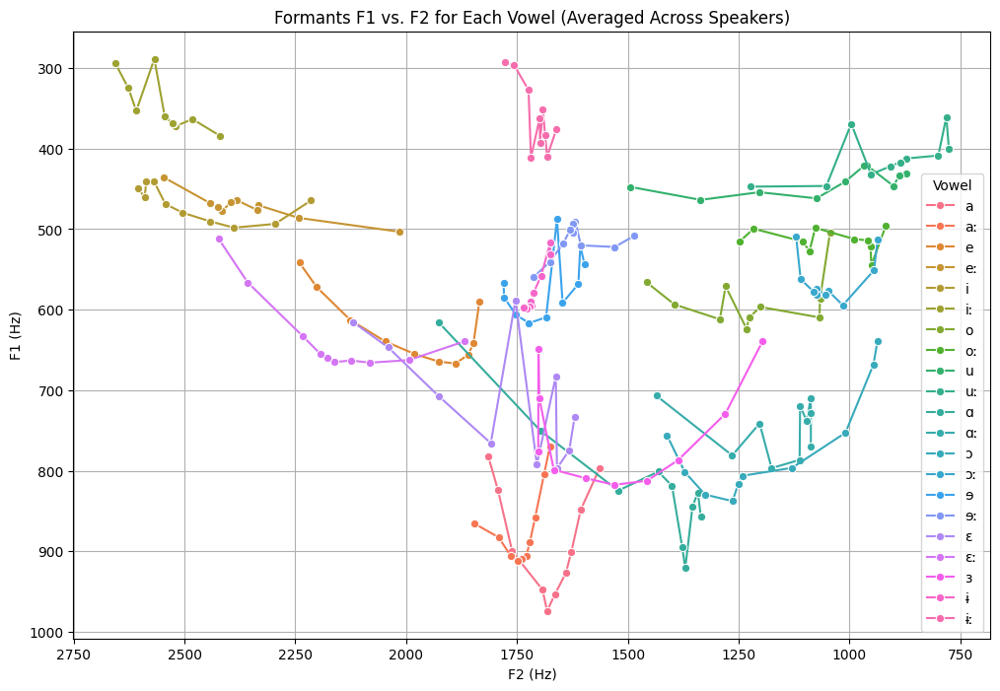

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the features from the CSV file
csv_file = '/content/khmer_monophthongs_features.csv'
df = pd.read_csv(csv_file)

# Ensure the 'feature' column has values like 'f1_10%', 'f2_20%', etc.
df['percentile'] = df['feature'].str.extract(r'(\d+)%').astype(int)
df['formant'] = df['feature'].str.extract(r'(f\d)')

# Reshape the data to have F1 and F2 as separate columns
df_f1 = df[df['formant'] == 'f1'].rename(columns={'value': 'f1'})
df_f2 = df[df['formant'] == 'f2'].rename(columns={'value': 'f2'})

# Merge F1 and F2 data on vowel, file_name, speaker, and percentile
merged_df = pd.merge(df_f1[['file_name', 'speaker', 'vowel', 'percentile', 'f1']],
                     df_f2[['file_name', 'speaker', 'vowel', 'percentile', 'f2']],
                     on=['file_name', 'speaker', 'vowel', 'percentile'])

# Group by vowel and percentile and calculate the mean F1 and F2 across all speakers
mean_df = merged_df.groupby(['vowel', 'percentile'])[['f1', 'f2']].mean().reset_index()

# Plotting F1 vs. F2 for each vowel in a single plot
plt.figure(figsize=(12, 8))
sns.lineplot(data=mean_df, x='f2', y='f1', hue='vowel', marker='o')

# Invert y-axis and x-axis
plt.gca().invert_yaxis()  # Invert y-axis to have smaller values closer to the top
plt.gca().invert_xaxis()  # Invert x-axis to have smaller values closer to the right

plt.title('Formants F1 vs. F2 for Each Vowel (Averaged Across Speakers)')
plt.xlabel('F2 (Hz)')
plt.ylabel('F1 (Hz)')
plt.grid(True)
plt.legend(title='Vowel')
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.patches import FancyArrowPatch
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Load the features from the CSV file
csv_file = '/content/khmer_monophthongs_features.csv'
df = pd.read_csv(csv_file)

# Ensure the 'feature' column has values like 'f1_10%', 'f2_20%', etc.
df['percentile'] = df['feature'].str.extract(r'(\d+)%').astype(int)
df['formant'] = df['feature'].str.extract(r'(f\d)')

# Reshape the data to have F1 and F2 as separate columns
df_f1 = df[df['formant'] == 'f1'].rename(columns={'value': 'f1'})
df_f2 = df[df['formant'] == 'f2'].rename(columns={'value': 'f2'})

# Merge F1 and F2 data on vowel, file_name, speaker, and percentile
merged_df = pd.merge(df_f1[['file_name', 'speaker', 'vowel', 'percentile', 'f1']],
                     df_f2[['file_name', 'speaker', 'vowel', 'percentile', 'f2']],
                     on=['file_name', 'speaker', 'vowel', 'percentile'])

# Group by vowel and percentile and calculate the mean F1 and F2 across all speakers
mean_df = merged_df.groupby(['vowel', 'percentile'])[['f1', 'f2']].mean().reset_index()

# Generate a color palette with enough colors for each vowel
unique_vowels = mean_df['vowel'].unique()
palette = sns.color_palette("tab10", len(unique_vowels))

# Create a mapping from vowel to color
vowel_colors = {vowel: palette[i] for i, vowel in enumerate(unique_vowels)}

# Initialize the plot
fig, ax = plt.subplots(figsize=(12, 8))
ax.invert_yaxis()  # Invert y-axis to have smaller values closer to the top
ax.invert_xaxis()  # Invert x-axis to have smaller values closer to the right
ax.set_title('Formants F1 vs. F2 for Each Vowel (Averaged Across Speakers)')
ax.set_xlabel('F2 (Hz)')
ax.set_ylabel('F1 (Hz)')
ax.grid(True)

# Plot the lines and store the arrow objects
lines = {}
arrows = {}
for vowel in unique_vowels:
    vowel_data = mean_df[mean_df['vowel'] == vowel]
    line, = ax.plot(vowel_data['f2'], vowel_data['f1'], color=vowel_colors[vowel], label=vowel)
    lines[vowel] = line

    # Initialize an arrow at the starting point with a custom style
    start_point = vowel_data.iloc[0]
    arrow = FancyArrowPatch((start_point['f2'], start_point['f1']),
                            (start_point['f2'], start_point['f1']),
                            color=vowel_colors[vowel],
                            arrowstyle='-|>',
                            mutation_scale=30,
                            linewidth=2)

    ax.add_patch(arrow)
    arrows[vowel] = arrow

# Define the animation function
def animate(frame):
    for vowel in unique_vowels:
        vowel_data = mean_df[mean_df['vowel'] == vowel]

        if frame < len(vowel_data) - 1:
            start_point = vowel_data.iloc[frame]
            end_point = vowel_data.iloc[frame + 1]

            # Update the arrow position
            arrow = arrows[vowel]
            arrow.set_positions((start_point['f2'], start_point['f1']),
                                (end_point['f2'], end_point['f1']))

# Create the animation
anim = FuncAnimation(fig, animate, frames=len(mean_df['percentile'].unique()) - 1, interval=500, repeat=True)

# Save the animation with custom arrows
anim.save('/content/formants_animation_with_custom_arrows.gif', writer='imagemagick')

# Optional: Clear the figure to ensure no static plot is displayed
plt.close(fig)

# Display the animation in the notebook
HTML(anim.to_jshtml())


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.patches import FancyArrowPatch
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Load the features from the CSV file
csv_file = '/content/khmer_monophthongs_features.csv'
df = pd.read_csv(csv_file)

# Ensure the 'feature' column has values like 'f1_10%', 'f2_20%', etc.
df['percentile'] = df['feature'].str.extract(r'(\d+)%').astype(int)
df['formant'] = df['feature'].str.extract(r'(f\d)')

# Reshape the data to have F1 and F2 as separate columns
df_f1 = df[df['formant'] == 'f1'].rename(columns={'value': 'f1'})
df_f2 = df[df['formant'] == 'f2'].rename(columns={'value': 'f2'})

# Merge F1 and F2 data on vowel, file_name, speaker, and percentile
merged_df = pd.merge(df_f1[['file_name', 'speaker', 'vowel', 'percentile', 'f1']],
                     df_f2[['file_name', 'speaker', 'vowel', 'percentile', 'f2']],
                     on=['file_name', 'speaker', 'vowel', 'percentile'])

# Group by vowel and percentile and calculate the mean F1 and F2 across all speakers
mean_df = merged_df.groupby(['vowel', 'percentile'])[['f1', 'f2']].mean().reset_index()

# Generate a color palette with enough colors for each vowel
unique_vowels = mean_df['vowel'].unique()
palette = sns.color_palette("tab10", len(unique_vowels))

# Create a mapping from vowel to color
vowel_colors = {vowel: palette[i] for i, vowel in enumerate(unique_vowels)}

# Initialize the plot
fig, ax = plt.subplots(figsize=(12, 8))
ax.invert_yaxis()  # Invert y-axis to have smaller values closer to the top
ax.invert_xaxis()  # Invert x-axis to have smaller values closer to the right
ax.set_title('Formants F1 vs. F2 for Each Vowel (Averaged Across Speakers)')
ax.set_xlabel('F2 (Hz)')
ax.set_ylabel('F1 (Hz)')
ax.grid(True)

# Plot the lines and store the arrow objects
arrows = {}
distances = {}
for vowel in unique_vowels:
    vowel_data = mean_df[mean_df['vowel'] == vowel]

    if vowel_data.empty:
        continue

    line, = ax.plot(vowel_data['f2'], vowel_data['f1'], color=vowel_colors[vowel], label=vowel)

    # Initialize an arrow at the starting point with a custom style
    start_point = vowel_data.iloc[0]
    arrow = FancyArrowPatch((start_point['f2'], start_point['f1']),
                            (start_point['f2'], start_point['f1']),
                            color=vowel_colors[vowel],
                            arrowstyle='-|>',
                            mutation_scale=30,
                            linewidth=2)
    ax.add_patch(arrow)
    arrows[vowel] = arrow

    # Calculate distances between consecutive points
    distances[vowel] = np.sqrt((vowel_data['f2'].diff().fillna(0)**2 + vowel_data['f1'].diff().fillna(0)**2).values)

# Normalize distances and set frame intervals
max_distance = max(np.max(distances[vowel]) for vowel in unique_vowels)
speed_factor = 100  # Base speed factor (adjust as needed)

def get_interval(vowel, frame):
    if frame >= len(distances[vowel]):
        return 100  # Return a default interval if beyond data range
    distance = distances[vowel][frame]
    normalized_distance = distance / max_distance  # Normalize distance
    return int(speed_factor * normalized_distance)  # Adjust interval based on distance

# Add vowel labels at the starting point of each vowel
for vowel in unique_vowels:
    vowel_data = mean_df[mean_df['vowel'] == vowel]
    if not vowel_data.empty:
        start_point = vowel_data.iloc[0]
        ax.text(start_point['f2'], start_point['f1'], vowel, color=vowel_colors[vowel],
                ha='right', va='bottom', fontsize=10, fontweight='bold')

# Define the animation function
def animate(frame):
    for vowel in unique_vowels:
        vowel_data = mean_df[mean_df['vowel'] == vowel]

        if vowel_data.empty or frame >= len(vowel_data) - 1:
            continue

        start_point = vowel_data.iloc[frame]
        end_point = vowel_data.iloc[frame + 1]

        # Update the arrow position
        arrow = arrows.get(vowel)
        if arrow:
            arrow.set_positions((start_point['f2'], start_point['f1']),
                                (end_point['f2'], end_point['f1']))

    # Calculate the interval based on the distance of the current frame
    return get_interval(vowel, frame)

# Create the animation
anim = FuncAnimation(fig, animate, frames=len(mean_df['percentile'].unique()) - 1, repeat=True)

# Save the animation with custom arrows
anim.save('/content/formants_animation_with_custom_arrows.gif', writer='imagemagick')

# Optional: Clear the figure to ensure no static plot is displayed
plt.close(fig)

# Display the animation in the notebook
HTML(anim.to_jshtml())


# DIPHTHONGS

In [ ]:
import os
import parselmouth
import pandas as pd
import numpy as np
from praatio import tgio

# Define the list of diphthongs (both long and short)
diphthongs = [
    'iɜ', 'ɨɜ', 'uɜ', 'aɛ', 'aɜ', 'aɔ', 'oa', 'ɛe', 'ou', 'ɜɘ',
    'ĭɜ', 'ŭɜ', 'ɛ̆a', 'iə',
]

# Define the percentiles to extract for F1 and F2
percentiles = [10, 20, 30, 40, 50, 60, 70, 80, 90, 95]


def extract_features(audio_path, textgrid_path, speaker):
    sound = parselmouth.Sound(audio_path)
    tg = tgio.openTextgrid(textgrid_path)

    if 'phones' not in tg.tierNameList:
        print(f"No phones tier found in {textgrid_path}")
        return []

    phones_tier = tg.tierDict['phones']
    features = []

    for entry in phones_tier.entryList:
        label = entry.label.strip().lower()

        if label in diphthongs:
            start_time, end_time = entry.start, entry.end
            duration = end_time - start_time

            formant = sound.to_formant_burg(
                time_step=0.01,
                max_number_of_formants=5,
                maximum_formant=5500,
                window_length=0.025,
                pre_emphasis_from=30
            )

            # Calculate TIME POINTS at each percentile through the duration
            for percentile in percentiles:
                # Time point at this percentile through the diphthong
                t = start_time + (duration * percentile / 100.0)

                # Extract F1 and F2 at this specific time point
                f1 = formant.get_value_at_time(1, t)
                f2 = formant.get_value_at_time(2, t)

                if f1 is not None and f2 is not None:
                    features.append([
                        os.path.basename(audio_path).replace('.wav', ''),
                        speaker, label, duration,
                        f'f1_{percentile}%', f1
                    ])
                    features.append([
                        os.path.basename(audio_path).replace('.wav', ''),
                        speaker, label, duration,
                        f'f2_{percentile}%', f2
                    ])

    return features

# Define the root directory containing the folders with audio and TextGrid files
root_directory = '/content/drive/MyDrive/PP_vowel/tg_2/all'

# Create an empty DataFrame to store the features
columns = ['file_name', 'speaker', 'vowel', 'duration', 'feature', 'value']
df = pd.DataFrame(columns=columns)

# Iterate through each folder in the root directory
for folder in os.listdir(root_directory):
    folder_path = os.path.join(root_directory, folder)

    if os.path.isdir(folder_path):  # Ensure it's a directory
        # Process each audio file and its corresponding TextGrid file in the folder
        for file in os.listdir(folder_path):
            if file.endswith('.wav'):
                audio_file = os.path.join(folder_path, file)
                textgrid_file = os.path.join(folder_path, file.replace('.wav', '.TextGrid'))

                if os.path.exists(textgrid_file):
                    print(f"Processing {audio_file}...")
                    features = extract_features(audio_file, textgrid_file, speaker=folder)

                    # Add the features to the DataFrame using pd.concat()
                    if features:
                        df = pd.concat([df, pd.DataFrame(features, columns=columns)], ignore_index=True)

# Print the extracted features
print("Extracted Features:")
print(df)

# Save the features to a CSV file
output_csv = '/content/khmer_dipthongs_features.csv'
df.to_csv(output_csv, index=False)
print(f'Features saved to {output_csv}')


Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_1.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_2.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_3.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_4.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_5.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_6.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_7.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_8.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_9.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_10.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_11.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_12.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_13.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_14.wav...
P

/tmp/ipython-input-2967873896.py:90: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, pd.DataFrame(features, columns=columns)], ignore_index=True)


Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_33.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_34.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_35.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_36.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_37.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_38.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_39.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_40.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_41.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_42.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_43.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_44.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_45.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_46

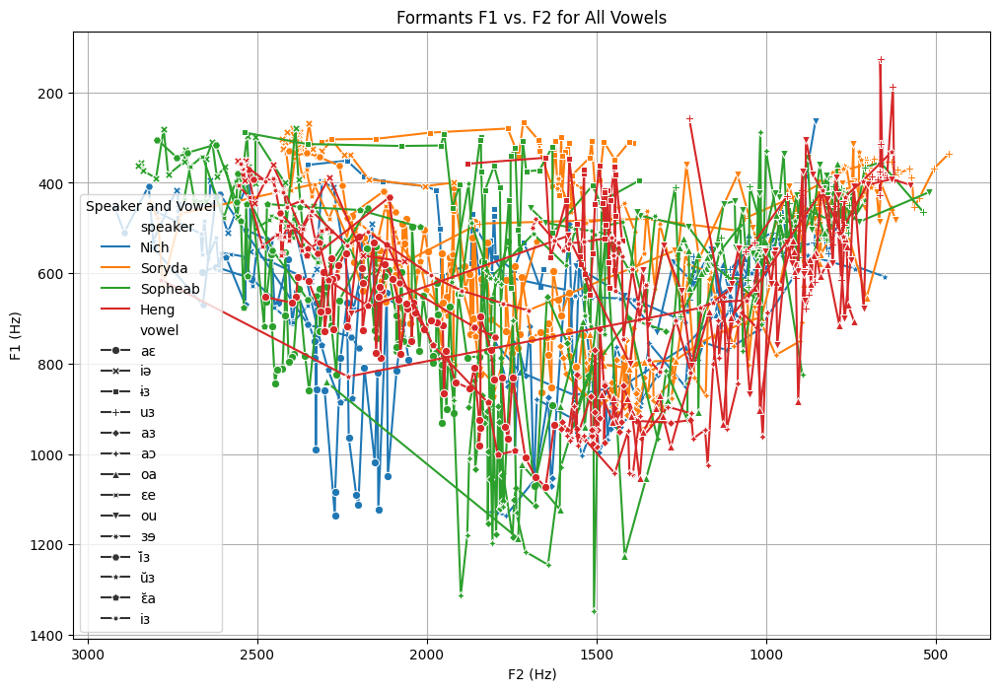

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the features from the CSV file
csv_file = '/content/khmer_dipthongs_features.csv'
df = pd.read_csv(csv_file)

# Ensure the 'feature' column has values like 'f1_10%', 'f2_20%', etc.
df['percentile'] = df['feature'].str.extract(r'(\d+)%').astype(int)
df['formant'] = df['feature'].str.extract(r'(f\d)')

# Reshape the data to have F1 and F2 as separate columns
df_f1 = df[df['formant'] == 'f1'].rename(columns={'value': 'f1'})
df_f2 = df[df['formant'] == 'f2'].rename(columns={'value': 'f2'})

# Merge F1 and F2 data on vowel, file_name, speaker, and percentile
merged_df = pd.merge(df_f1[['file_name', 'speaker', 'vowel', 'percentile', 'f1']],
                     df_f2[['file_name', 'speaker', 'vowel', 'percentile', 'f2']],
                     on=['file_name', 'speaker', 'vowel', 'percentile'])

# Plotting F1 vs. F2 for all vowels, with hue by speaker
plt.figure(figsize=(12, 8))
sns.lineplot(data=merged_df, x='f2', y='f1', hue='speaker', style='vowel', markers=True, dashes=False)


# Invert y-axis and x-axis
plt.gca().invert_yaxis()  # Invert y-axis to have smaller values closer to the top
plt.gca().invert_xaxis()  # Invert x-axis to have smaller values closer to the right

plt.title('Formants F1 vs. F2 for All Vowels')
plt.xlabel('F2 (Hz)')
plt.ylabel('F1 (Hz)')
plt.grid(True)
plt.legend(title='Speaker and Vowel')
plt.show()


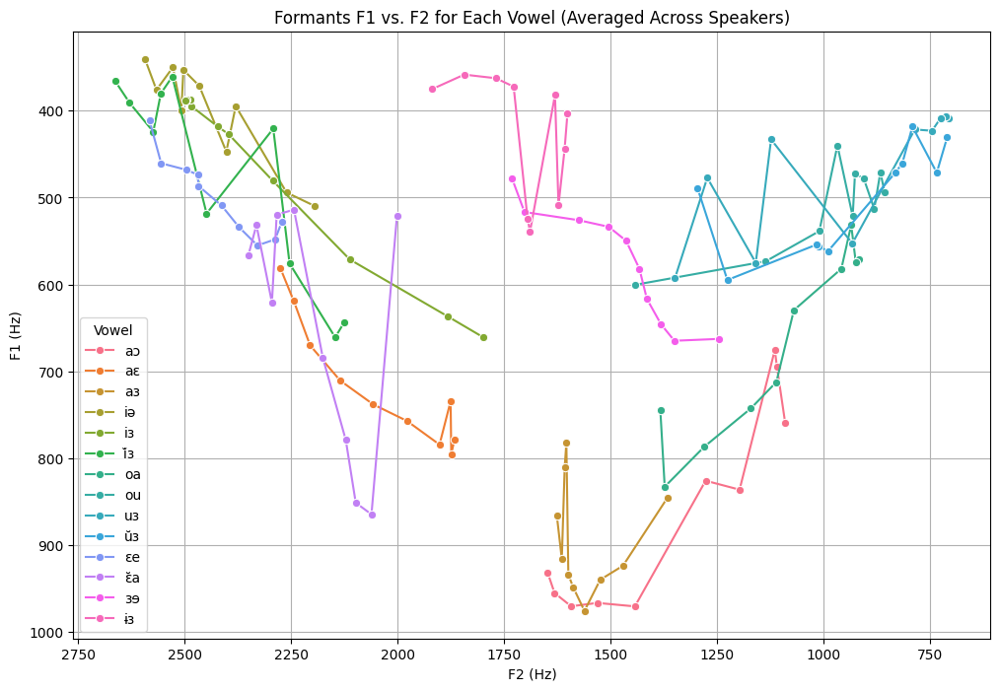

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the features from the CSV file
csv_file = '/content/khmer_dipthongs_features.csv'
df = pd.read_csv(csv_file)

# Ensure the 'feature' column has values like 'f1_10%', 'f2_20%', etc.
df['percentile'] = df['feature'].str.extract(r'(\d+)%').astype(int)
df['formant'] = df['feature'].str.extract(r'(f\d)')

# Reshape the data to have F1 and F2 as separate columns
df_f1 = df[df['formant'] == 'f1'].rename(columns={'value': 'f1'})
df_f2 = df[df['formant'] == 'f2'].rename(columns={'value': 'f2'})

# Merge F1 and F2 data on vowel, file_name, speaker, and percentile
merged_df = pd.merge(df_f1[['file_name', 'speaker', 'vowel', 'percentile', 'f1']],
                     df_f2[['file_name', 'speaker', 'vowel', 'percentile', 'f2']],
                     on=['file_name', 'speaker', 'vowel', 'percentile'])

# Group by vowel and percentile and calculate the mean F1 and F2 across all speakers
mean_df = merged_df.groupby(['vowel', 'percentile'])[['f1', 'f2']].mean().reset_index()

# Plotting F1 vs. F2 for each vowel in a single plot
plt.figure(figsize=(12, 8))
sns.lineplot(data=mean_df, x='f2', y='f1', hue='vowel', marker='o')

# Invert y-axis and x-axis
plt.gca().invert_yaxis()  # Invert y-axis to have smaller values closer to the top
plt.gca().invert_xaxis()  # Invert x-axis to have smaller values closer to the right

plt.title('Formants F1 vs. F2 for Each Vowel (Averaged Across Speakers)')
plt.xlabel('F2 (Hz)')
plt.ylabel('F1 (Hz)')
plt.grid(True)
plt.legend(title='Vowel')
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.patches import FancyArrowPatch
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Load the features from the CSV file
csv_file = '/content/khmer_dipthongs_features.csv'
df = pd.read_csv(csv_file)

# Ensure the 'feature' column has values like 'f1_10%', 'f2_20%', etc.
df['percentile'] = df['feature'].str.extract(r'(\d+)%').astype(int)
df['formant'] = df['feature'].str.extract(r'(f\d)')

# Reshape the data to have F1 and F2 as separate columns
df_f1 = df[df['formant'] == 'f1'].rename(columns={'value': 'f1'})
df_f2 = df[df['formant'] == 'f2'].rename(columns={'value': 'f2'})

# Merge F1 and F2 data on vowel, file_name, speaker, and percentile
merged_df = pd.merge(df_f1[['file_name', 'speaker', 'vowel', 'percentile', 'f1']],
                     df_f2[['file_name', 'speaker', 'vowel', 'percentile', 'f2']],
                     on=['file_name', 'speaker', 'vowel', 'percentile'])

# Group by vowel and percentile and calculate the mean F1 and F2 across all speakers
mean_df = merged_df.groupby(['vowel', 'percentile'])[['f1', 'f2']].mean().reset_index()

# Generate a color palette with enough colors for each vowel
unique_vowels = mean_df['vowel'].unique()
palette = sns.color_palette("tab10", len(unique_vowels))

# Create a mapping from vowel to color
vowel_colors = {vowel: palette[i] for i, vowel in enumerate(unique_vowels)}

# Initialize the plot
fig, ax = plt.subplots(figsize=(12, 8))
ax.invert_yaxis()  # Invert y-axis to have smaller values closer to the top
ax.invert_xaxis()  # Invert x-axis to have smaller values closer to the right
ax.set_title('Formants F1 vs. F2 for Each Vowel (Averaged Across Speakers)')
ax.set_xlabel('F2 (Hz)')
ax.set_ylabel('F1 (Hz)')
ax.grid(True)

# Plot the lines and store the arrow objects
arrows = {}
speed_factors = {}
frames_per_vowel = {}
for vowel in unique_vowels:
    vowel_data = mean_df[mean_df['vowel'] == vowel]

    if vowel_data.empty:
        continue

    line, = ax.plot(vowel_data['f2'], vowel_data['f1'], color=vowel_colors[vowel], label=vowel)

    # Initialize an arrow at the starting point with a custom style
    start_point = vowel_data.iloc[0]
    arrow = FancyArrowPatch((start_point['f2'], start_point['f1']),
                            (start_point['f2'], start_point['f1']),
                            color=vowel_colors[vowel],
                            arrowstyle='-|>',
                            mutation_scale=30,
                            linewidth=2)
    ax.add_patch(arrow)
    arrows[vowel] = arrow

    # Add static vowel labels at the starting point
    ax.text(start_point['f2'], start_point['f1'], vowel,
            color=vowel_colors[vowel],
            fontsize=12,
            ha='right',
            va='center')

    # Calculate distances, slopes, and speed factors
    distances = np.sqrt((vowel_data['f2'].diff().fillna(0)**2 + vowel_data['f1'].diff().fillna(0)**2).values)
    slopes = np.arctan2(vowel_data['f1'].diff().fillna(0), vowel_data['f2'].diff().fillna(0))  # Angle in radians

    # Combine distance and slope to determine speed
    speeds = (1 / (distances[1:] + 1)) * (1 / (np.abs(slopes[1:]) + 1))  # Avoid division by zero
    speeds = np.concatenate(([1], speeds))  # Add a starting speed for the first point

    # Interpolate speeds for smooth transition
    num_frames = len(vowel_data) - 1
    frames_per_vowel[vowel] = np.linspace(0, len(speeds) - 1, num_frames + 1)
    speed_factors[vowel] = np.interp(np.arange(num_frames), frames_per_vowel[vowel], speeds)

# Define the animation function
def animate(frame):
    for vowel in unique_vowels:
        vowel_data = mean_df[mean_df['vowel'] == vowel]

        if vowel_data.empty or frame >= len(vowel_data) - 1:
            continue

        start_point = vowel_data.iloc[frame]
        end_point = vowel_data.iloc[frame + 1]

        # Update the arrow position
        arrow = arrows.get(vowel)
        if arrow:
            arrow.set_positions((start_point['f2'], start_point['f1']),
                                (end_point['f2'], end_point['f1']))

    # Adjust the frame interval based on the speed factor
    interval = int(100 * max(speed_factors[vowel]))  # Base interval of 100 ms
    return interval

# Create the animation
anim = FuncAnimation(fig, animate, frames=len(mean_df['percentile'].unique()) - 1, repeat=True)

# Save the animation with custom arrows
anim.save('/content/formants_animation_with_custom_arrows.gif', writer='imagemagick')

# Optional: Clear the figure to ensure no static plot is displayed
plt.close(fig)

# Display the animation in the notebook
HTML(anim.to_jshtml())


# BY SPEAKERS

In [ ]:
from google.colab import drive
import os
import parselmouth
import pandas as pd
import numpy as np
from praatio import tgio
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.patches import FancyArrowPatch
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Define the list of diphthongs (both long and short)
diphthongs = [
    'iɜ', 'ɨɜ', 'uɜ', 'aɛ', 'aɜ', 'aɔ', 'oa', 'ɛe', 'ou', 'ɜɘ',
    'ĭɜ', 'ŭɜ', 'ɛ̆a', 'iə',
]

def extract_features(audio_path, textgrid_path, speaker):
    sound = parselmouth.Sound(audio_path)

    # Load the TextGrid using praatio
    tg = tgio.openTextgrid(textgrid_path)

    # Check for the presence of the 'phones' and 'words' tiers
    if 'phones' not in tg.tierNameList:
        print(f"No phones tier found in {textgrid_path}")
        return []

    phones_tier = tg.tierDict['phones']
    words_tier = tg.tierDict.get('words', None)  # Optional words tier

    # Initialize an empty list to collect features
    features = []

    for entry in phones_tier.entryList:
        label = entry.label.strip().lower()

        # If the label is in the list of diphthongs, extract features
        if label in diphthongs:
            start_time, end_time = entry.start, entry.end
            duration = end_time - start_time

            # Extract pitch (F0)
            pitch = sound.to_pitch(time_step=0.01)

            # Get the corresponding word from the words tier (if available)
            word = ""
            if words_tier:
                for word_entry in words_tier.entryList:
                    if word_entry.start <= start_time and word_entry.end >= end_time:
                        word = word_entry.label.strip()
                        break

            for t in np.arange(start_time, end_time, 0.01):
                f0 = pitch.get_value_at_time(t)
                if f0 is not None:
                    features.append([
                        os.path.basename(audio_path).replace('.wav', ''),
                        speaker, label, duration,
                        t - start_time,  # Relative time within the diphthong duration
                        f0,  # F0 value at this timestamp
                        word  # Corresponding word
                    ])

    return features

# Define the root directory containing the folders with audio and TextGrid files
root_directory = '/content/drive/MyDrive/PP_vowel/tg_2/all/'

# Create an empty DataFrame to store the features
columns = ['file_name', 'speaker', 'vowel', 'duration', 'relative_time', 'f0', 'word']
df = pd.DataFrame(columns=columns)

# Iterate through each folder in the root directory
for folder in os.listdir(root_directory):
    folder_path = os.path.join(root_directory, folder)

    if os.path.isdir(folder_path):  # Ensure it's a directory
        # Process each audio file and its corresponding TextGrid file in the folder
        for file in os.listdir(folder_path):
            if file.endswith('.wav'):
                audio_file = os.path.join(folder_path, file)
                textgrid_file = os.path.join(folder_path, file.replace('.wav', '.TextGrid'))

                if os.path.exists(textgrid_file):
                    print(f"Processing {audio_file}...")
                    features = extract_features(audio_file, textgrid_file, speaker=folder)

                    # Add the features to the DataFrame using pd.concat()
                    if features:
                        df = pd.concat([df, pd.DataFrame(features, columns=columns)], ignore_index=True)

# Print the extracted features
print("Extracted Features:")
print(df)

# Save the features to a CSV file
output_csv = '/content/khmer_dipthongs_f0_duration_words.csv'
df.to_csv(output_csv, index=False)
print(f'Features saved to {output_csv}')


Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_1.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_2.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_3.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_4.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_5.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_6.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_7.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_8.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_9.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_10.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_11.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_12.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_13.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_14.wav...
P

/tmp/ipython-input-3409431295.py:93: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, pd.DataFrame(features, columns=columns)], ignore_index=True)


Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_31.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_32.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_33.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_34.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_35.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_36.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_37.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_38.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_39.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_40.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_41.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_42.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_43.wav...
Processing /content/drive/MyDrive/PP_vowel/tg_2/all/Nich/nich_44

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 6033 (\N{KHMER LETTER TO}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 6070 (\N{KHMER VOWEL SIGN AA}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 6042 (\N{KHMER LETTER RO}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


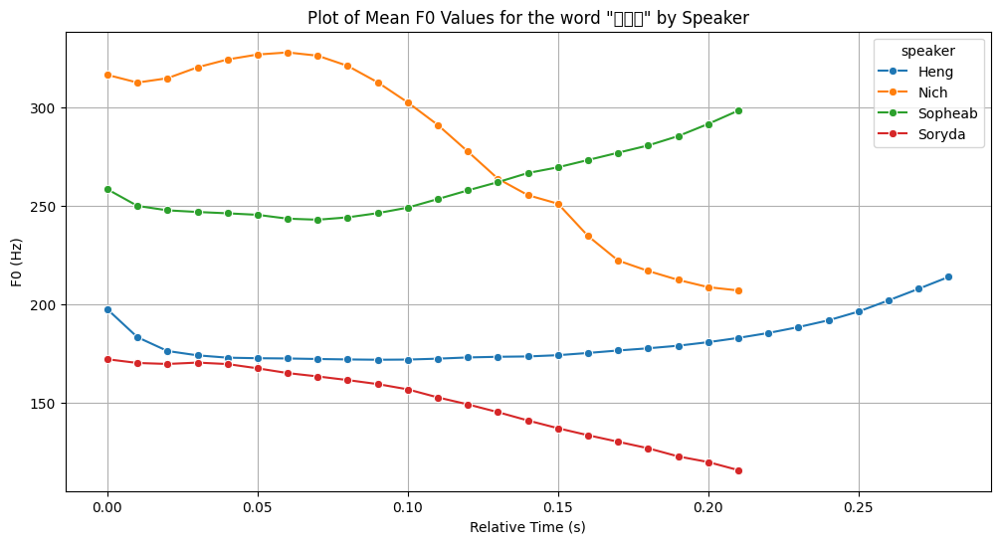

In [ ]:
# prompt: Can you plot f0 for only this word ទារ ​for all speakers?

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the F0 features from the CSV file
csv_file = '/content/khmer_dipthongs_f0_duration_words.csv'  # Update with the correct file path
df_f0 = pd.read_csv(csv_file)

# Filter for the specific word "ទារ"
filtered_df_f0 = df_f0[df_f0['word'] == 'ទារ']

if filtered_df_f0.empty:
    print("No data found for the word 'ទារ'. Please check your data and column name.")
else:
    # Group by speaker and relative time, then calculate the mean F0
    mean_f0_by_speaker = filtered_df_f0.groupby(['speaker', 'relative_time'])['f0'].mean().reset_index()

    # Plotting a line plot for mean F0 values of "ទារ" for each speaker
    plt.figure(figsize=(12, 6))
    sns.lineplot(data=mean_f0_by_speaker, x='relative_time', y='f0', hue='speaker', marker='o')

    plt.title('Plot of Mean F0 Values for the word "ទារ" by Speaker')
    plt.xlabel('Relative Time (s)')
    plt.ylabel('F0 (Hz)')
    plt.grid(True)
    plt.show()

# **Fundamental Frequency - F0**

In [ ]:
!pip install praat-parselmouth
!pip install amfm-decompy
!pip install pyworld
!pip install pysptk
!pip install crepe

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.5/45.5 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.0/261.0 kB 5.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pyworld: filename=pyworld-0.3.5-cp312-cp312-linux_x86_64.whl size=943057 sha256=374ac55bbde1ae121e3d1de677073d81fa72e9cbd9959c7e68098fc0f2ef4372
  Stored in directory: /root/.cache/pip/wheels/be/ac/58/c6a1791ec6d17f3a99b6ccdec92b472f560cb5c564b83dd77e
Successfully built pyworld
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 461.9/461.9 kB 7.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pysptk: filename=pysptk-1.0.1-cp312-cp312-linux_x86_64.whl size=1414073 sha256=1aab7b51ffa4aa86e42647fd3ad643bde20e0204b647715f81297b6acfceb91b
  Stored in directory: /roo

# Parselmouth (PRAAT)

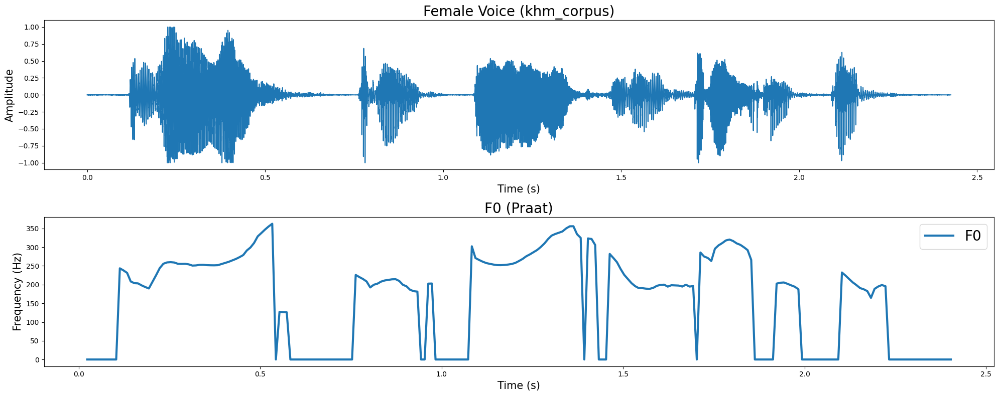

In [ ]:
import parselmouth
import matplotlib.pyplot as plt

# Load the audio file (wav format)
sound = parselmouth.Sound("/content/NSNW-1-01.wav")


# Parameters for F0 extraction
time_step = 0.01           # 10 ms time step (time resolution)
pitch_floor = 75.0         # Minimum pitch (75 Hz)
pitch_ceiling = 600.0      # Maximum pitch (500 Hz)

# Extract pitch (F0) with the given parameters
pitch = sound.to_pitch(
    time_step=time_step,
    pitch_floor=pitch_floor,
    pitch_ceiling=pitch_ceiling
)

# Get the F0 values and corresponding time points
f0_values = pitch.selected_array['frequency']
times = pitch.xs()
# Get the waveform data (audio samples)
waveform = sound.values[0]  # Extract the first channel's samples

# Create the figure with two subplots: one for the waveform and one for the F0 contour
plt.figure(figsize=(20, 8))

# Plot the waveform in the top subplot
plt.subplot(2, 1, 1)  # 2 rows, 1 column, 1st subplot
plt.plot(sound.xs(), waveform)  # sound.xs() gives the time axis of the waveform
plt.title("Female Voice (khm_corpus)",fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Amplitude", fontsize=15)

# Plot the F0 contour in the bottom subplot
plt.subplot(2, 1, 2)  # 2 rows, 1 column, 2nd subplot
plt.plot(times, f0_values, label="F0", alpha=1, linewidth=3)
#plt.ylim(0, 600)  # Limit F0 plot to 0-600 Hz
plt.xlabel("Time (s)",fontsize=15)
plt.ylabel("Frequency (Hz)", fontsize=15)
plt.title("F0 (Praat)", fontsize=20)
plt.legend(fontsize=20, loc='upper right')
# Adjust layout
plt.tight_layout()
plt.savefig("praat_f0_contour.png", dpi=1200, bbox_inches='tight')
# Show the plots
plt.show()

# YAAPT

/usr/local/lib/python3.12/dist-packages/amfm_decompy/basic_tools.py:31: WavFileWarning: Chunk (non-data) not understood, skipping it.
  self.fs, self.data = wavfile.read(name)


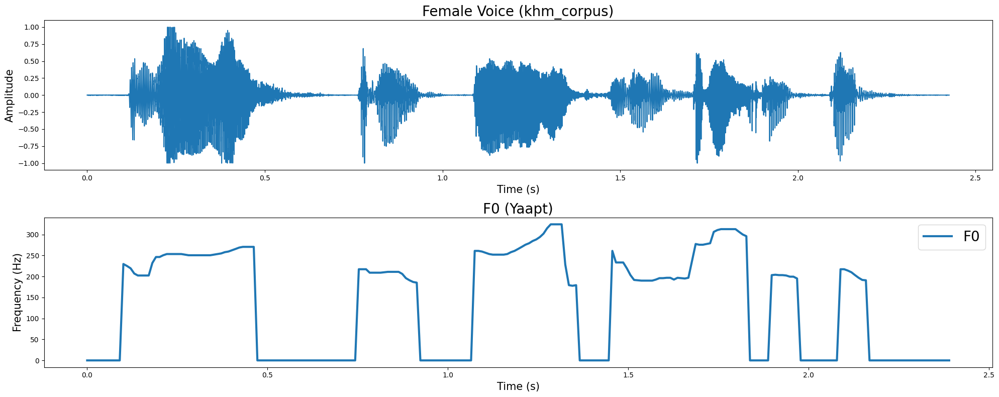

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import amfm_decompy.basic_tools as basic
import amfm_decompy.pYAAPT as pYAAPT

# Path to your audio file
audio_path = "/content/NSNW-1-01.wav"

# Load the audio using amfm_decompy
signal = basic.SignalObj(audio_path)

# Extract the fundamental frequency using YAAPT
pitchY = pYAAPT.yaapt(
    signal,
    frame_length=40,           # Frame length in ms
    tda_frame_length=50,       # Frame length for TDA in ms
    f0_min=75,                 # Minimum F0 frequency
    f0_max=600                 # Maximum F0 frequency
)

# Extract F0 values and time stamps
f0_values = pitchY.samp_values
time = np.linspace(0, len(f0_values) * (signal.fs / 1000), len(f0_values)) / signal.fs * 10

# Plot the results
plt.figure(figsize=(20, 8))

# Plot the waveform
plt.subplot(2, 1, 1)
plt.plot(np.linspace(0, len(signal.data) / signal.fs, len(signal.data)), signal.data)
plt.title("Female Voice (khm_corpus)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Amplitude", fontsize=15)

# Plot the F0
plt.subplot(2, 1, 2)
plt.plot(time, f0_values, label="F0", alpha=1, linewidth=3)
#plt.ylim(0, 600)  # Limit F0 plot to 0-600 Hz
plt.title("F0 (Yaapt)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Frequency (Hz)", fontsize=15)
plt.legend(fontsize=20, loc='upper right')
plt.tight_layout()
plt.savefig("f0_yaapt.png", dpi=1200, bbox_inches='tight')
plt.show()


# PYIN

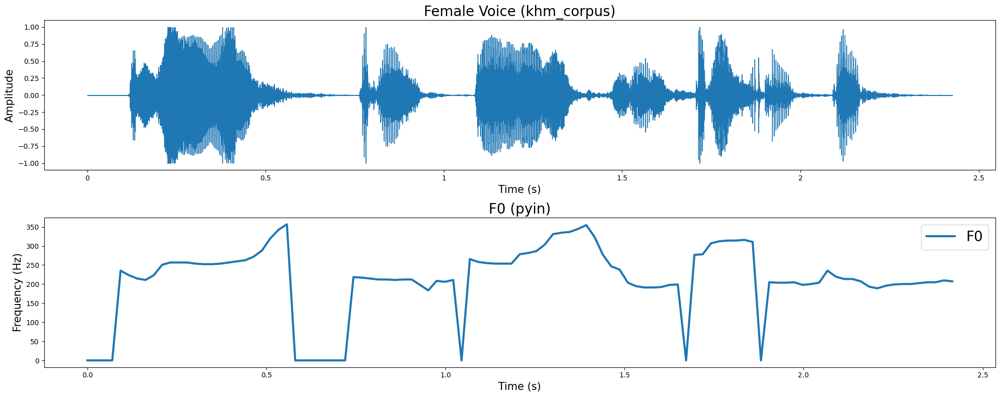

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

# Function to filter F0 values (remove unvoiced parts)
def filter_f0(times, f0, voiced_flag):
    # Replace NaN with 0, and filter out unvoiced regions
    f0_clean = np.nan_to_num(f0, nan=0)
    f0_clean[~voiced_flag] = 0  # Set F0 to 0 where unvoiced
    return times, f0_clean

# Function to extract F0 using pYIN
def extract_f0_pyin(audio_file):
    y, sr = librosa.load(audio_file, sr=None)
    fmin = 21.544  # Minimum frequency to consider
    fmax = librosa.note_to_hz('C7')  # Maximum frequency (C7)
    frame_len_pyin = 4096 # Increased frame length as suggested by warning
    hop_len_pyin = 1024  # Typically frame_length / 4
    f0, voiced_flag, voiced_probs = librosa.pyin(y, fmin=fmin, fmax=fmax, pad_mode='constant', sr=sr, frame_length=frame_len_pyin, hop_length=hop_len_pyin)
    times = librosa.frames_to_time(np.arange(len(f0)), sr=sr, hop_length=hop_len_pyin)
    return filter_f0(times, f0, voiced_flag)

# Path to your audio file
audio_path = "/content/NSNW-1-01.wav"

# Extract F0 and times using the function
times, f0_clean = extract_f0_pyin(audio_path)

# Plot the results
plt.figure(figsize=(20, 8))

# Plot the waveform
y, sr = librosa.load(audio_path, sr=None)
plt.subplot(2, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title("Female Voice (khm_corpus)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Amplitude", fontsize=15)

# Plot the F0
plt.subplot(2, 1, 2)
plt.plot(times, f0_clean, label="F0", alpha=1, linewidth=3)
plt.title("F0 (pyin)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Frequency (Hz)", fontsize=15)
plt.legend(fontsize=20, loc='upper right')

plt.tight_layout()
plt.savefig("f0_pyin.png", dpi=1200, bbox_inches='tight')
plt.show()

# DIO

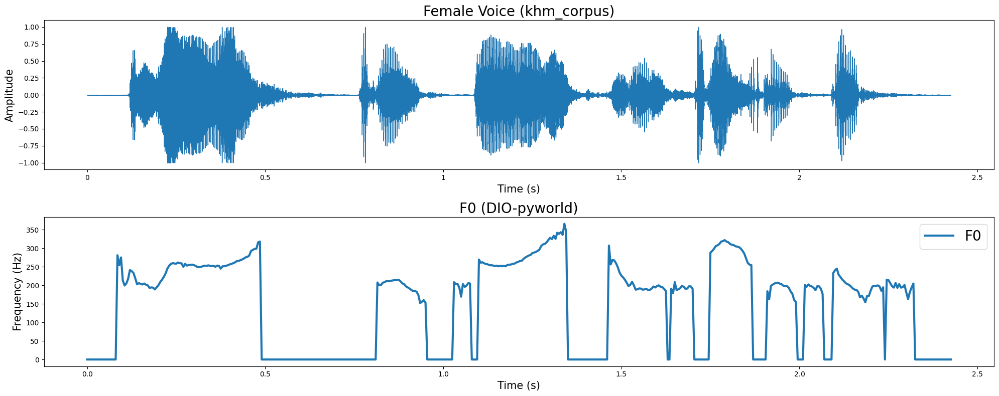

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pyworld as pw
import librosa

# Path to your audio file
audio_path = "/content/NSNW-1-01.wav"

# Load the audio file using librosa
y, sr = librosa.load(audio_path, sr=None)

# Perform the DIO-based F0 extraction using pyworld
f0, t = pw.dio(y.astype(np.float64), fs=sr)

# Extract the F0 values and time stamps
f0_values = pw.stonemask(y.astype(np.float64), f0, t, fs=sr)
time = t  # Time array for F0 values

# Plot the results
plt.figure(figsize=(20, 8))

# Plot the waveform
plt.subplot(2, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title("Female Voice (khm_corpus)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Amplitude", fontsize=15)

# Plot the F0
plt.subplot(2, 1, 2)
plt.plot(time, f0_values, label="F0", alpha=1, linewidth=3)
#plt.ylim(0, 600)  # Limit F0 plot to 0-600 Hz
plt.title("F0 (DIO-pyworld)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Frequency (Hz)", fontsize=15)
plt.legend(fontsize=20, loc='upper right')

plt.tight_layout()
plt.savefig("f0_pyworld.png", dpi=1200, bbox_inches='tight')
plt.show()


# SWIPE

/tmp/ipython-input-3989155224.py:8: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sr, x = wavfile.read(audio_file)


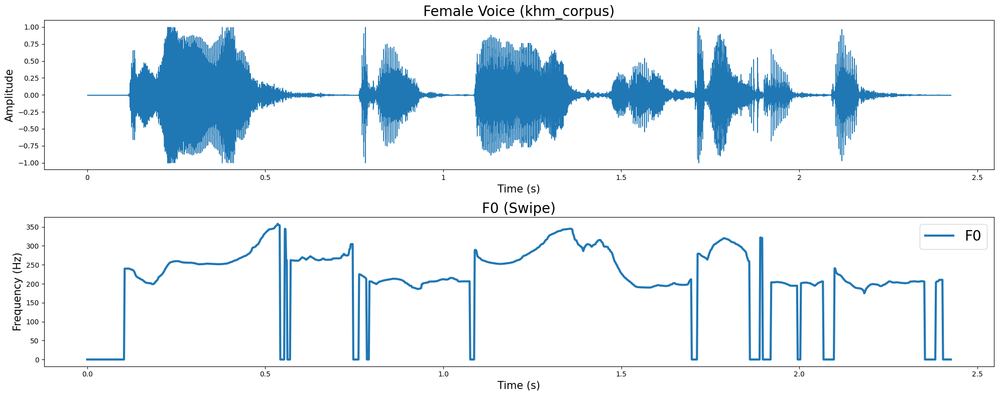

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pysptk
from scipy.io import wavfile
import librosa.display

def extract_f0_swipe(audio_file):
    sr, x = wavfile.read(audio_file)

    # Convert stereo to mono if necessary
    if len(x.shape) > 1:
        x = x.mean(axis=1)

    hop_length = 80
    f0_swipe = pysptk.swipe(
        x.astype(np.float64),
        fs=sr,
        hopsize=hop_length,
        min=75,
        max=600,
        otype="f0"
    )
    time_series = np.arange(len(f0_swipe)) * hop_length / sr
    return time_series, f0_swipe


# Path to your audio file
audio_path = "/content/NSNW-1-01.wav"

# Extract F0 and time using the SWIPE function
times, f0_clean = extract_f0_swipe(audio_path)

# Plot the results
plt.figure(figsize=(20, 8))

# Plot the waveform
y, sr = librosa.load(audio_path, sr=None)
plt.subplot(2, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title("Female Voice (khm_corpus)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Amplitude", fontsize=15)

# Plot the F0
plt.subplot(2, 1, 2)
plt.plot(times, f0_clean, label="F0", alpha=1, linewidth=3)
#plt.ylim(0, 600)  # Limit F0 plot to 0-600 Hz
plt.title("F0 (Swipe)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Frequency (Hz)", fontsize=15)
plt.legend(fontsize=20, loc='upper right')

plt.tight_layout()
plt.savefig("f0_swipe.png", dpi=1200, bbox_inches='tight')
plt.show()


# RAPT

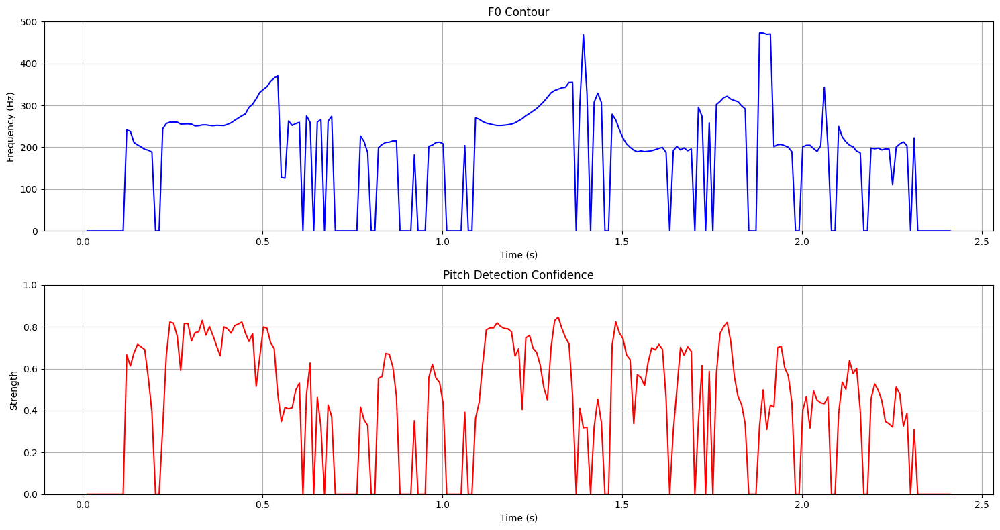


F0 Statistics:
Mean F0: 252.6 Hz
Median F0: 252.1 Hz
Min F0: 110.3 Hz
Max F0: 473.2 Hz
Standard deviation: 62.9 Hz

Voiced frames: 174 (72.2%)


In [ ]:
import numpy as np
from scipy import signal
from typing import Tuple, Optional

class RAPT:
    """
    Implementation of the Robust Algorithm for Pitch Tracking (RAPT)
    Based on Talkin's 1995 paper.
    """
    def __init__(self, sample_rate: int = 16000,
                 min_f0: float = 50,
                 max_f0: float = 600,
                 frame_length_ms: float = 25,
                 frame_shift_ms: float = 10,
                 correlation_threshold: float = 0.3):
        """
        Initialize RAPT pitch tracker.

        Args:
            sample_rate: Sampling rate of the input signal in Hz
            min_f0: Minimum F0 frequency in Hz
            max_f0: Maximum F0 frequency in Hz
            frame_length_ms: Frame length in milliseconds
            frame_shift_ms: Frame shift in milliseconds
            correlation_threshold: Threshold for correlation peaks
        """
        self.sample_rate = sample_rate
        self.min_f0 = min_f0
        self.max_f0 = max_f0

        # Convert ms to samples
        self.frame_length = int(frame_length_ms * sample_rate / 1000)
        self.frame_shift = int(frame_shift_ms * sample_rate / 1000)

        # NCCF parameters
        self.correlation_threshold = correlation_threshold
        self.min_lag = int(sample_rate / max_f0)
        self.max_lag = int(sample_rate / min_f0)

    def nccf(self, frame: np.ndarray, lags: np.ndarray) -> np.ndarray:
        """
        Normalized Cross Correlation Function (NCCF)

        Args:
            frame: Input frame of speech signal
            lags: Array of lags to compute NCCF for

        Returns:
            Array of NCCF values for each lag
        """
        nccf_values = np.zeros_like(lags, dtype=float)
        frame_energy = np.sum(frame ** 2)

        if frame_energy == 0:
            return nccf_values

        for i, lag in enumerate(lags):
            shifted_frame = frame[lag:]
            original_frame = frame[:len(shifted_frame)]

            # Compute correlation
            correlation = np.sum(original_frame * shifted_frame)

            # Compute energy of shifted segment
            shifted_energy = np.sum(shifted_frame ** 2)

            # Normalize correlation
            if shifted_energy > 0:
                nccf_values[i] = correlation / np.sqrt(frame_energy * shifted_energy)

        return nccf_values

    def get_candidates(self, nccf_values: np.ndarray, lags: np.ndarray) -> Tuple[np.ndarray, np.ndarray]:
        """
        Find candidate peaks in NCCF values.

        Args:
            nccf_values: Array of NCCF values
            lags: Array of corresponding lags

        Returns:
            Tuple of (peak_lags, peak_values)
        """
        # Find local maxima
        peak_indices = signal.find_peaks(nccf_values, height=self.correlation_threshold)[0]

        if len(peak_indices) == 0:
            return np.array([]), np.array([])

        peak_values = nccf_values[peak_indices]
        peak_lags = lags[peak_indices]

        # Sort peaks by correlation value
        sort_idx = np.argsort(peak_values)[::-1]
        return peak_lags[sort_idx], peak_values[sort_idx]

    def refine_period(self, frame: np.ndarray, initial_period: int) -> float:
        """
        Refine the period estimate using parabolic interpolation.

        Args:
            frame: Input frame
            initial_period: Initial period estimate in samples

        Returns:
            Refined period estimate
        """
        if initial_period <= 1 or initial_period >= len(frame) - 1:
            return initial_period

        # Compute NCCF values around the initial estimate
        nccf_values = self.nccf(frame, np.array([initial_period-1,
                                                initial_period,
                                                initial_period+1]))

        # Parabolic interpolation
        alpha = nccf_values[0]
        beta = nccf_values[1]
        gamma = nccf_values[2]

        if beta <= alpha or beta <= gamma:
            return initial_period

        refined_period = initial_period + 0.5 * (alpha - gamma) / (alpha - 2*beta + gamma)
        return refined_period

    def process_frame(self, frame: np.ndarray) -> Tuple[Optional[float], float]:
        """
        Process a single frame to estimate F0.

        Args:
            frame: Input frame of speech signal

        Returns:
            Tuple of (F0 frequency in Hz, NCCF strength)
        """
        # Generate lags array
        lags = np.arange(self.min_lag, self.max_lag + 1)

        # Compute NCCF
        nccf_values = self.nccf(frame, lags)

        # Get candidates
        peak_lags, peak_values = self.get_candidates(nccf_values, lags)

        if len(peak_lags) == 0:
            return None, 0.0

        # Get best candidate
        best_lag = peak_lags[0]
        best_value = peak_values[0]

        # Refine period estimate
        refined_period = self.refine_period(frame, int(best_lag))

        # Convert to frequency
        f0 = self.sample_rate / refined_period if refined_period > 0 else None

        # Check if F0 is within valid range
        if f0 is not None and (f0 < self.min_f0 or f0 > self.max_f0):
            return None, best_value

        return f0, best_value

    def process(self, input_signal: np.ndarray) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
        """
        Process entire signal to estimate F0 contour.

        Args:
            input_signal: Input speech signal

        Returns:
            Tuple of (F0 frequencies, NCCF strengths, time points)
        """
        # Pre-emphasis
        pre_emphasized = np.append(input_signal[0], input_signal[1:] - 0.97 * input_signal[:-1])

        # Frame the signal
        num_frames = 1 + (len(input_signal) - self.frame_length) // self.frame_shift
        f0_values = np.zeros(num_frames)
        strengths = np.zeros(num_frames)
        times = np.zeros(num_frames)

        # Create Hanning window once
        window = signal.windows.hann(self.frame_length)

        for i in range(num_frames):
            start = i * self.frame_shift
            end = start + self.frame_length
            frame = pre_emphasized[start:end]

            if len(frame) < self.frame_length:
                # Zero-pad last frame if necessary
                frame = np.pad(frame, (0, self.frame_length - len(frame)))

            # Apply Hanning window
            frame = frame * window

            # Process frame
            f0, strength = self.process_frame(frame)

            f0_values[i] = f0 if f0 is not None else 0.0
            strengths[i] = strength
            times[i] = (start + self.frame_length/2) / self.sample_rate

        return f0_values, strengths, times

# Example usage:
if __name__ == "__main__":
    import soundfile as sf
    import matplotlib.pyplot as plt

    # Read the WAV file
    audio, sample_rate = sf.read('/content/NSNW-1-01.wav')

    # Create RAPT processor with appropriate parameters for speech
    rapt = RAPT(
        sample_rate=sample_rate,
        min_f0=50,      # Typical minimum for human voice
        max_f0=500,     # Typical maximum for human voice
        frame_length_ms=25,
        frame_shift_ms=10,
        correlation_threshold=0.3
    )

    # Process signal
    f0_values, strengths, times = rapt.process(audio)

    # Plot results
    plt.figure(figsize=(15, 8))

    # Plot F0 contour
    plt.subplot(2, 1, 1)
    plt.plot(times, f0_values, 'b-', label='F0')
    plt.grid(True)
    plt.ylabel('Frequency (Hz)')
    plt.xlabel('Time (s)')
    plt.title('F0 Contour')
    plt.ylim(0, 500)  # Adjust if needed

    # Plot strength/confidence
    plt.subplot(2, 1, 2)
    plt.plot(times, strengths, 'r-', label='Confidence')
    plt.grid(True)
    plt.ylabel('Strength')
    plt.xlabel('Time (s)')
    plt.title('Pitch Detection Confidence')
    plt.ylim(0, 1)

    plt.tight_layout()
    plt.show()

    # Print statistics
    valid_f0 = f0_values[f0_values > 0]
    if len(valid_f0) > 0:
        print("\nF0 Statistics:")
        print(f"Mean F0: {np.mean(valid_f0):.1f} Hz")
        print(f"Median F0: {np.median(valid_f0):.1f} Hz")
        print(f"Min F0: {np.min(valid_f0):.1f} Hz")
        print(f"Max F0: {np.max(valid_f0):.1f} Hz")
        print(f"Standard deviation: {np.std(valid_f0):.1f} Hz")
        print(f"\nVoiced frames: {len(valid_f0)} ({len(valid_f0)/len(f0_values)*100:.1f}%)")

# crepe

In [ ]:
!pip install crepe

8/8 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step


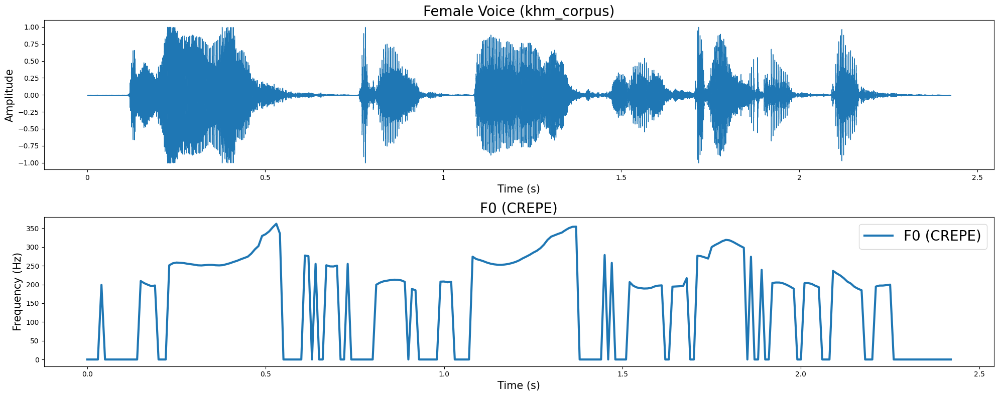

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import crepe

# Function to filter F0 values (replace NaN values)
def filter_f0(times, f0):
    f0_clean = np.nan_to_num(f0, nan=0)  # Replace NaN with 0
    return times, f0_clean

# Function to extract F0 using CREPE
def extract_f0_crepe(audio_file):
    y, sr = librosa.load(audio_file, sr=None)
    # Extract F0 using CREPE
    time_frames, frequency, confidence, activation = crepe.predict(y, sr, viterbi=True, step_size=10)
    # Filter out low-confidence estimates (e.g., confidence < 0.5)
    frequency_clean = np.where(confidence > 0.5, frequency, 0)
    return time_frames, frequency_clean

# Path to your audio file
audio_path = "/content/NSNW-1-01.wav"

# Extract F0 and times using CREPE
times, f0_clean = extract_f0_crepe(audio_path)

# Plot the results
plt.figure(figsize=(20, 8))

# Plot the waveform
y, sr = librosa.load(audio_path, sr=None)
plt.subplot(2, 1, 1)
librosa.display.waveshow(y, sr=sr)
plt.title("Female Voice (khm_corpus)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Amplitude", fontsize=15)

# Plot the F0
plt.subplot(2, 1, 2)
plt.plot(times, f0_clean, label="F0 (CREPE)", alpha=1, linewidth=3)
plt.title("F0 (CREPE)", fontsize=20)
plt.xlabel("Time (s)", fontsize=15)
plt.ylabel("Frequency (Hz)", fontsize=15)
plt.legend(fontsize=20, loc='upper right')

plt.tight_layout()
plt.savefig("f0_crepe.png", dpi=1200, bbox_inches='tight')
plt.show()


# ALL F0

🎵 Simplified F0 Analysis - 8 Methods
📁 Files will be saved with simple names in current directory

🎵 Running Complete F0 Analysis...
📊 This will create:
   - f0_comparison.png (matplotlib)
   - f0_comparison.html (interactive plotly)
   - f0_comparison_plotly.png (static plotly)
   - f0_individual_methods.html (individual methods interactive)
   - f0_individual_methods.png (individual methods static)
📁 All files saved in current directory with simple names

🎵 Running Matplotlib Analysis...


/usr/local/lib/python3.12/dist-packages/amfm_decompy/basic_tools.py:31: WavFileWarning: Chunk (non-data) not understood, skipping it.
  self.fs, self.data = wavfile.read(name)
/tmp/ipython-input-2418276170.py:172: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sr, x = wavfile.read(audio_file)


16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 210ms/step
✅ Saved: f0_comparison.png


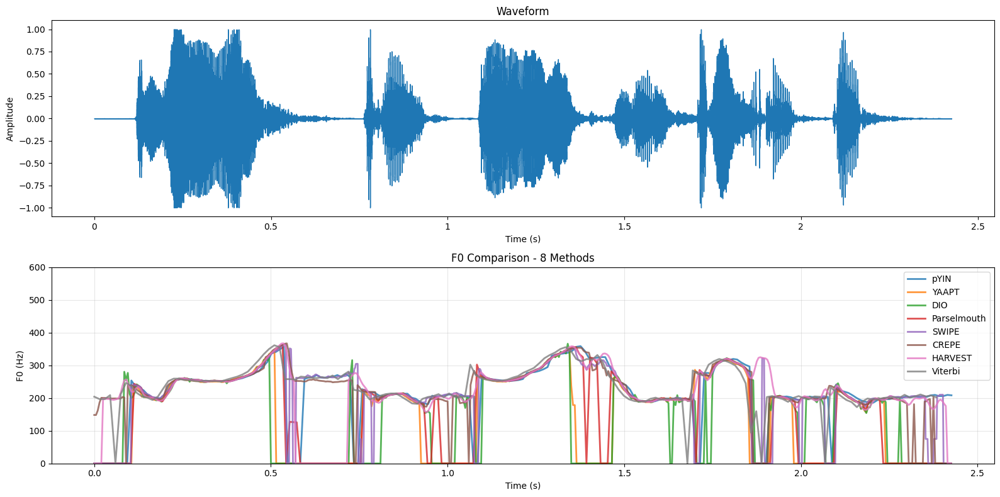

🎵 Running Plotly Analysis...


/usr/local/lib/python3.12/dist-packages/amfm_decompy/basic_tools.py:31: WavFileWarning: Chunk (non-data) not understood, skipping it.
  self.fs, self.data = wavfile.read(name)
/tmp/ipython-input-2418276170.py:172: WavFileWarning: Chunk (non-data) not understood, skipping it.
  sr, x = wavfile.read(audio_file)


16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 243ms/step
✅ Saved: f0_comparison.html
⚠️ Could not save comparison PNG: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido

💡 Try installing: pip install -U kaleido
⚠️ Still failed: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido



🎵 Running Individual Methods Analysis...


/usr/local/lib/python3.12/dist-packages/amfm_decompy/basic_tools.py:31: WavFileWarning:

Chunk (non-data) not understood, skipping it.

/tmp/ipython-input-2418276170.py:172: WavFileWarning:

Chunk (non-data) not understood, skipping it.



16/16 ━━━━━━━━━━━━━━━━━━━━ 5s 325ms/step
✅ Saved: f0_individual_methods.html
⚠️ Could not save individual methods PNG: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido

💡 Try installing: pip install -U kaleido
⚠️ Still failed: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido




✅ All analyses complete!
📁 Total files created: 5 files (1 matplotlib PNG + 2 plotly HTML + 2 plotly PNG)
🔍 Each plotly function creates both HTML (interactive) and PNG (static) versions
🎵 Running Matplotlib Analysis...


/usr/local/lib/python3.12/dist-packages/amfm_decompy/basic_tools.py:31: WavFileWarning:

Chunk (non-data) not understood, skipping it.

/tmp/ipython-input-2418276170.py:172: WavFileWarning:

Chunk (non-data) not understood, skipping it.



16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 233ms/step
✅ Saved: f0_comparison.png


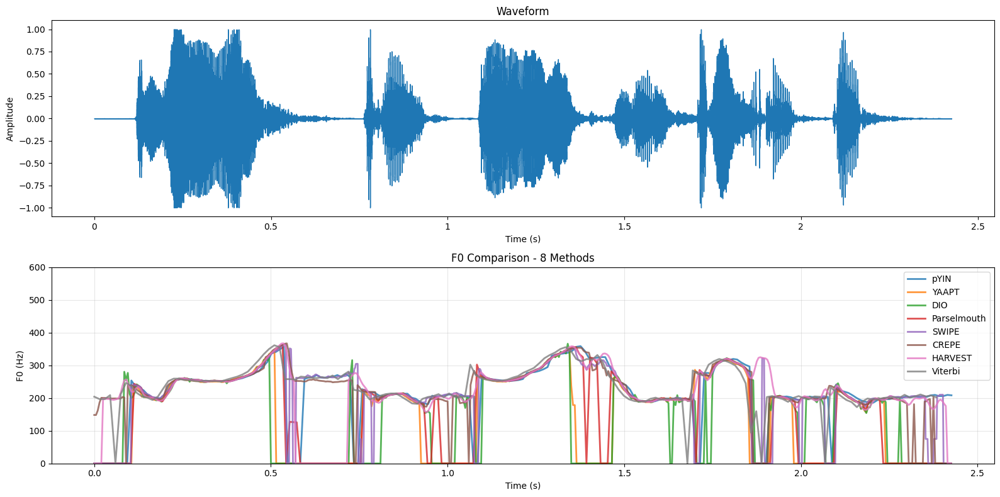

🎵 Running Plotly Analysis...


/usr/local/lib/python3.12/dist-packages/amfm_decompy/basic_tools.py:31: WavFileWarning:

Chunk (non-data) not understood, skipping it.

/tmp/ipython-input-2418276170.py:172: WavFileWarning:

Chunk (non-data) not understood, skipping it.



16/16 ━━━━━━━━━━━━━━━━━━━━ 6s 376ms/step
✅ Saved: f0_comparison.html
⚠️ Could not save comparison PNG: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido

💡 Try installing: pip install -U kaleido
⚠️ Still failed: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido



🎵 Running Individual Methods Analysis...


/usr/local/lib/python3.12/dist-packages/amfm_decompy/basic_tools.py:31: WavFileWarning:

Chunk (non-data) not understood, skipping it.

/tmp/ipython-input-2418276170.py:172: WavFileWarning:

Chunk (non-data) not understood, skipping it.



16/16 ━━━━━━━━━━━━━━━━━━━━ 5s 315ms/step
✅ Saved: f0_individual_methods.html
⚠️ Could not save individual methods PNG: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido

💡 Try installing: pip install -U kaleido
⚠️ Still failed: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido



In [ ]:
# ================================
# SIMPLIFIED F0 EXTRACTION WITH SIMPLE FILE SAVING
# ================================
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import parselmouth
import pyworld as pw
import amfm_decompy.basic_tools as basic
import amfm_decompy.pYAAPT as pYAAPT
import pysptk
from scipy.io import wavfile
import crepe
from scipy import ndimage
from scipy.signal import medfilt, find_peaks, correlate, butter, filtfilt
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import os
from scipy.interpolate import interp1d

# ================================
# SET YOUR AUDIO PATH HERE
# ================================
audio_path = "/content/NSNW-1-01.wav"

# ================================
# VITERBI F0 EXTRACTOR CLASS
# ================================
class ImprovedF0Extractor:
    def __init__(self, min_f0=75, max_f0=600, frame_length=40, hop_length=15):
        self.min_f0 = min_f0
        self.max_f0 = max_f0
        self.frame_length = frame_length
        self.hop_length = hop_length

    def preprocess_audio(self, signal, sample_rate):
        signal = signal / np.max(np.abs(signal))
        nyquist = sample_rate / 2
        low = self.min_f0 / nyquist
        high = 2000 / nyquist
        b, a = butter(4, [low, high], btype='band')
        filtered_signal = filtfilt(b, a, signal)
        return filtered_signal

    def get_candidates(self, frame, sample_rate):
        min_period = int(sample_rate / self.max_f0)
        max_period = int(sample_rate / self.min_f0)

        correlation = correlate(frame, frame, mode='full')
        correlation = correlation[len(correlation)//2:]
        correlation = correlation / np.max(correlation)

        peaks, properties = find_peaks(correlation, height=0.3, distance=min_period)
        valid_peaks = peaks[(peaks >= min_period) & (peaks <= max_period)]

        if len(valid_peaks) == 0:
            return None, None

        candidates = sample_rate / valid_peaks
        confidences = correlation[valid_peaks]
        return candidates, confidences

    def viterbi_smoothing(self, candidates_list, confidences_list):
        if len(candidates_list) == 0:
            return []

        n_frames = len(candidates_list)
        path = []

        def transition_cost(f1, f2):
            if f1 == 0 or f2 == 0:
                return 2.0
            return np.abs(np.log2(f2/f1))

        for i in range(n_frames):
            current_candidates = candidates_list[i]
            current_confidences = confidences_list[i]

            if len(current_candidates) == 0:
                path.append(0)
                continue

            if i == 0:
                best_idx = np.argmax(current_confidences)
                path.append(current_candidates[best_idx])
                continue

            costs = []
            for j, f in enumerate(current_candidates):
                trans_cost = transition_cost(path[-1], f)
                conf_cost = -np.log(current_confidences[j] + 1e-10)
                costs.append(trans_cost + conf_cost)

            best_idx = np.argmin(costs)
            path.append(current_candidates[best_idx])

        return np.array(path)

    def extract_f0_from_signal(self, signal, sample_rate):
        processed_signal = self.preprocess_audio(signal, sample_rate)
        frame_length_samples = int(self.frame_length * sample_rate / 1000)
        hop_length_samples = int(self.hop_length * sample_rate / 1000)

        candidates_list = []
        confidences_list = []
        timestamps = []

        for i in range(0, len(processed_signal) - frame_length_samples, hop_length_samples):
            frame = processed_signal[i:i + frame_length_samples]
            frame = frame * np.hanning(len(frame))

            candidates, confidences = self.get_candidates(frame, sample_rate)
            if candidates is not None:
                candidates_list.append(candidates)
                confidences_list.append(confidences)
            else:
                candidates_list.append(np.array([]))
                confidences_list.append(np.array([]))

            timestamps.append(i / sample_rate)

        f0_contour = self.viterbi_smoothing(candidates_list, confidences_list)
        return np.array(timestamps), f0_contour

# ================================
# F0 EXTRACTION METHODS
# ================================
def extract_f0_viterbi(audio_file):
    f0_extractor = ImprovedF0Extractor(min_f0=75, max_f0=600, frame_length=40, hop_length=15)
    y, sr = librosa.load(audio_file, sr=None)
    timestamps, f0_contour = f0_extractor.extract_f0_from_signal(y, sr)
    return timestamps, f0_contour

def extract_f0_pyin(audio_file):
    y, sr = librosa.load(audio_file, sr=None)
    f0, _, _ = librosa.pyin(y, fmin=75, fmax=600, sr=sr, pad_mode='constant')
    times = np.linspace(0, len(y)/sr, len(f0))
    f0_clean = np.nan_to_num(f0, nan=0.0)
    return times, f0_clean

def extract_f0_yaapt_robust(audio_file):
    signal = basic.SignalObj(audio_file)
    pitchY = pYAAPT.yaapt(signal, frame_length=20, tda_frame_length=20, f0_min=75, f0_max=600,
                          frame_space=5, fft_length=8192, bp_f0=True, bp_fmin=75, bp_fmax=600, spec_smooth_f=5)
    f0_values = pitchY.samp_values
    frame_space_sec = 5.0 / 1000.0
    time = np.arange(len(f0_values)) * frame_space_sec
    return time, f0_values

def extract_f0_dio(audio_file):
    y, sr = librosa.load(audio_file, sr=None)
    f0, t = pw.dio(y.astype(np.float64), fs=sr, f0_floor=75.0, f0_ceil=600.0,
                   channels_in_octave=2.0, frame_period=5.0, speed=1)
    f0_refined = pw.stonemask(y.astype(np.float64), f0, t, fs=sr)
    return t, f0_refined

def extract_f0_harvest(audio_file):
    y, sr = librosa.load(audio_file, sr=None)
    f0, t = pw.harvest(y.astype(np.float64), fs=sr, f0_floor=75.0, f0_ceil=600.0, frame_period=5.0)
    return t, f0

def extract_f0_parselmouth(audio_file):
    y, sr = librosa.load(audio_file, sr=None)
    sound = parselmouth.Sound(y, sampling_frequency=sr)
    pitch = sound.to_pitch()
    f0_values = pitch.selected_array['frequency']
    time = pitch.xs()
    return time, f0_values

def extract_f0_swipe(audio_file):
    sr, x = wavfile.read(audio_file)
    if len(x.shape) > 1:
        x = x.mean(axis=1)
    hop_length = 80
    f0_swipe = pysptk.swipe(x.astype(np.float64), fs=sr, hopsize=hop_length, min=75, max=600, otype="f0")
    time_series = np.arange(len(f0_swipe)) * hop_length / sr
    return time_series, f0_swipe

def extract_f0_crepe(audio_file):
    y, sr = librosa.load(audio_file, sr=16000)
    time, frequency, confidence, activation = crepe.predict(y, sr, model_capacity='small', step_size=5,
                                                            verbose=1, center=True, viterbi=True)
    confidence_threshold = 0.2
    frequency_filtered = np.where(confidence > confidence_threshold, frequency, 0)
    return time, frequency_filtered

# ================================
# SIMPLE PLOTTING FUNCTIONS
# ================================
def plot_f0_matplotlib(audio_path):
    """Create matplotlib plot and save as simple PNG"""
    y, sr = librosa.load(audio_path, sr=None)

    # Extract F0s using all methods
    pyin_time, pyin_f0 = extract_f0_pyin(audio_path)
    yaapt_time, yaapt_f0 = extract_f0_yaapt_robust(audio_path)
    dio_time, dio_f0 = extract_f0_dio(audio_path)
    praat_time, praat_f0 = extract_f0_parselmouth(audio_path)
    swipe_time, swipe_f0 = extract_f0_swipe(audio_path)
    crepe_time, crepe_f0 = extract_f0_crepe(audio_path)
    harvest_time, harvest_f0 = extract_f0_harvest(audio_path)
    viterbi_time, viterbi_f0 = extract_f0_viterbi(audio_path)

    plt.figure(figsize=(16, 8))

    # Waveform
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(y, sr=sr)
    plt.title("Waveform")
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")

    # F0 Comparison
    plt.subplot(2, 1, 2)
    plt.plot(pyin_time, pyin_f0, label='pYIN', alpha=0.8, linewidth=2)
    plt.plot(yaapt_time, yaapt_f0, label='YAAPT', alpha=0.8, linewidth=2)
    plt.plot(dio_time, dio_f0, label='DIO', alpha=0.8, linewidth=2)
    plt.plot(praat_time, praat_f0, label='Parselmouth', alpha=0.8, linewidth=2)
    plt.plot(swipe_time, swipe_f0, label='SWIPE', alpha=0.8, linewidth=2)
    plt.plot(crepe_time, crepe_f0, label='CREPE', alpha=0.8, linewidth=2)
    plt.plot(harvest_time, harvest_f0, label='HARVEST', alpha=0.8, linewidth=2)
    plt.plot(viterbi_time, viterbi_f0, label='Viterbi', alpha=0.8, linewidth=2)

    plt.ylim(0, 600)
    plt.title("F0 Comparison - 8 Methods")
    plt.xlabel("Time (s)")
    plt.ylabel("F0 (Hz)")
    plt.legend(loc='upper right')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

    # Save as simple PNG
    plt.savefig("f0_comparison.png", dpi=300, bbox_inches='tight')
    print("✅ Saved: f0_comparison.png")
    plt.show()

def plot_f0_plotly(audio_path):
    """Create interactive plotly plot and save as HTML and PNG"""
    y, sr = librosa.load(audio_path, sr=None)
    audio_duration = len(y) / sr
    time_waveform = np.linspace(0, audio_duration, len(y))

    # Extract F0s using all methods
    pyin_time, pyin_f0 = extract_f0_pyin(audio_path)
    yaapt_time, yaapt_f0 = extract_f0_yaapt_robust(audio_path)
    dio_time, dio_f0 = extract_f0_dio(audio_path)
    praat_time, praat_f0 = extract_f0_parselmouth(audio_path)
    swipe_time, swipe_f0 = extract_f0_swipe(audio_path)
    crepe_time, crepe_f0 = extract_f0_crepe(audio_path)
    harvest_time, harvest_f0 = extract_f0_harvest(audio_path)
    viterbi_time, viterbi_f0 = extract_f0_viterbi(audio_path)

    # Create interactive plot
    fig = make_subplots(
        rows=2, cols=1,
        subplot_titles=('Audio Waveform', 'F0 Comparison - 8 Methods'),
        vertical_spacing=0.12,
        row_heights=[0.3, 0.7]
    )

    # Add waveform
    fig.add_trace(
        go.Scatter(x=time_waveform, y=y, mode='lines', name='Waveform',
                  line=dict(color='darkblue', width=1)), row=1, col=1)

    # Add F0 traces
    colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#e377c2', '#8c564b', '#17becf']
    methods_data = [
        (pyin_time, pyin_f0, 'pYIN'),
        (yaapt_time, yaapt_f0, 'YAAPT'),
        (dio_time, dio_f0, 'DIO'),
        (praat_time, praat_f0, 'Parselmouth'),
        (swipe_time, swipe_f0, 'SWIPE'),
        (crepe_time, crepe_f0, 'CREPE'),
        (harvest_time, harvest_f0, 'HARVEST'),
        (viterbi_time, viterbi_f0, 'Viterbi')
    ]

    for i, (time_data, f0_data, method_name) in enumerate(methods_data):
        fig.add_trace(
            go.Scatter(x=time_data, y=f0_data, mode='lines', name=method_name,
                      line=dict(color=colors[i], width=2), connectgaps=False), row=2, col=1)

    # Update layout
    fig.update_layout(title='Interactive F0 Analysis - 8 Methods', height=800, hovermode='x unified')
    fig.update_xaxes(title_text="Time (seconds)", row=1, col=1)
    fig.update_xaxes(title_text="Time (seconds)", row=2, col=1)
    fig.update_yaxes(title_text="Amplitude", row=1, col=1)
    fig.update_yaxes(title_text="F0 (Hz)", range=[0, 600], row=2, col=1)

    # Save HTML file
    fig.write_html("f0_comparison.html")
    print("✅ Saved: f0_comparison.html")

    # Save PNG file - ensure it works
    try:
        fig.write_image("f0_comparison_plotly.png", width=1600, height=800, scale=2)
        print("✅ Saved: f0_comparison_plotly.png")
    except Exception as e:
        print(f"⚠️ Could not save comparison PNG: {e}")
        print("💡 Try installing: pip install -U kaleido")
        # Alternative: try without scale parameter
        try:
            fig.write_image("f0_comparison_plotly.png", width=1600, height=800)
            print("✅ Saved: f0_comparison_plotly.png (without scale)")
        except Exception as e2:
            print(f"⚠️ Still failed: {e2}")

    fig.show()
    return fig

def plot_individual_methods(audio_path):
    """Create individual method plots and save as HTML and PNG"""
    # Extract F0s using all methods
    pyin_time, pyin_f0 = extract_f0_pyin(audio_path)
    yaapt_time, yaapt_f0 = extract_f0_yaapt_robust(audio_path)
    dio_time, dio_f0 = extract_f0_dio(audio_path)
    praat_time, praat_f0 = extract_f0_parselmouth(audio_path)
    swipe_time, swipe_f0 = extract_f0_swipe(audio_path)
    crepe_time, crepe_f0 = extract_f0_crepe(audio_path)
    harvest_time, harvest_f0 = extract_f0_harvest(audio_path)
    viterbi_time, viterbi_f0 = extract_f0_viterbi(audio_path)

    methods_data = [
        (pyin_time, pyin_f0, 'pYIN', '#1f77b4'),
        (yaapt_time, yaapt_f0, 'YAAPT', '#ff7f0e'),
        (dio_time, dio_f0, 'DIO', '#2ca02c'),
        (praat_time, praat_f0, 'Parselmouth', '#d62728'),
        (swipe_time, swipe_f0, 'SWIPE', '#9467bd'),
        (crepe_time, crepe_f0, 'CREPE', '#e377c2'),
        (harvest_time, harvest_f0, 'HARVEST', '#8c564b'),
        (viterbi_time, viterbi_f0, 'Viterbi', '#17becf')
    ]

    fig = make_subplots(
        rows=4, cols=2,
        subplot_titles=[method[2] for method in methods_data],
        vertical_spacing=0.08, horizontal_spacing=0.06
    )

    positions = [(1,1), (1,2), (2,1), (2,2), (3,1), (3,2), (4,1), (4,2)]

    for i, ((time_data, f0_data, method_name, color), (row, col)) in enumerate(zip(methods_data, positions)):
        fig.add_trace(
            go.Scatter(x=time_data, y=f0_data, mode='lines', name=method_name,
                      line=dict(color=color, width=2), showlegend=False, connectgaps=False),
            row=row, col=col
        )

    fig.update_layout(title='Individual F0 Methods - 8 Methods', height=1100, hovermode='x unified')

    for row in range(1, 5):
        for col in range(1, 3):
            fig.update_yaxes(range=[0, 600], title_text="F0 (Hz)", row=row, col=col)
            fig.update_xaxes(title_text="Time (s)", row=row, col=col)

    # Save HTML file
    fig.write_html("f0_individual_methods.html")
    print("✅ Saved: f0_individual_methods.html")

    # Save PNG file - ensure it works
    try:
        fig.write_image("f0_individual_methods.png", width=1600, height=1200, scale=2)
        print("✅ Saved: f0_individual_methods.png")
    except Exception as e:
        print(f"⚠️ Could not save individual methods PNG: {e}")
        print("💡 Try installing: pip install -U kaleido")
        # Alternative: try without scale parameter
        try:
            fig.write_image("f0_individual_methods.png", width=1600, height=1200)
            print("✅ Saved: f0_individual_methods.png (without scale)")
        except Exception as e2:
            print(f"⚠️ Still failed: {e2}")

    fig.show()
    return fig

# ================================
# SIMPLE RUN FUNCTIONS
# ================================
def run_matplotlib_analysis(audio_path):
    """Run matplotlib analysis - saves f0_comparison.png"""
    print("🎵 Running Matplotlib Analysis...")
    plot_f0_matplotlib(audio_path)

def run_plotly_analysis(audio_path):
    """Run plotly analysis - saves f0_comparison.html AND f0_comparison_plotly.png"""
    print("🎵 Running Plotly Analysis...")
    return plot_f0_plotly(audio_path)

def run_individual_analysis(audio_path):
    """Run individual methods analysis - saves f0_individual_methods.html AND f0_individual_methods.png"""
    print("🎵 Running Individual Methods Analysis...")
    return plot_individual_methods(audio_path)

def run_all_analysis(audio_path):
    """Run all analyses and save simple files"""
    print("🎵 Running Complete F0 Analysis...")
    print("📊 This will create:")
    print("   - f0_comparison.png (matplotlib)")
    print("   - f0_comparison.html (interactive plotly)")
    print("   - f0_comparison_plotly.png (static plotly)")
    print("   - f0_individual_methods.html (individual methods interactive)")
    print("   - f0_individual_methods.png (individual methods static)")
    print("📁 All files saved in current directory with simple names")
    print()

    run_matplotlib_analysis(audio_path)
    run_plotly_analysis(audio_path)
    run_individual_analysis(audio_path)

    print("\n✅ All analyses complete!")
    print("📁 Total files created: 5 files (1 matplotlib PNG + 2 plotly HTML + 2 plotly PNG)")
    print("🔍 Each plotly function creates both HTML (interactive) and PNG (static) versions")

# ================================
# USAGE
# ================================
if __name__ == "__main__":
    print("🎵 Simplified F0 Analysis - 8 Methods")
    print("📁 Files will be saved with simple names in current directory")
    print()

    # Run all analyses
    run_all_analysis(audio_path)

    # Or run individual analyses:
    run_matplotlib_analysis(audio_path)
    run_plotly_analysis(audio_path)
    run_individual_analysis(audio_path)

F0 by Genders

/tmp/ipython-input-144587375.py:266: UserWarning: Glyph 6036 (\N{KHMER LETTER BA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:266: UserWarning: Glyph 6020 (\N{KHMER LETTER NGO}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:266: UserWarning: Glyph 6098 (\N{KHMER SIGN COENG}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:266: UserWarning: Glyph 6016 (\N{KHMER LETTER KA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:266: UserWarning: Glyph 6078 (\N{KHMER VOWEL SIGN OE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:266: UserWarning: Glyph 6031 (\N{KHMER LETTER TA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:267: UserWarning: Glyph 6036 (\N{KHMER LETTER BA}) missing from font(s) DejaVu Sans.
  plt.savefig("average_f0_by_gender_speech_type.p

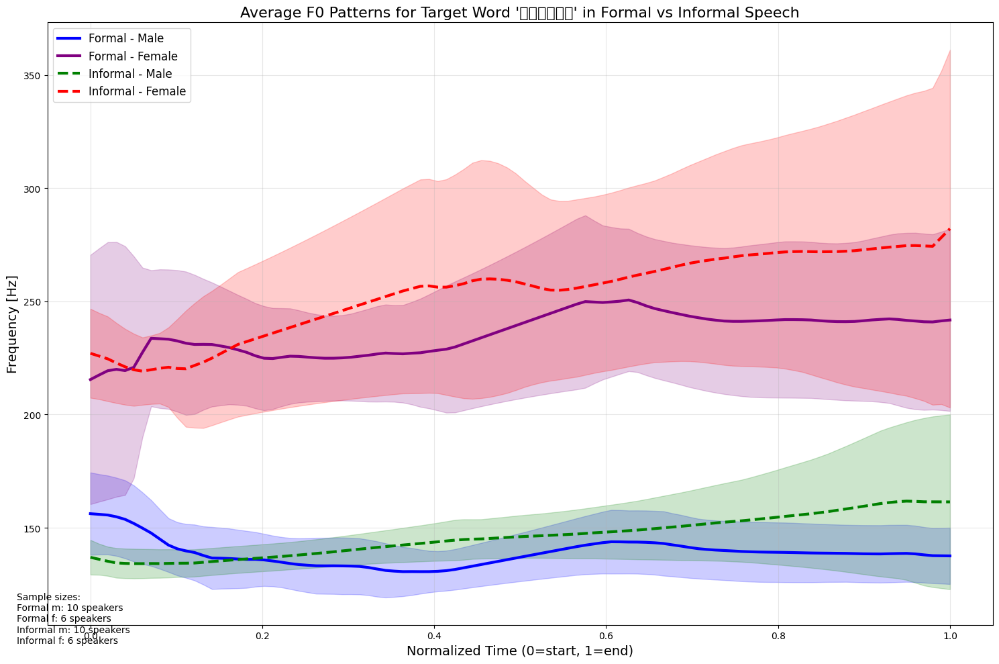

/tmp/ipython-input-144587375.py:321: UserWarning: Glyph 6036 (\N{KHMER LETTER BA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:321: UserWarning: Glyph 6020 (\N{KHMER LETTER NGO}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:321: UserWarning: Glyph 6098 (\N{KHMER SIGN COENG}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:321: UserWarning: Glyph 6016 (\N{KHMER LETTER KA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:321: UserWarning: Glyph 6078 (\N{KHMER VOWEL SIGN OE}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:321: UserWarning: Glyph 6031 (\N{KHMER LETTER TA}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-144587375.py:322: UserWarning: Glyph 6036 (\N{KHMER LETTER BA}) missing from font(s) DejaVu Sans.
  plt.savefig("average_f0_with_individual_traces.

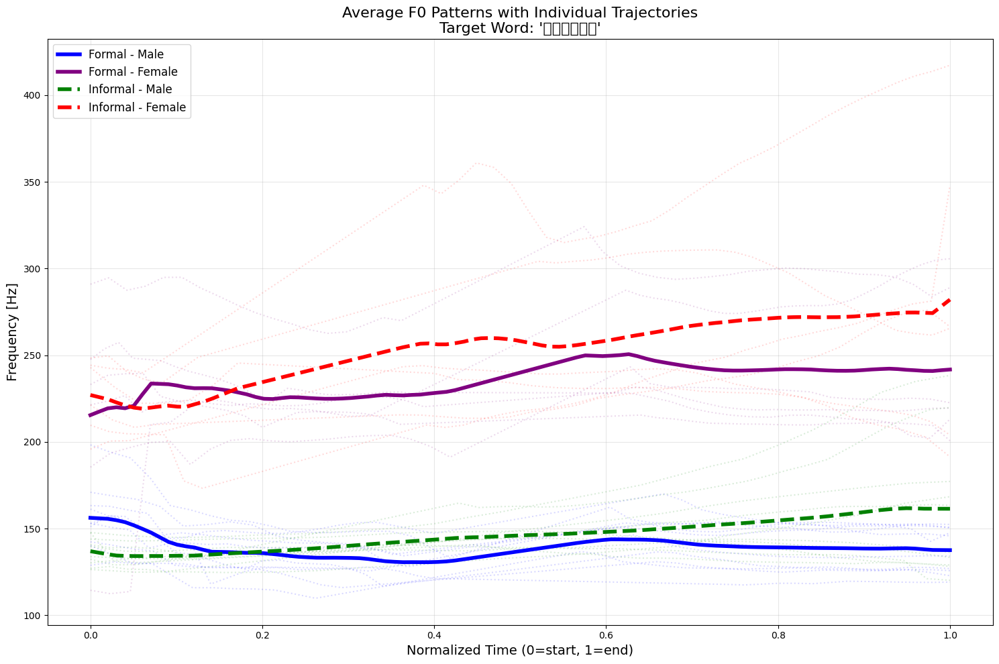

In [ ]:
import os
import parselmouth
import numpy as np
import matplotlib.pyplot as plt
from praatio import tgio

def extract_f0_within_word_boundaries(audio_filename, textgrid_filename, target_word):
    # Load the audio file
    snd = parselmouth.Sound(audio_filename)

    # Extract F0
    pitch = snd.to_pitch()
    f0 = pitch.selected_array['frequency']
    time = pitch.xs()

    # Extract word boundaries for the target word
    word_boundaries = extract_word_boundary(textgrid_filename, target_word)

    # Extract F0 within word boundaries
    f0_within_word_boundaries = []
    time_within_word_boundaries = []
    for start, end in word_boundaries:
        # Filter F0 values within the current word boundary
        f0_within_boundary = f0[(time >= start) & (time <= end)]
        time_within_boundary = time[(time >= start) & (time <= end)]

        # Append F0 and time values within the current word boundary
        f0_within_word_boundaries.extend(f0_within_boundary)
        time_within_word_boundaries.extend(time_within_boundary)

    return time_within_word_boundaries, f0_within_word_boundaries

def extract_word_boundary(textgrid_filename, target_word):
    # Load the TextGrid file
    tg = tgio.openTextgrid(textgrid_filename)

    # Check if 'words' tier exists
    if "words" not in tg.tierNameList:
        print("Error: 'words' tier not found in the TextGrid.")
        return None

    words_tier = tg.tierDict["words"]

    # Extract word boundaries for the target word
    word_boundaries = []
    for start, end, label in words_tier.entryList:
        if label == target_word:
            word_boundaries.append((start, end))

    return word_boundaries

# Directories where your audio and TextGrid files are located
formal_audio_dir = '/content/drive/MyDrive/Stress_IN_Khmer/Audio/Formal phrase'
formal_textgrid_dir = '/content/drive/MyDrive/Stress_IN_Khmer/Formal phrase'

informal_audio_dir = '/content/drive/MyDrive/Stress_IN_Khmer/Audio/Informal speech'
informal_textgrid_dir = '/content/drive/MyDrive/Stress_IN_Khmer/Informal speech'

# Target word to extract boundaries and F0 values
target_word = 'បង្កើត'

# Dictionary to store F0 values based on gender for both formal and informal speech
all_f0_within_word_boundaries = {'formal': {'m': [], 'f': []}, 'informal': {'m': [], 'f': []}}

# Dictionary to store the maximum duration among all audio files for formal and informal speech for each gender
max_duration = {'formal': {'m': 0, 'f': 0}, 'informal': {'m': 0, 'f': 0}}

# Audio gender mapping
audio_gender = {
    'mengheng.wav': 'm',
    'malis.wav': 'f',
    'kompheak.wav': 'm',
    'Dara.wav': 'm',
    'Chivorn.wav': 'm',
    'Chanpenh.wav': 'm',
    'Sreynich.wav': 'f',
    'ReakSmey.wav': 'm',
    'Reaksmey.wav': 'm',
    'Oudom.wav': 'm',
    'YenSocheata.wav': 'f',
    'Va.wav': 'm',
    'sreypov.wav': 'f',
    'Kanha.wav': 'f',
    'Kesor.wav': 'f',
    'Bunleap.wav': 'm'
}

# List all audio files in the formal speech directory
formal_audio_files = os.listdir(formal_audio_dir)

# Iterate over each audio file in the formal speech directory
for audio_file in formal_audio_files:
    # Check if the file is a WAV file
    if audio_file.endswith('.wav'):
        # Full path to the audio file
        audio_path = os.path.join(formal_audio_dir, audio_file)

        # Full path to the corresponding TextGrid file
        textgrid_file = os.path.join(formal_textgrid_dir, audio_file.replace('.wav', '.TextGrid'))

        # Get the gender of the speaker from the audio file name
        speaker_gender = audio_gender.get(audio_file, None)

        if speaker_gender is None:
            print(f"Error: Gender information not found for {audio_file}. Skipping...")
            continue

        # Extract F0 within word boundaries and append to the appropriate gender category for formal speech
        try:
            time_within_word_boundaries, f0_within_word_boundaries = extract_f0_within_word_boundaries(audio_path, textgrid_file, target_word)
            all_f0_within_word_boundaries['formal'][speaker_gender].append((time_within_word_boundaries, f0_within_word_boundaries))

            # Update max_duration for the specific gender if the current audio file duration is longer
            max_duration['formal'][speaker_gender] = max(max_duration['formal'][speaker_gender], max(time_within_word_boundaries))
        except Exception as e:
            print(f"Error processing {audio_file}: {e}")

# List all audio files in the informal speech directory
informal_audio_files = os.listdir(informal_audio_dir)

# Iterate over each audio file in the informal speech directory
for audio_file in informal_audio_files:
    # Check if the file is a WAV file
    if audio_file.endswith('.wav'):
        # Full path to the audio file
        audio_path = os.path.join(informal_audio_dir, audio_file)

        # Full path to the corresponding TextGrid file
        textgrid_file = os.path.join(informal_textgrid_dir, audio_file.replace('.wav', '.TextGrid'))

        # Get the gender of the speaker from the audio file name
        speaker_gender = audio_gender.get(audio_file, None)

        if speaker_gender is None:
            print(f"Error: Gender information not found for {audio_file}. Skipping...")
            continue

        # Extract F0 within word boundaries and append to the appropriate gender category for informal speech
        try:
            time_within_word_boundaries, f0_within_word_boundaries = extract_f0_within_word_boundaries(audio_path, textgrid_file, target_word)
            all_f0_within_word_boundaries['informal'][speaker_gender].append((time_within_word_boundaries, f0_within_word_boundaries))

            # Update max_duration for the specific gender if the current audio file duration is longer
            max_duration['informal'][speaker_gender] = max(max_duration['informal'][speaker_gender], max(time_within_word_boundaries))
        except Exception as e:
            print(f"Error processing {audio_file}: {e}")

# Code to calculate and plot average F0 values by gender and speech style

# Function to calculate average F0 trajectories
def calculate_average_f0(data_list):
    """
    Calculate average F0 trajectory from multiple time-F0 series with potentially different lengths.
    Uses time normalization to handle different durations.
    """
    if not data_list:
        return [], []

    # Create normalized time points (0 to 1) for each trajectory
    normalized_data = []
    for time_values, f0_values in data_list:
        # Filter out zero values which are often measurement errors
        valid_indices = [i for i, f in enumerate(f0_values) if f > 0]
        if not valid_indices:
            continue

        filtered_time = [time_values[i] for i in valid_indices]
        filtered_f0 = [f0_values[i] for i in valid_indices]

        if not filtered_time:
            continue

        # Normalize time to 0-1 range
        t_min = min(filtered_time)
        t_max = max(filtered_time)
        if t_max > t_min:
            norm_time = [(t - t_min) / (t_max - t_min) for t in filtered_time]
            normalized_data.append((norm_time, filtered_f0))

    if not normalized_data:
        return [], []

    # Create 100 evenly spaced time points from 0 to 1
    standard_time = np.linspace(0, 1, 100)

    # Interpolate F0 values for each trajectory to match standard time
    interpolated_f0_series = []
    for norm_time, f0_values in normalized_data:
        if len(norm_time) >= 2:  # Need at least 2 points for interpolation
            try:
                interpolated_f0 = np.interp(standard_time, norm_time, f0_values)
                interpolated_f0_series.append(interpolated_f0)
            except ValueError:
                continue

    # Calculate average F0 and standard deviation at each time point
    if interpolated_f0_series:
        avg_f0 = np.mean(interpolated_f0_series, axis=0)
        std_f0 = np.std(interpolated_f0_series, axis=0)
        return standard_time, avg_f0, std_f0

    return [], [], []

# Calculate average F0 for each gender and speech type
avg_data = {
    'formal': {'m': None, 'f': None},
    'informal': {'m': None, 'f': None}
}

for speech_type in ['formal', 'informal']:
    for gender in ['m', 'f']:
        data = all_f0_within_word_boundaries[speech_type][gender]
        if data:
            time_norm, avg_f0, std_f0 = calculate_average_f0(data)
            if len(time_norm) > 0:
                avg_data[speech_type][gender] = (time_norm, avg_f0, std_f0)

# Plot the average F0 with confidence intervals
plt.figure(figsize=(15, 10))

# Colors and styles for different categories
styles = {
    'formal': {'m': {'color': 'blue', 'linestyle': '-', 'label': 'Formal - Male'},
               'f': {'color': 'purple', 'linestyle': '-', 'label': 'Formal - Female'}},
    'informal': {'m': {'color': 'green', 'linestyle': '--', 'label': 'Informal - Male'},
                 'f': {'color': 'red', 'linestyle': '--', 'label': 'Informal - Female'}}
}

# Plot each average line with confidence interval
for speech_type in ['formal', 'informal']:
    for gender in ['m', 'f']:
        if avg_data[speech_type][gender] is not None:
            time_norm, avg_f0, std_f0 = avg_data[speech_type][gender]
            style = styles[speech_type][gender]

            # Plot the average line
            plt.plot(time_norm, avg_f0,
                     color=style['color'],
                     linestyle=style['linestyle'],
                     linewidth=3,
                     label=style['label'])

            # Plot the confidence interval (±1 standard deviation)
            plt.fill_between(time_norm,
                             avg_f0 - std_f0,
                             avg_f0 + std_f0,
                             color=style['color'],
                             alpha=0.2)

plt.title(f"Average F0 Patterns for Target Word '{target_word}' in Formal vs Informal Speech", fontsize=16)
plt.xlabel("Normalized Time (0=start, 1=end)", fontsize=14)
plt.ylabel("Frequency [Hz]", fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(fontsize=12)

# Add text describing the sample sizes
info_text = f"Sample sizes:\n"
for speech_type in ['formal', 'informal']:
    for gender in ['m', 'f']:
        count = len(all_f0_within_word_boundaries[speech_type][gender])
        info_text += f"{speech_type.capitalize()} {gender}: {count} speakers\n"

plt.figtext(0.02, 0.02, info_text, fontsize=10)

# Save the plot in high resolution
plt.tight_layout()
plt.savefig("average_f0_by_gender_speech_type.png", dpi=500)

plt.show()

# Optional: You can also create a second plot showing individual trajectories
# with the averages highlighted
plt.figure(figsize=(15, 10))

# First plot all individual trajectories with low alpha
for speech_type in ['formal', 'informal']:
    for gender in ['m', 'f']:
        style = styles[speech_type][gender]

        for time_within_word_boundaries, f0_within_word_boundaries in all_f0_within_word_boundaries[speech_type][gender]:
            # Filter out zero values
            valid_indices = [i for i, f in enumerate(f0_within_word_boundaries) if f > 0]
            filtered_time = [time_within_word_boundaries[i] for i in valid_indices]
            filtered_f0 = [f0_within_word_boundaries[i] for i in valid_indices]

            if not filtered_time:
                continue

            # Normalize time to 0-1 range
            t_min = min(filtered_time)
            t_max = max(filtered_time)
            if t_max > t_min:
                norm_time = [(t - t_min) / (t_max - t_min) for t in filtered_time]

                # Plot individual trajectory
                plt.plot(norm_time, filtered_f0,
                         color=style['color'],
                         linestyle=':',
                         alpha=0.15)

# Then plot the averages with high alpha
for speech_type in ['formal', 'informal']:
    for gender in ['m', 'f']:
        if avg_data[speech_type][gender] is not None:
            time_norm, avg_f0, std_f0 = avg_data[speech_type][gender]
            style = styles[speech_type][gender]

            # Plot the average line
            plt.plot(time_norm, avg_f0,
                     color=style['color'],
                     linestyle=style['linestyle'],
                     linewidth=4,
                     label=style['label'])

plt.title(f"Average F0 Patterns with Individual Trajectories\nTarget Word: '{target_word}'", fontsize=16)
plt.xlabel("Normalized Time (0=start, 1=end)", fontsize=14)
plt.ylabel("Frequency [Hz]", fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(fontsize=12)

plt.tight_layout()
plt.savefig("average_f0_with_individual_traces.png", dpi=500)

plt.show()

# Others

Processing speech data with speakers 7 and 9 excluded...
Raw data points: 18445
Aligned data points: 100500
Breathiness measurements: 1019
Number of speakers: 10


/tmp/ipython-input-802957261.py:252: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



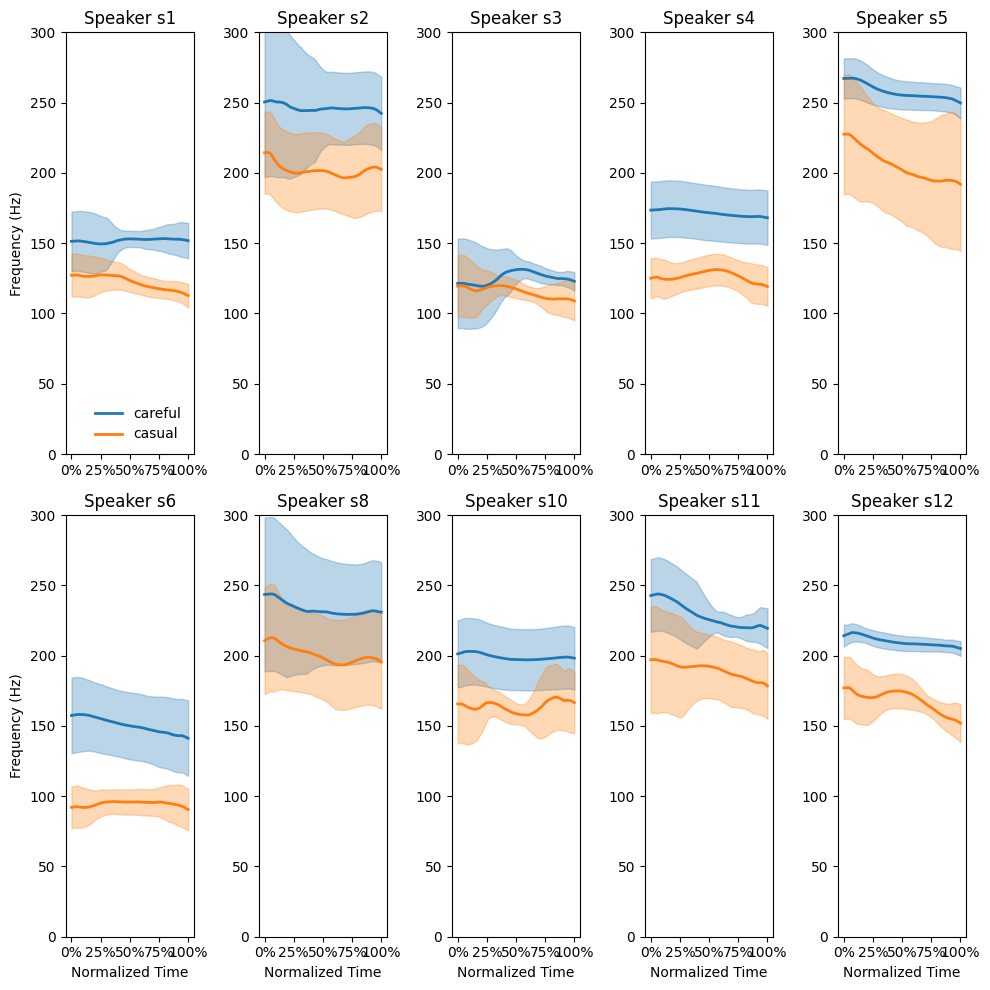

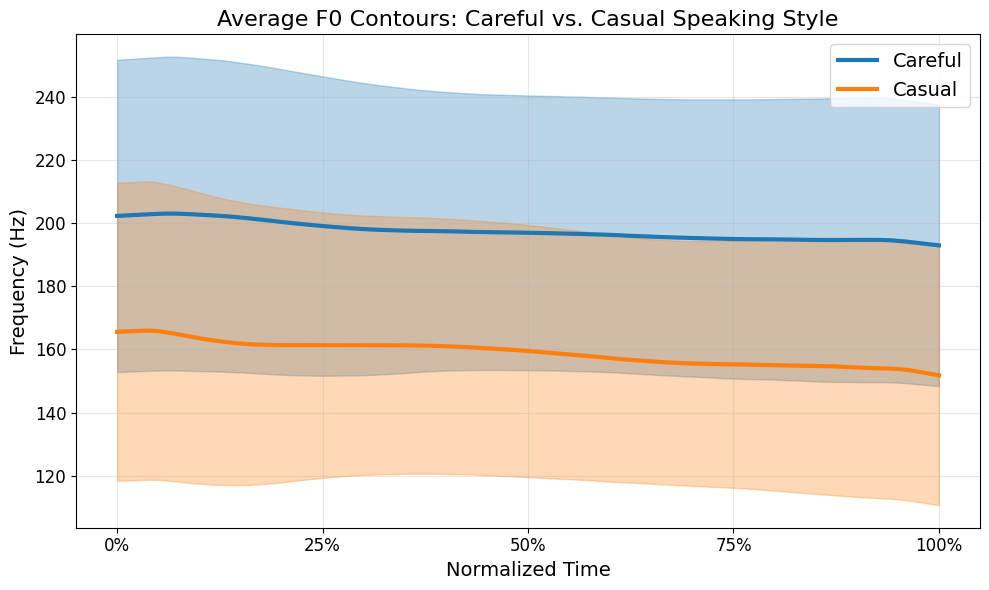


===== STATISTICAL ANALYSIS OF BREATHINESS FEATURES =====

NHR Analysis:
  Careful mean: 7.4910 ± 42.2113
  Casual mean: 6.6623 ± 29.6128
  T-test: t=0.3653, p=0.7150
  No significant difference (p≥0.05)

H1-H2 Analysis:
  Careful mean: -24.4684 ± 7.3390
  Casual mean: -21.4719 ± 6.6841
  T-test: t=-6.7680, p=0.0000
  SIGNIFICANT difference (p<0.05)
  Casual speech shows HIGHER H1-H2 values, indicating MORE BREATHINESS

Spectral_centroid Analysis:
  Careful mean: 1636.5801 ± 440.1591
  Casual mean: 1693.1020 ± 468.6353
  T-test: t=-1.9545, p=0.0509
  No significant difference (p≥0.05)

CPP Analysis:
  Careful mean: 2.3831 ± 0.8733
  Casual mean: 2.0094 ± 0.8742
  T-test: t=6.7458, p=0.0000
  SIGNIFICANT difference (p<0.05)
  Casual speech shows LOWER CPP values, indicating MORE BREATHINESS

HF_ratio Analysis:
  Careful mean: 0.2225 ± 0.1001
  Casual mean: 0.2558 ± 0.1085
  T-test: t=-4.9951, p=0.0000
  SIGNIFICANT difference (p<0.05)


/tmp/ipython-input-802957261.py:376: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipython-input-802957261.py:376: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipython-input-802957261.py:376: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipython-input-802957261.py:376: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


/tmp/ipython-input-802957261.py:376: FutureWarning:



Passing `palette` without assigning `hue` is deprecated a

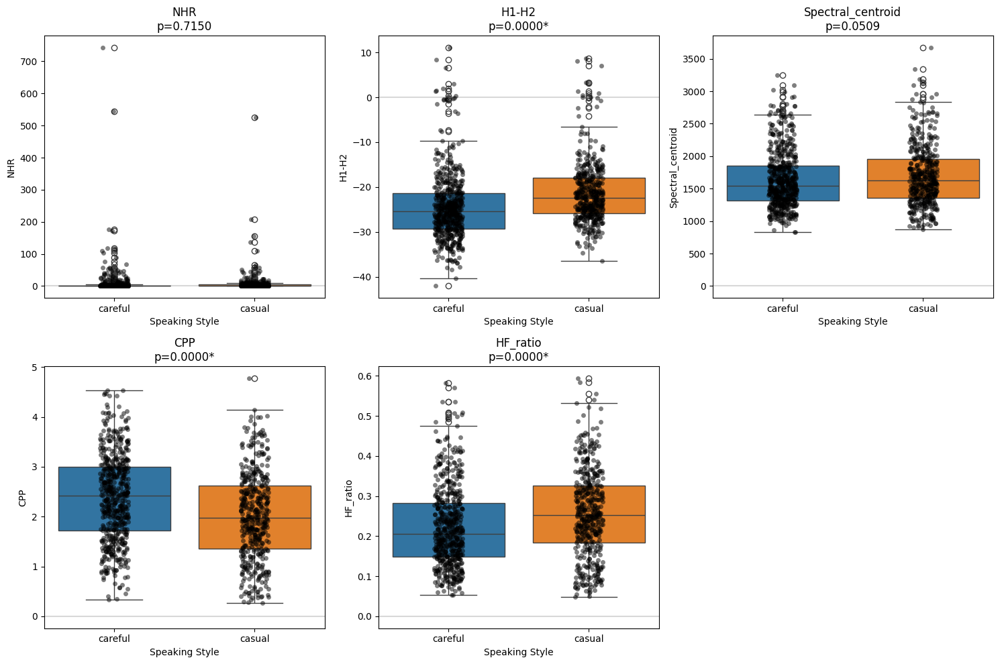

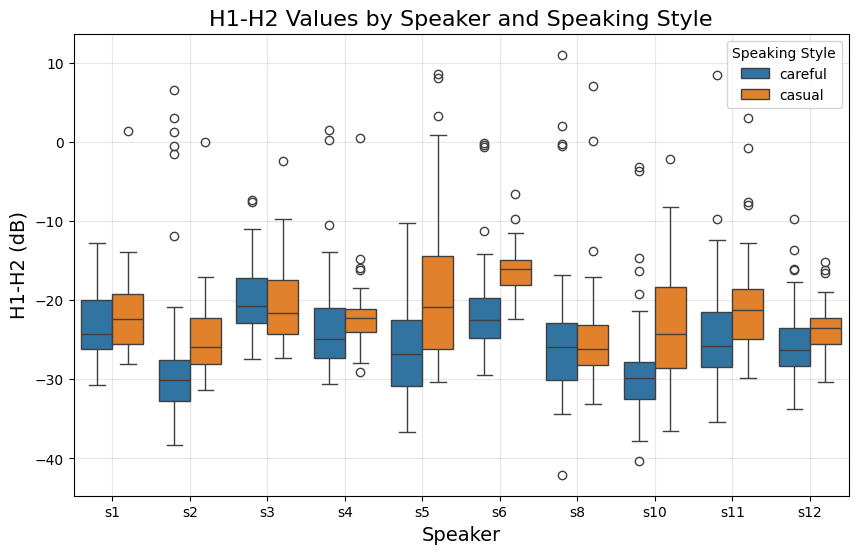

/tmp/ipython-input-802957261.py:411: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



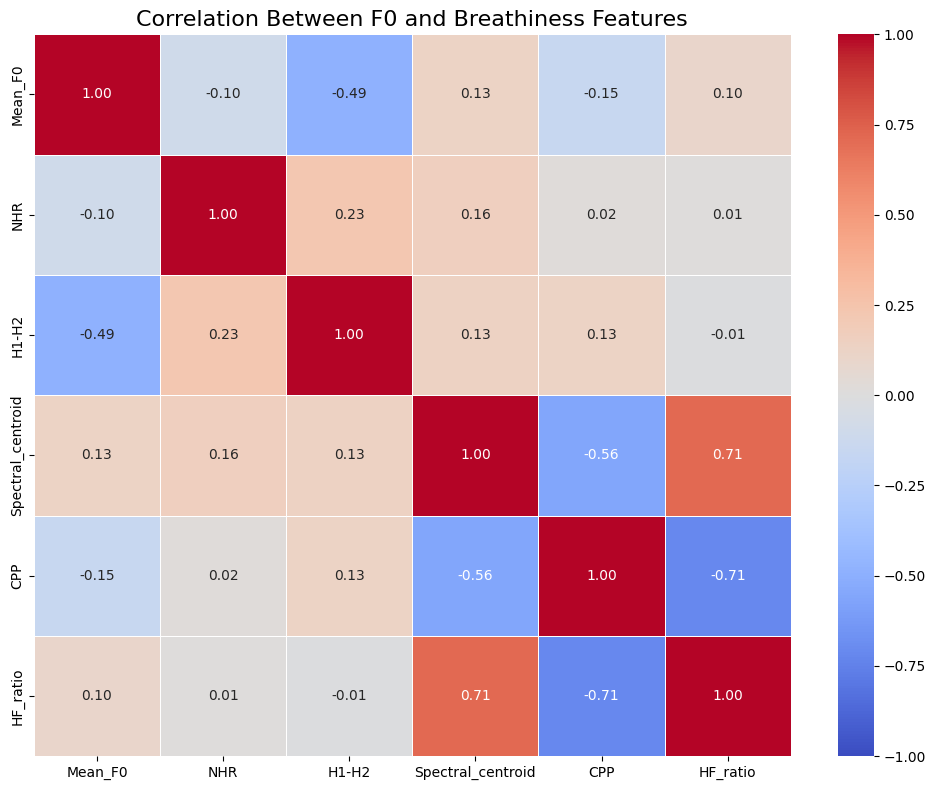


===== CORRELATION ANALYSIS BY SPEAKING STYLE =====

Correlation with Mean F0 in CAREFUL speech:
  NHR: -0.0841
  H1-H2: -0.4930
  Spectral_centroid: 0.1741
  CPP: -0.2451
  HF_ratio: 0.1973

Correlation with Mean F0 in CASUAL speech:
  NHR: -0.1764
  H1-H2: -0.3957
  Spectral_centroid: 0.1514
  CPP: -0.2811
  HF_ratio: 0.1441


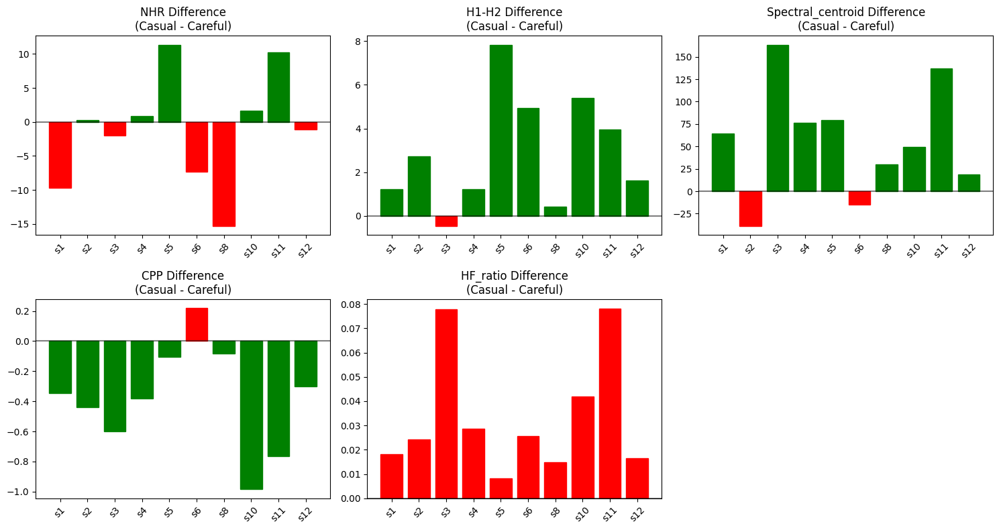

/tmp/ipython-input-802957261.py:512: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




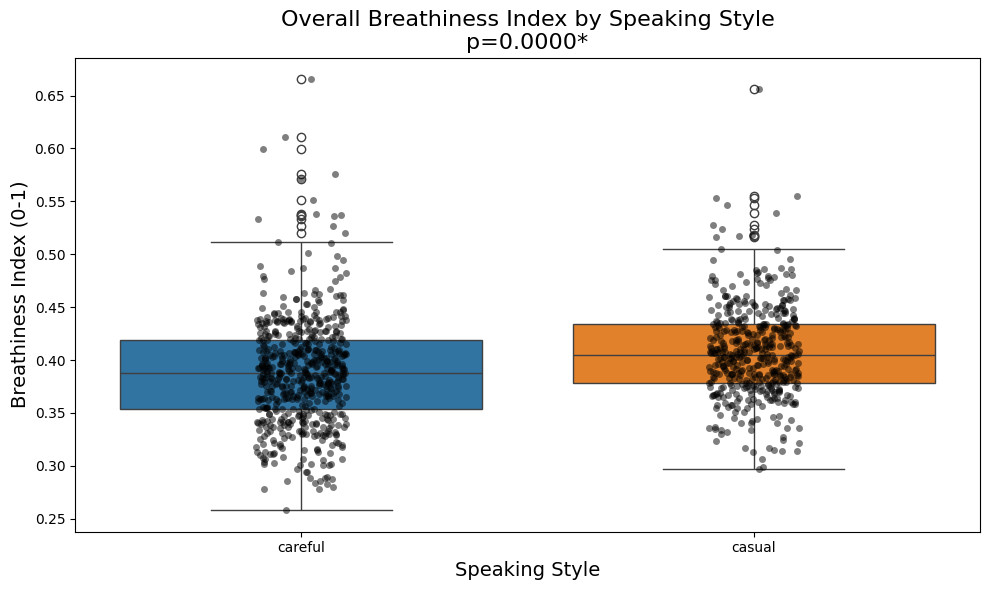


Overall Breathiness Index:
  Careful mean: 0.3886 ± 0.0519
  Casual mean: 0.4080 ± 0.0441
  T-test: t=-6.3998, p=0.0000


/tmp/ipython-input-802957261.py:535: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipython-input-802957261.py:539: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.




===== CORRELATION BETWEEN F0 VARIABILITY AND BREATHINESS =====
Overall correlation: 0.2106
Correlation in careful speech: 0.2747
Correlation in casual speech: 0.0729

===== CONCLUSION =====
This study confirms that casual speech shows significantly more breathiness than careful speech.
The features that contribute most to breathiness differences (in order) are:
  CPP: 0.0829
  HF_ratio: -0.0608
  H1-H2: 0.0564
  NHR: -0.0011

Speakers showing the largest breathiness difference between casual and careful speech:
  Speaker s10: 0.0614
  Speaker s5: 0.0429
  Speaker s11: 0.0288

Speakers showing the smallest breathiness difference between casual and careful speech:
  Speaker s8: -0.0052
  Speaker s3: -0.0051
  Speaker s6: -0.0030

Analysis complete. Results saved to CSV files.


<Figure size 1000x800 with 0 Axes>

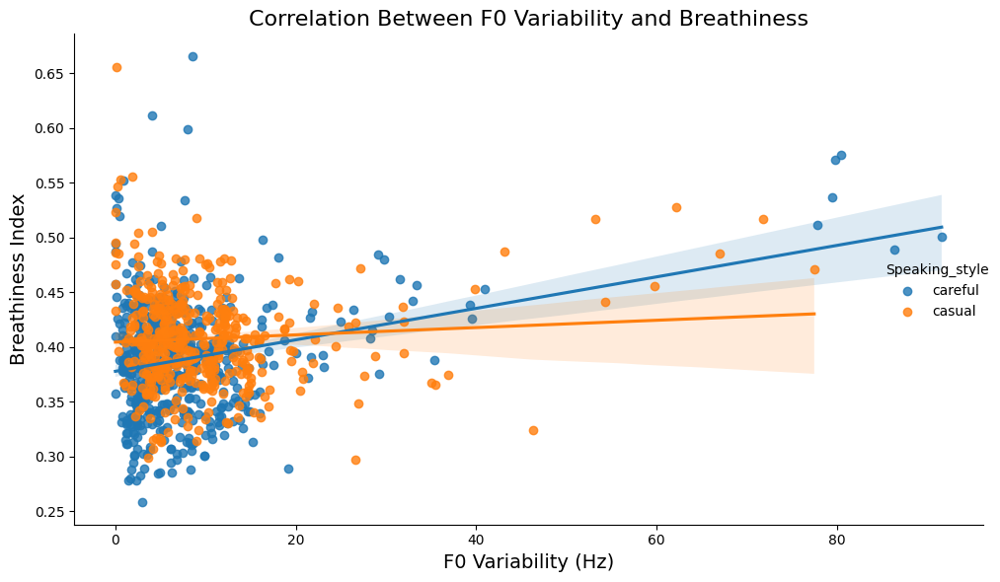

In [ ]:
import os
import librosa
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from scipy.signal import medfilt
from scipy import stats

# Main directory containing various folders including 'Careful' and 'Casual'
main_directory = '/content/drive/MyDrive/Speech_corpus_CNN/'

# List to store the folder names to read audio files from
folders_to_read = ['Careful', 'Casual']

# Define speakers to exclude
excluded_speakers = ['s7', 's9']

# Function to normalize time to range 0-1
def normalize_time(time_array):
    if len(time_array) <= 1:
        return np.array([0])
    return (time_array - time_array.min()) / (time_array.max() - time_array.min())

# Function to remove outliers from F0 values
def remove_outliers(f0_values, factor=1.5):
    """Remove outliers using IQR method with adjustable factor"""
    q1 = np.percentile(f0_values, 25)
    q3 = np.percentile(f0_values, 75)
    iqr = q3 - q1
    lower_bound = q1 - factor * iqr
    upper_bound = q3 + factor * iqr
    return np.clip(f0_values, lower_bound, upper_bound)

# Function to extract breathiness features
def extract_breathiness_features(y, sr, f0):
    """Extract features related to breathiness.

    Parameters:
    y : audio signal
    sr : sample rate
    f0 : fundamental frequency array

    Returns:
    dict : dictionary of breathiness-related features
    """
    # Get the magnitude spectrum
    S = np.abs(librosa.stft(y))

    # Calculate cepstral peak prominence (CPP) - a good indicator of breathiness
    # Higher CPP = less breathiness
    spec = librosa.amplitude_to_db(S)
    mean_spec = np.mean(spec, axis=1)
    cepstrum = np.fft.ifft(mean_spec).real
    # We're looking for the first peak after the first few bins
    # which represents the periodicity of the signal
    cpp = np.max(cepstrum[1:int(sr/70)]) - np.mean(cepstrum)

    # Get harmonic component
    harmonic = librosa.effects.harmonic(y)
    S_harmonic = np.abs(librosa.stft(harmonic))

    # Calculate noise-to-harmonics ratio (NHR)
    # Higher NHR = more breathiness
    residual = y - harmonic
    noise_power = np.mean(np.abs(librosa.stft(residual))**2)
    harmonic_power = np.mean(S_harmonic**2)
    nhr = noise_power / (harmonic_power + 1e-10)  # Avoid division by zero

    # Calculate H1-H2 (amplitude difference between first and second harmonics)
    # Higher H1-H2 = more breathiness
    if f0.size > 0 and not np.all(np.isnan(f0)):
        valid_f0 = f0[~np.isnan(f0)]
        if len(valid_f0) > 0:
            mean_f0 = np.mean(valid_f0)
            bin_width = sr / S.shape[0]
            h1_bin = int(mean_f0 / bin_width)
            h2_bin = int((2 * mean_f0) / bin_width)

            if h1_bin < S.shape[0] and h2_bin < S.shape[0]:
                h1_amp = np.max(S[max(0, h1_bin-2):min(S.shape[0], h1_bin+3), :], axis=0)
                h2_amp = np.max(S[max(0, h2_bin-2):min(S.shape[0], h2_bin+3), :], axis=0)
                h1h2 = 20 * np.log10(np.mean(h1_amp) / (np.mean(h2_amp) + 1e-10))
            else:
                h1h2 = np.nan
        else:
            h1h2 = np.nan
    else:
        h1h2 = np.nan

    # Calculate spectral tilt (simplified as spectral centroid)
    # Lower spectral centroid = steeper spectral tilt = more breathiness
    centroid = librosa.feature.spectral_centroid(y=y, sr=sr)[0]

    # High-frequency energy ratio (HF ratio) - ratio of energy above 2kHz vs. total energy
    # Lower HF ratio = more breathiness
    freq_bins = librosa.fft_frequencies(sr=sr, n_fft=2048)
    high_freq_mask = freq_bins >= 2000
    high_freq_energy = np.sum(S[high_freq_mask, :])
    total_energy = np.sum(S)
    hf_ratio = high_freq_energy / (total_energy + 1e-10)

    return {
        'nhr': nhr,
        'h1h2': h1h2,
        'spectral_centroid': np.mean(centroid),
        'cpp': cpp,
        'hf_ratio': hf_ratio
    }

# Updated function to process speech files and extract both F0 and breathiness features
def process_speech_features(main_dir, folders, n_points=100):
    """
    Process audio files to extract F0 contours and breathiness features.

    Parameters:
    main_dir : main directory containing the speech corpus
    folders : list of folders to process
    n_points : number of points for aligned time normalization

    Returns:
    tuple : (raw_data_df, aligned_data_df, breathiness_df)
    """
    raw_data = []
    aligned_data = []
    breathiness_data = []

    for folder in folders:
        directory = os.path.join(main_dir, folder)
        if os.path.exists(directory) and os.path.isdir(directory):
            for filename in os.listdir(directory):
                if filename.endswith(".wav"):
                    file_path = os.path.join(directory, filename)

                    # Extract the speaker label and speaking style
                    parts = filename.split('-')
                    speaker_label = parts[0]  # Assumes the speaker label is before the first '-'

                    # Skip excluded speakers
                    if speaker_label in excluded_speakers:
                        continue

                    speaking_style = folder.lower()  # Use folder name as speaking style

                    # Load the audio file
                    y, sr = librosa.load(file_path)

                    # Extract F0 using the librosa library
                    f0, voiced_flag, voiced_probs = librosa.pyin(y,
                                                              fmin=librosa.note_to_hz('C2'),
                                                              fmax=librosa.note_to_hz('C7'))

                    # Extract breathiness features for the whole file
                    breath_features = extract_breathiness_features(y, sr, f0)

                    # Store breathiness features
                    breathiness_data.append({
                        'Speaker': speaker_label,
                        'Speaking_style': speaking_style,
                        'Filename': filename,
                        'NHR': breath_features['nhr'],
                        'H1-H2': breath_features['h1h2'],
                        'Spectral_centroid': breath_features['spectral_centroid'],
                        'CPP': breath_features['cpp'],
                        'HF_ratio': breath_features['hf_ratio']
                    })

                    # Remove NaN values (unvoiced segments)
                    valid_indices = ~np.isnan(f0)
                    valid_f0 = f0[valid_indices]

                    if len(valid_f0) > 3:  # Only process if we have enough valid F0 values
                        # Apply median filter to reduce spikes
                        if len(valid_f0) >= 5:  # Need at least 5 points for a kernel size of 3
                            filtered_f0 = medfilt(valid_f0, kernel_size=3)
                        else:
                            filtered_f0 = valid_f0

                        # Remove outliers
                        filtered_f0 = remove_outliers(filtered_f0, factor=1.5)

                        # Get corresponding time points
                        time = librosa.times_like(f0)[valid_indices]

                        # Normalize time to 0-1 range
                        norm_time = normalize_time(time)

                        # Store raw data
                        for t, f in zip(time, filtered_f0):
                            raw_data.append({
                                'Time': t,
                                'Frequency (Hz)': f,
                                'Speaker': speaker_label,
                                'Speaking_style': speaking_style
                            })

                        # Create interpolation function for this contour
                        if len(norm_time) > 1:  # Need at least 2 points for linear interpolation
                            try:
                                # Use linear interpolation which preserves original values better
                                f_interp = interp1d(norm_time, filtered_f0,
                                                  kind='linear',
                                                  bounds_error=False,
                                                  fill_value=(filtered_f0[0], filtered_f0[-1]))

                                # Create evenly spaced points for alignment
                                aligned_times = np.linspace(0, 1, n_points)
                                aligned_f0 = f_interp(aligned_times)

                                # Store aligned data
                                for t, f in zip(aligned_times, aligned_f0):
                                    aligned_data.append({
                                        'Normalized Time': t,
                                        'Frequency (Hz)': f,
                                        'Speaker': speaker_label,
                                        'Speaking_style': speaking_style,
                                        'Filename': filename
                                    })
                            except Exception as e:
                                print(f"Interpolation error for {filename}: {e}")

    return pd.DataFrame(raw_data), pd.DataFrame(aligned_data), pd.DataFrame(breathiness_data)

# Process audio files and extract features
print("Processing speech data with speakers 7 and 9 excluded...")
raw_df, aligned_df, breathiness_df = process_speech_features(main_directory, folders_to_read)

# Verify we have data
print(f"Raw data points: {len(raw_df)}")
print(f"Aligned data points: {len(aligned_df)}")
print(f"Breathiness measurements: {len(breathiness_df)}")
print(f"Number of speakers: {aligned_df['Speaker'].nunique()}")

# Sort speakers numerically
aligned_df['Speaker_num'] = aligned_df['Speaker'].apply(lambda x: int(x.replace('s', '')))
aligned_df = aligned_df.sort_values('Speaker_num')
breathiness_df['Speaker_num'] = breathiness_df['Speaker'].apply(lambda x: int(x.replace('s', '')))
breathiness_df = breathiness_df.sort_values('Speaker_num')

# Create a categorical type with the speakers in the desired order
speaker_order = sorted(aligned_df['Speaker'].unique(), key=lambda x: int(x.replace('s', '')))
aligned_df['Speaker'] = pd.Categorical(aligned_df['Speaker'], categories=speaker_order, ordered=True)
breathiness_df['Speaker'] = pd.Categorical(breathiness_df['Speaker'], categories=speaker_order, ordered=True)

# Match the colors from your image: careful=blue, casual=orange
color_dict = {'careful': '#1f77b4', 'casual': '#ff7f0e'}

# ========== F0 ANALYSIS (FROM ORIGINAL CODE) ==========

# Calculate average F0 contours for each speaker and speaking style
speaker_avg_df = aligned_df.groupby(['Speaker', 'Speaking_style', 'Normalized Time'])['Frequency (Hz)'].agg(['mean', 'std']).reset_index()

# Create a grid of subplots that doesn't include excluded speakers
plt.figure(figsize=(10, 10))

# Calculate how many rows and columns we need
available_speakers = [s for s in speaker_order if s not in excluded_speakers]
num_speakers = len(available_speakers)
cols = 5
rows = (num_speakers + cols - 1) // cols  # Ceiling division

# Plot available speakers
for i, speaker in enumerate(available_speakers):
    speaker_data = speaker_avg_df[speaker_avg_df['Speaker'] == speaker]

    plt.subplot(rows, cols, i+1)

    # Plot each speaking style with explicit color settings
    for style in ['careful', 'casual']:
        style_data = speaker_data[speaker_data['Speaking_style'] == style]
        if not style_data.empty:
            x = style_data['Normalized Time']
            y = style_data['mean']
            stderr = style_data['std']

            color = color_dict[style]
            plt.plot(x, y, linewidth=2, label=style, color=color)
            plt.fill_between(x, y-stderr, y+stderr, alpha=0.3, color=color)

    plt.title(f'Speaker {speaker}')
    plt.ylim(0, 300)
    plt.xticks([0, 0.25, 0.5, 0.75, 1], ['0%', '25%', '50%', '75%', '100%'])

    if i % cols == 0:  # Only show y-label on leftmost plots
        plt.ylabel('Frequency (Hz)')
    else:
        plt.ylabel('')

    if i >= (rows-1) * cols:  # Only show x-label on bottom plots
        plt.xlabel('Normalized Time')
    else:
        plt.xlabel('')

    # Only add legend to the first plot
    if i == 0:
        # Create custom legend with explicit colors
        from matplotlib.lines import Line2D
        legend_elements = [
            Line2D([0], [0], color=color_dict['careful'], lw=2, label='careful'),
            Line2D([0], [0], color=color_dict['casual'], lw=2, label='casual')
        ]
        plt.legend(handles=legend_elements, loc='lower right', frameon=False)

plt.tight_layout()
plt.savefig('f0_by_speaker.png', dpi=300)
plt.show()

# Overall average F0 plot
plt.figure(figsize=(10, 6))

# Calculate overall average for each speaking style
overall_avg = speaker_avg_df.groupby(['Speaking_style', 'Normalized Time'])['mean'].agg(['mean', 'std']).reset_index()

# Plot each speaking style
for style in ['careful', 'casual']:
    style_data = overall_avg[overall_avg['Speaking_style'] == style]
    x = style_data['Normalized Time']
    y = style_data['mean']
    stderr = style_data['std']

    color = color_dict[style]
    plt.plot(x, y, linewidth=3, label=style.capitalize(), color=color)
    plt.fill_between(x, y-stderr, y+stderr, alpha=0.3, color=color)

plt.title('Average F0 Contours: Careful vs. Casual Speaking Style', fontsize=16)
plt.xlabel('Normalized Time', fontsize=14)
plt.ylabel('Frequency (Hz)', fontsize=14)
plt.xticks([0, 0.25, 0.5, 0.75, 1], ['0%', '25%', '50%', '75%', '100%'], fontsize=12)
plt.yticks(fontsize=12)
plt.legend(loc='upper right', fontsize=14)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.savefig('overall_f0_comparison.png', dpi=300)
plt.show()

# ========== BREATHINESS ANALYSIS (NEW CODE) ==========

# Remove any NaN values for statistical analysis
clean_breathiness_df = breathiness_df.dropna(subset=['NHR', 'H1-H2', 'Spectral_centroid', 'CPP', 'HF_ratio'])

# 1. Statistical comparison of breathiness features between careful and casual speech
print("\n===== STATISTICAL ANALYSIS OF BREATHINESS FEATURES =====")
features = ['NHR', 'H1-H2', 'Spectral_centroid', 'CPP', 'HF_ratio']
for feature in features:
    careful_values = clean_breathiness_df[clean_breathiness_df['Speaking_style'] == 'careful'][feature]
    casual_values = clean_breathiness_df[clean_breathiness_df['Speaking_style'] == 'casual'][feature]

    t_stat, p_value = stats.ttest_ind(careful_values, casual_values, equal_var=False)

    print(f"\n{feature} Analysis:")
    print(f"  Careful mean: {careful_values.mean():.4f} ± {careful_values.std():.4f}")
    print(f"  Casual mean: {casual_values.mean():.4f} ± {casual_values.std():.4f}")
    print(f"  T-test: t={t_stat:.4f}, p={p_value:.4f}")

    if p_value < 0.05:
        print(f"  SIGNIFICANT difference (p<0.05)")
        if feature == 'H1-H2' and casual_values.mean() > careful_values.mean():
            print("  Casual speech shows HIGHER H1-H2 values, indicating MORE BREATHINESS")
        elif feature == 'NHR' and casual_values.mean() > careful_values.mean():
            print("  Casual speech shows HIGHER NHR values, indicating MORE BREATHINESS")
        elif feature == 'CPP' and casual_values.mean() < careful_values.mean():
            print("  Casual speech shows LOWER CPP values, indicating MORE BREATHINESS")
        elif feature == 'HF_ratio' and casual_values.mean() < careful_values.mean():
            print("  Casual speech shows LOWER HF_ratio values, indicating MORE BREATHINESS")
    else:
        print(f"  No significant difference (p≥0.05)")

# 2. Create boxplots for each breathiness feature
plt.figure(figsize=(15, 10))

for i, feature in enumerate(features):
    plt.subplot(2, 3, i+1)

    # Create boxplot
    sns.boxplot(x='Speaking_style', y=feature, data=clean_breathiness_df, palette=color_dict)

    # Add individual data points
    sns.stripplot(x='Speaking_style', y=feature, data=clean_breathiness_df,
                 color='black', alpha=0.5, jitter=True)

    # Annotate with p-value
    careful_values = clean_breathiness_df[clean_breathiness_df['Speaking_style'] == 'careful'][feature]
    casual_values = clean_breathiness_df[clean_breathiness_df['Speaking_style'] == 'casual'][feature]
    _, p_value = stats.ttest_ind(careful_values, casual_values, equal_var=False)

    plt.title(f'{feature}\np={p_value:.4f}{"*" if p_value < 0.05 else ""}')
    plt.xlabel('Speaking Style')

    # Add a subtle horizontal line at y=0 if needed
    plt.axhline(y=0, color='gray', linestyle='-', alpha=0.3)

plt.tight_layout()
plt.savefig('breathiness_boxplots.png', dpi=300)
plt.show()

# 3. Plot H1-H2 values by speaker (most direct breathiness indicator)
plt.figure(figsize=(10, 6))
sns.boxplot(x='Speaker', y='H1-H2', hue='Speaking_style', data=clean_breathiness_df, palette=color_dict)
plt.title('H1-H2 Values by Speaker and Speaking Style', fontsize=16)
plt.xlabel('Speaker', fontsize=14)
plt.ylabel('H1-H2 (dB)', fontsize=14)
plt.legend(title='Speaking Style')
plt.grid(alpha=0.3)
plt.savefig('h1h2_by_speaker.png', dpi=300)
plt.show()

# 4. Create correlation heatmap between breathiness features and F0
# First, merge the breathiness data with F0 data at the file level
# Create average F0 per file
avg_f0_by_file = aligned_df.groupby(['Speaker', 'Speaking_style', 'Filename'])['Frequency (Hz)'].mean().reset_index()
avg_f0_by_file = avg_f0_by_file.rename(columns={'Frequency (Hz)': 'Mean_F0'})

# Merge with breathiness data
merged_data = pd.merge(clean_breathiness_df, avg_f0_by_file,
                      on=['Speaker', 'Speaking_style', 'Filename'], how='inner')

# Create correlation matrix
corr_features = ['Mean_F0', 'NHR', 'H1-H2', 'Spectral_centroid', 'CPP', 'HF_ratio']
correlation_matrix = merged_data[corr_features].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1,
           fmt='.2f', linewidths=0.5)
plt.title('Correlation Between F0 and Breathiness Features', fontsize=16)
plt.tight_layout()
plt.savefig('correlation_heatmap.png', dpi=300)
plt.show()

# 5. Separate correlation analysis by speaking style
print("\n===== CORRELATION ANALYSIS BY SPEAKING STYLE =====")
for style in ['careful', 'casual']:
    style_data = merged_data[merged_data['Speaking_style'] == style]
    corr = style_data[corr_features].corr().loc['Mean_F0', :]

    print(f"\nCorrelation with Mean F0 in {style.upper()} speech:")
    for feature in corr.index:
        if feature != 'Mean_F0':
            print(f"  {feature}: {corr[feature]:.4f}")

# 6. Plot individual speaker breathiness profiles
plt.figure(figsize=(15, 8))

# For each feature, plot the difference (casual - careful) for each speaker
for i, feature in enumerate(features):
    plt.subplot(2, 3, i+1)

    # Calculate the mean difference for each speaker
    speaker_diff = []

    for speaker in available_speakers:
        speaker_data = clean_breathiness_df[clean_breathiness_df['Speaker'] == speaker]
        careful_mean = speaker_data[speaker_data['Speaking_style'] == 'careful'][feature].mean()
        casual_mean = speaker_data[speaker_data['Speaking_style'] == 'casual'][feature].mean()

        if not np.isnan(careful_mean) and not np.isnan(casual_mean):
            speaker_diff.append({
                'Speaker': speaker,
                'Difference': casual_mean - careful_mean
            })

    speaker_diff_df = pd.DataFrame(speaker_diff)

    # Plot
    bars = plt.bar(speaker_diff_df['Speaker'], speaker_diff_df['Difference'])

    # Color code: positive = more breathiness in casual speech (for most features)
    # For CPP and HF_ratio, negative = more breathiness in casual speech
    if feature in ['CPP', 'HF_ratio']:
        for i, bar in enumerate(bars):
            bar.set_color('green' if speaker_diff_df['Difference'].iloc[i] < 0 else 'red')
    else:
        for i, bar in enumerate(bars):
            bar.set_color('green' if speaker_diff_df['Difference'].iloc[i] > 0 else 'red')

    plt.axhline(y=0, color='black', linestyle='-', alpha=0.5)
    plt.title(f'{feature} Difference\n(Casual - Careful)')
    plt.xticks(rotation=45)
    plt.tight_layout()

plt.savefig('speaker_breathiness_profiles.png', dpi=300)
plt.show()

# 7. Create a breathiness index (composite score from multiple features)
# Normalize each feature to 0-1 scale where higher = more breathiness
def normalize_feature(feature_series):
    min_val = feature_series.min()
    max_val = feature_series.max()
    if max_val > min_val:
        return (feature_series - min_val) / (max_val - min_val)
    else:
        return feature_series * 0  # If min=max, return all zeros

# Create normalized features (higher = more breathiness)
breathiness_scores = clean_breathiness_df.copy()
breathiness_scores['NHR_norm'] = normalize_feature(breathiness_scores['NHR'])
breathiness_scores['H1H2_norm'] = normalize_feature(breathiness_scores['H1-H2'])
# For CPP and HF_ratio, lower values = more breathiness, so invert
breathiness_scores['CPP_norm'] = 1 - normalize_feature(breathiness_scores['CPP'])
breathiness_scores['HF_norm'] = 1 - normalize_feature(breathiness_scores['HF_ratio'])

# Calculate breathiness index as average of normalized features
breathiness_scores['Breathiness_Index'] = (
    breathiness_scores['NHR_norm'] +
    breathiness_scores['H1H2_norm'] +
    breathiness_scores['CPP_norm'] +
    breathiness_scores['HF_norm']
) / 4

# Plot overall breathiness index
plt.figure(figsize=(10, 6))
sns.boxplot(x='Speaking_style', y='Breathiness_Index', data=breathiness_scores, palette=color_dict)
sns.stripplot(x='Speaking_style', y='Breathiness_Index', data=breathiness_scores,
             color='black', alpha=0.5, jitter=True)

# Calculate statistics
careful_index = breathiness_scores[breathiness_scores['Speaking_style'] == 'careful']['Breathiness_Index']
casual_index = breathiness_scores[breathiness_scores['Speaking_style'] == 'casual']['Breathiness_Index']
t_stat, p_value = stats.ttest_ind(careful_index, casual_index, equal_var=False)

plt.title(f'Overall Breathiness Index by Speaking Style\np={p_value:.4f}{"*" if p_value < 0.05 else ""}', fontsize=16)
plt.xlabel('Speaking Style', fontsize=14)
plt.ylabel('Breathiness Index (0-1)', fontsize=14)
plt.tight_layout()
plt.savefig('breathiness_index.png', dpi=300)
plt.show()

print(f"\nOverall Breathiness Index:")
print(f"  Careful mean: {careful_index.mean():.4f} ± {careful_index.std():.4f}")
print(f"  Casual mean: {casual_index.mean():.4f} ± {casual_index.std():.4f}")
print(f"  T-test: t={t_stat:.4f}, p={p_value:.4f}")

# 8. Correlate breathiness index with F0 variability
# Calculate F0 variability (standard deviation) for each file
f0_variability = aligned_df.groupby(['Speaker', 'Speaking_style', 'Filename'])['Frequency (Hz)'].std().reset_index()
f0_variability = f0_variability.rename(columns={'Frequency (Hz)': 'F0_variability'})

# Calculate mean breathiness index for each file
breathiness_by_file = breathiness_scores.groupby(['Speaker', 'Speaking_style', 'Filename'])['Breathiness_Index'].mean().reset_index()

# Merge the data
f0_breath_data = pd.merge(f0_variability, breathiness_by_file,
                         on=['Speaker', 'Speaking_style', 'Filename'], how='inner')

# Plot correlation
plt.figure(figsize=(10, 8))
g = sns.lmplot(x='F0_variability', y='Breathiness_Index', hue='Speaking_style',
             data=f0_breath_data, palette=color_dict, height=6, aspect=1.5)
plt.title('Correlation Between F0 Variability and Breathiness', fontsize=16)
plt.xlabel('F0 Variability (Hz)', fontsize=14)
plt.ylabel('Breathiness Index', fontsize=14)
plt.tight_layout()
plt.savefig('f0_variability_breathiness.png', dpi=300)

# Calculate correlations
print("\n===== CORRELATION BETWEEN F0 VARIABILITY AND BREATHINESS =====")
overall_corr = f0_breath_data['F0_variability'].corr(f0_breath_data['Breathiness_Index'])
careful_corr = f0_breath_data[f0_breath_data['Speaking_style'] == 'careful']['F0_variability'].corr(
    f0_breath_data[f0_breath_data['Speaking_style'] == 'careful']['Breathiness_Index'])
casual_corr = f0_breath_data[f0_breath_data['Speaking_style'] == 'casual']['F0_variability'].corr(
    f0_breath_data[f0_breath_data['Speaking_style'] == 'casual']['Breathiness_Index'])

print(f"Overall correlation: {overall_corr:.4f}")
print(f"Correlation in careful speech: {careful_corr:.4f}")
print(f"Correlation in casual speech: {casual_corr:.4f}")

# Print conclusion
print("\n===== CONCLUSION =====")
if casual_index.mean() > careful_index.mean() and p_value < 0.05:
    print("This study confirms that casual speech shows significantly more breathiness than careful speech.")

    # Determine which breathiness features contribute most to the difference
    feature_contributions = []
    for feature, norm_feature in [('NHR', 'NHR_norm'), ('H1-H2', 'H1H2_norm'),
                                ('CPP', 'CPP_norm'), ('HF_ratio', 'HF_norm')]:
        careful_mean = breathiness_scores[breathiness_scores['Speaking_style'] == 'careful'][norm_feature].mean()
        casual_mean = breathiness_scores[breathiness_scores['Speaking_style'] == 'casual'][norm_feature].mean()
        diff = casual_mean - careful_mean
        feature_contributions.append((feature, diff))

    # Sort by contribution
    feature_contributions.sort(key=lambda x: abs(x[1]), reverse=True)

    print("The features that contribute most to breathiness differences (in order) are:")
    for feature, diff in feature_contributions:
        print(f"  {feature}: {diff:.4f}")

    # Check for speaker-specific patterns
    speaker_differences = []
    for speaker in available_speakers:
        speaker_careful = breathiness_scores[(breathiness_scores['Speaker'] == speaker) &
                                           (breathiness_scores['Speaking_style'] == 'careful')]['Breathiness_Index'].mean()
        speaker_casual = breathiness_scores[(breathiness_scores['Speaker'] == speaker) &
                                          (breathiness_scores['Speaking_style'] == 'casual')]['Breathiness_Index'].mean()
        speaker_differences.append((speaker, speaker_casual - speaker_careful))

    # Find speakers with greatest and smallest differences
    speaker_differences.sort(key=lambda x: abs(x[1]), reverse=True)

    print("\nSpeakers showing the largest breathiness difference between casual and careful speech:")
    for speaker, diff in speaker_differences[:3]:
        print(f"  Speaker {speaker}: {diff:.4f}")

    print("\nSpeakers showing the smallest breathiness difference between casual and careful speech:")
    for speaker, diff in speaker_differences[-3:]:
        print(f"  Speaker {speaker}: {diff:.4f}")
else:
    print("This study did not find significant breathiness differences between casual and careful speech.")

# Save the final dataframes to CSV for further analysis
aligned_df.to_csv('f0_analysis_results.csv', index=False)
breathiness_df.to_csv('breathiness_analysis_results.csv', index=False)
breathiness_scores.to_csv('breathiness_scores.csv', index=False)

print("\nAnalysis complete. Results saved to CSV files.")

# Syllable Weight

In [ ]:
!pip install praat-parselmouth
!pip install textgrid

  Preparing metadata (setup.py) ... done
  Created wheel for textgrid: filename=TextGrid-1.6.1-py3-none-any.whl size=10146 sha256=827a743a4bb5ff767a4784ebd9a56be234c9ca10afb90336d8a76b5bbff5b94c
  Stored in directory: /root/.cache/pip/wheels/ce/86/7b/5766bd19fa4b4554667dd186e614b5a438ab14eec9c5a3642a
Successfully built textgrid


# Similar to PRAAT visualization

Get:1 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:3 https://cli.github.com/packages stable InRelease [3,917 B]
Get:4 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:5 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://security.ubuntu.com/ubuntu jammy-security/multiverse amd64 Packages [62.6 kB]
Get:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease [18.1 kB]
Get:9 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:10 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,297 kB]
Get:11 http://security.ubuntu.com/ubuntu jammy-security/restricted amd64 Packages [6,388 kB]
Get:12 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease [24.6 kB]
Get:13 http://security.ubuntu.com/ubuntu jammy-security/m

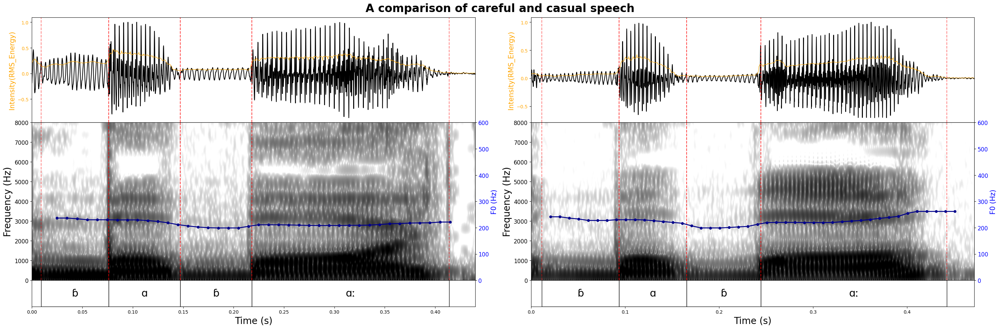

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import textgrid
import torch
import torchaudio
import torchaudio.transforms as T
import scipy.ndimage
import librosa
import parselmouth
import matplotlib.patches as patches

!apt-get update
!apt-get install ffmpeg
!pip install torchcodec # Install torchcodec

# File paths
# Input files
audio_files = ["/content/bobo_clear_slow.wav", "/content/bobo_clear_fast.wav"]
textgrid_files = ["/content/bobo_clear_slow.TextGrid", "/content/bobo_clear_fast.TextGrid"]


def extract_f0_parselmouth(audio_file):
    """
    Extracts F0 contour using Parselmouth (Praat-based pitch tracking).
    Applies median filtering to smooth pitch curve.
    """
    snd = parselmouth.Sound(audio_file)
    pitch = snd.to_pitch(time_step=0.01, pitch_floor=75, pitch_ceiling=600)
    f0_values = pitch.selected_array['frequency']
    f0_times = pitch.xs()

    f0_values[f0_values == 0] = np.nan  # Remove unvoiced regions
    f0_values = scipy.ndimage.median_filter(f0_values, size=5)  # Smooth pitch track

    return f0_times, f0_values

def extract_word_boundaries(textgrid_file):
    """
    Extracts the time boundaries for the word tier.
    """
    tg = textgrid.TextGrid.fromFile(textgrid_file)

    for tier in tg:
        if tier.name.lower() in ["words", "word"]:
            if len(tier) > 0:
                return tier[0].minTime, tier[-1].maxTime  # Word boundary

    return None, None  # No word tier found

def plot_audio_comparison(audio_files, textgrid_files):
    """
    Compare two audio files within their word boundaries.
    """
    fig, axes = plt.subplots(3, 2, figsize=(30, 10), gridspec_kw={'height_ratios': [2, 3, 0.5], 'hspace': 0.0}, sharex='col')
    fig.suptitle("A comparison of careful and casual speech", fontsize=24, fontweight='bold')

    for i, (audio_file, textgrid_file) in enumerate(zip(audio_files, textgrid_files)):
        # Load audio using librosa instead of torchaudio
        waveform_np, sr = librosa.load(audio_file, sr=None) # Load as numpy array

        # Convert to tensor and ensure it's mono (1D)
        if waveform_np.ndim > 1: # If stereo
            waveform = torch.tensor(waveform_np).mean(dim=0)
        else: # If already mono
            waveform = torch.tensor(waveform_np)

        # Normalize waveform
        waveform = waveform / waveform.abs().max()

        # Extract word boundaries
        start_time, end_time = extract_word_boundaries(textgrid_file)
        if start_time is None or end_time is None:
            print(f"Word tier not found in {textgrid_file}")
            continue

        # Convert start and end times to sample indices
        start_sample, end_sample = int(start_time * sr), int(end_time * sr)

        # Crop waveform
        waveform = waveform[start_sample:end_sample]
        duration = (end_sample - start_sample) / sr

        # Compute spectrogram
        n_fft = 512 * 10
        win_length = 200
        hop_length = 20
        spectrogram_transform = T.Spectrogram(n_fft=n_fft, win_length=win_length, hop_length=hop_length, power=2)
        spectrogram = spectrogram_transform(torch.tensor(waveform.numpy()))
        spectrogram_db = torchaudio.transforms.AmplitudeToDB()(spectrogram)
        spectrogram_db = np.clip(spectrogram_db.numpy(), -50, 20)

        # Compute intensity
        intensity = librosa.feature.rms(y=waveform.numpy(), frame_length=win_length, hop_length=hop_length)[0]
        intensity_time = np.linspace(0, duration, len(intensity))

        # Extract F0
        f0_time, f0 = extract_f0_parselmouth(audio_file)
        mask = (f0_time >= start_time) & (f0_time <= end_time)
        f0_time, f0 = f0_time[mask] - start_time, f0[mask]

        # Load TextGrid and extract phones
        tg = textgrid.TextGrid.fromFile(textgrid_file)
        phone_tier = next((tier for tier in tg if tier.name.lower() in ["phones", "phone"]), None)

        # Plot waveform with intensity
        ax_waveform, ax_intensity = axes[0, i], axes[0, i]
        ax_waveform.plot(np.linspace(0, duration, waveform.shape[0]), waveform.numpy(), color='black')
        ax_waveform.set_yticks(np.linspace(-1, 1, 5))  # Consistent ticks
        ax_intensity.plot(intensity_time, intensity, color='orange', alpha=0.9, linewidth=1)
        ax_intensity.set_ylabel("Intensity(RMS_Energy)", color='orange', fontsize=15)
        ax_intensity.tick_params(axis='y', labelcolor='orange', labelsize=10)

        # Plot spectrogram with F0
        ax_spectrogram, ax_f0 = axes[1, i], axes[1, i].twinx()
        ax_spectrogram.imshow(spectrogram_db, aspect='auto', origin='lower', cmap='grey_r', extent=[0, duration, 0, sr//2])
        ax_spectrogram.set_ylim(0, 8000)
        ax_spectrogram.tick_params(axis='y', labelsize=12)
        ax_spectrogram.set_ylabel("Frequency (Hz)", fontsize=20)
        ax_f0.plot(f0_time, f0, color='darkblue', marker="o", markersize=5, linestyle="-", linewidth=2)
        ax_f0.set_ylim(0, 600)
        ax_f0.set_ylabel("F0 (Hz)", color='blue', fontsize=15)
        ax_f0.tick_params(axis='y', labelcolor='blue', labelsize=12)

        # Plot phones and boundaries
        ax_phones = axes[2, i]
        ax_phones.set_ylim(0, 1)
        ax_phones.set_yticks([])
        ax_phones.set_xlabel('Time (s)', fontsize=20)
        ax_phones.set_xlim(0, duration)

        # Define the set of phonemes to highlight
        highlighted_phonemes = {'r', 'ʁ'}

        if phone_tier:
            for interval in phone_tier:
                if start_time <= interval.minTime <= end_time and interval.mark.strip():
                    interval_start = interval.minTime - start_time
                    interval_end = interval.maxTime - start_time

                    # Check if the phoneme is in the highlighted set
                    if interval.mark in highlighted_phonemes:
                        color = '#FFD580'  # Yellow for highlighted phonemes
                    else:
                        color = 'white'  # Default color for others

                    # Draw phone boundary lines on waveform and spectrogram
                    ax_waveform.axvline(x=interval_start, linestyle='--', color='red', alpha=0.5)
                    ax_waveform.axvline(x=interval_end, linestyle='--', color='red', alpha=0.5)
                    ax_spectrogram.axvline(x=interval_start, linestyle='--', color='red', alpha=0.5)
                    ax_spectrogram.axvline(x=interval_end, linestyle='--', color='red', alpha=0.5)

                    # Draw phone interval box on phones plot
                    rect = patches.Rectangle((interval_start, 0), interval_end - interval_start, 1, linewidth=1,
                                            edgecolor='black', facecolor=color)
                    ax_phones.add_patch(rect)

                    # Add phone label
                    ax_phones.text((interval_start + interval_end) / 2, 0.5, interval.mark, ha='center', va='center', fontsize=22)


    plt.tight_layout()
    plt.savefig('comparison_s11_careful_casual.png', dpi=1000, bbox_inches="tight")
    plt.show()

# Run the comparison plot
plot_audio_comparison(audio_files, textgrid_files)

# 3D

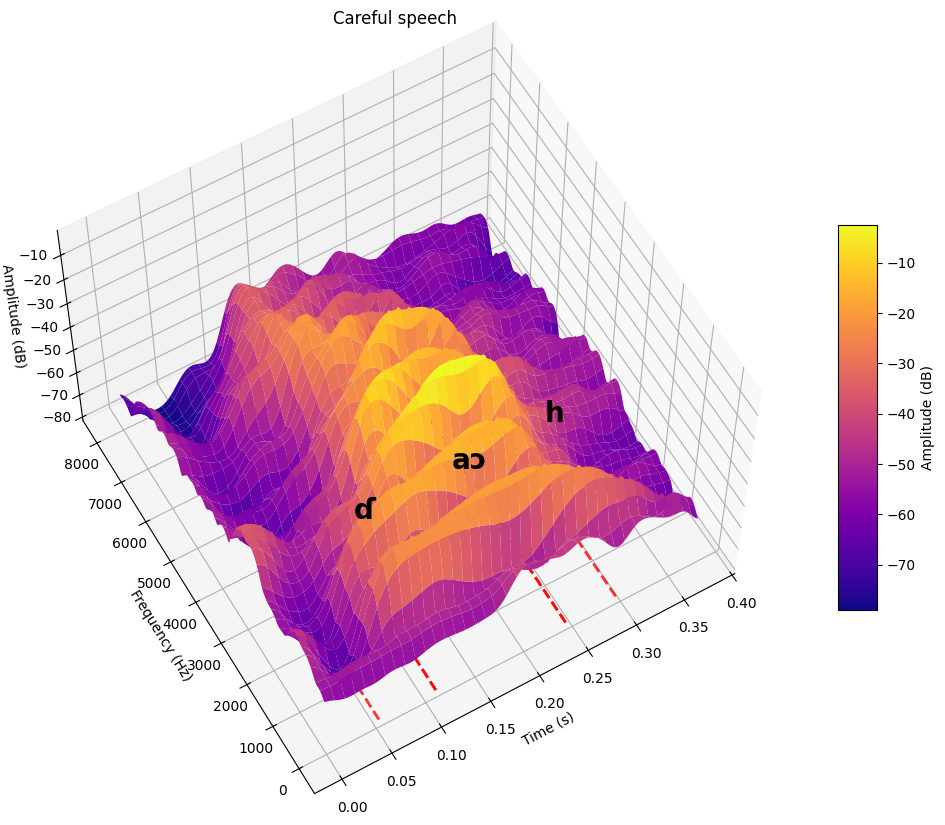

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import textgrid
import librosa
import librosa.display
import parselmouth
import scipy.ndimage
import scipy.interpolate
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import RectBivariateSpline  # Import RectBivariateSpline

# File paths
audio_file = "/content/doh_careful.wav"
textgrid_file = "/content/doh_careful.TextGrid"

def extract_f0_parselmouth(audio_file):
    """
    Extracts F0 contour using Parselmouth (Praat-based pitch tracking).
    Applies median filtering to smooth pitch curve.
    """
    snd = parselmouth.Sound(audio_file)
    pitch = snd.to_pitch(time_step=0.01, pitch_floor=75, pitch_ceiling=600)
    f0_values = pitch.selected_array['frequency']
    f0_times = pitch.xs()

    # Remove unvoiced regions (0 Hz values)
    f0_values[f0_values == 0] = np.nan

    # Apply stronger median filtering for smoother curves
    f0_values = scipy.ndimage.median_filter(f0_values, size=7)

    return f0_times, f0_values

def plot_3d_spectrogram(spectrogram_db, sr, hop_length, duration, phone_tier):
    """
    Plots a **smoothed** 3D spectrogram using Matplotlib.
    """
    fig = plt.figure(figsize=(15, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Create time and frequency scales
    time_bins = np.linspace(0, duration, spectrogram_db.shape[1])
    freq_bins = librosa.fft_frequencies(sr=sr, n_fft=2048)

    # **Limit frequency to 8000 Hz** (for better visualization)
    max_freq = 8000
    freq_idx = np.where(freq_bins <= max_freq)[0]
    spectrogram_db = spectrogram_db[freq_idx, :]
    freq_bins = freq_bins[freq_idx]

    # **Apply Gaussian Smoothing to Spectrogram**
    spectrogram_db = scipy.ndimage.gaussian_filter(spectrogram_db, sigma=2)

    # **Upsample for smoother surface**
    new_time_bins = np.linspace(time_bins.min(), time_bins.max(), len(time_bins) * 2)  # Double time resolution
    new_freq_bins = np.linspace(freq_bins.min(), freq_bins.max(), len(freq_bins) * 2)  # Double frequency resolution

    # Interpolate data to increase resolution
    # **Replace interp2d with RectBivariateSpline**
    interp_func = RectBivariateSpline(freq_bins, time_bins, spectrogram_db)  # Create spline object
    spectrogram_db_smooth = interp_func(new_freq_bins, new_time_bins)  # Interpolate using spline


    # Create a meshgrid for 3D plotting
    T, F = np.meshgrid(new_time_bins, new_freq_bins)

    # Convert dB values into height (Z-axis)
    Z = spectrogram_db_smooth

    # **Plot the smoothed spectrogram surface**
    surf = ax.plot_surface(T, F, Z, cmap='plasma', edgecolor='none', alpha=1)

    # **Draw phoneme boundaries on 3D plot**
    for interval in phone_tier:
        if interval.mark.strip():  # Skip empty intervals
            min_time, max_time = interval.minTime, interval.maxTime
            phoneme = interval.mark

            # **Plot vertical boundary lines**
            ax.plot([min_time, min_time], [75, max_freq], [-80, -80], color='red', linestyle='--', linewidth=2, alpha=0.8)
            ax.plot([max_time, max_time], [75, max_freq], [-80, -80], color='red', linestyle='--', linewidth=2, alpha=0.8)

            # **Add phoneme labels**
            mid_time = (min_time + max_time) / 2
            ax.text(mid_time, max_freq - 6000, -30, phoneme, color='black', fontsize=20, fontweight='bold')

    # Set labels
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("Frequency (Hz)")
    ax.set_zlabel("Amplitude (dB)")
    ax.set_title("Careful speech")

    # Adjust the view angle
    ax.view_init(elev=60, azim=240)

    # **Add Colorbar for Amplitude**
    fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Amplitude (dB)")

    plt.savefig("3d_spectrogram_careful.png", dpi=1000, bbox_inches="tight")


    plt.show()

def plot_audio_with_textgrid(audio_file, textgrid_file):
    """
    Plot waveform with intensity, a refined Praat-like spectrogram with F0 contour, and phone tier from TextGrid.

    Parameters:
    -----------
    audio_file : str
        Path to audio file
    textgrid_file : str
        Path to TextGrid file
    """
    # Load audio file using Librosa for higher quality
    waveform, sr = librosa.load(audio_file, sr=None)
    duration = len(waveform) / sr

    # Normalize waveform for better visualization
    waveform = waveform / np.max(np.abs(waveform))

    # Compute Praat-like spectrogram using Librosa
    n_fft = 2048*5  # Higher FFT for better resolution
    hop_length = int(sr * 0.005)  # 5ms hop size
    win_length = int(sr * 0.025)  # 25ms window

    S = librosa.stft(waveform, n_fft=n_fft, hop_length=hop_length, win_length=win_length, window="hann")
    spectrogram_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)

    # Extract F0 using Parselmouth
    f0_time, f0 = extract_f0_parselmouth(audio_file)

    # Load TextGrid
    tg = textgrid.TextGrid.fromFile(textgrid_file)

    # Find phone tier
    phone_tier = None
    for tier in tg:
        if tier.name.lower() in ["phones", "phone"]:
            phone_tier = tier
            break

    if phone_tier is None:
        print("No phone tier found.")
        return

    # **Generate improved smoothed 3D spectrogram**

    plot_3d_spectrogram(spectrogram_db, sr, hop_length, duration, phone_tier)

# Run the function with your files

plot_audio_with_textgrid(audio_file, textgrid_file)


# RiverBank plot

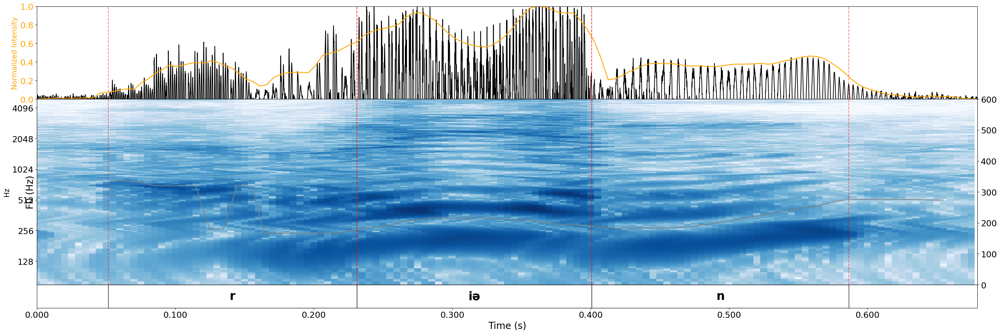

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
import textgrid
import librosa
import librosa.display
import parselmouth
import scipy.ndimage
import matplotlib.patches as patches
from matplotlib.ticker import MaxNLocator

# File paths
audio_file = "/content/riən.wav"
textgrid_file = "/content/riən.TextGrid"

def extract_f0_parselmouth(audio_file):
    """
    Extracts F0 contour using Parselmouth (Praat-based pitch tracking).
    Applies median filtering to smooth pitch curve.
    """
    snd = parselmouth.Sound(audio_file)
    pitch = snd.to_pitch(time_step=0.01, pitch_floor=75, pitch_ceiling=600)
    f0_values = pitch.selected_array['frequency']
    f0_times = pitch.xs()

    # Remove unvoiced regions (0 Hz values)
    f0_values[f0_values == 0] = np.nan

    # Apply median filtering for smoothing
    f0_values = scipy.ndimage.median_filter(f0_values, size=7)

    return f0_times, f0_values

def create_animated_riverbank(audio_file, textgrid_file, animation_type='flowing'):
    """
    Create animated version of the riverbank spectrogram.

    animation_type options:
    - 'flowing': Makes the spectrogram appear to flow like water
    - 'revealing': Progressively reveals the spectrogram from left to right
    - 'rippling': Adds ripple effects to simulate water movement
    """

    # Load audio file using Librosa
    waveform, sr = librosa.load(audio_file, sr=None)
    duration = len(waveform) / sr

    # Normalize waveform
    waveform = waveform / np.max(np.abs(waveform))

    # Compute spectrogram
    n_fft = 2048*10
    hop_length = int(sr * 0.005)  # 5ms hop size
    win_length = int(sr * 0.025)  # 25ms window

    S = librosa.stft(waveform, n_fft=n_fft, hop_length=hop_length, win_length=win_length, window="hann")
    spectrogram_db = librosa.amplitude_to_db(np.abs(S), ref=np.max)

    # Compute intensity
    intensity = librosa.feature.rms(y=waveform, frame_length=win_length, hop_length=hop_length)[0]
    intensity_time = np.linspace(0, duration, len(intensity))

    # Extract F0 using Parselmouth
    f0_time, f0 = extract_f0_parselmouth(audio_file)

    # Load TextGrid
    tg = textgrid.TextGrid.fromFile(textgrid_file)

    # Find phone tier
    phone_tier = None
    for tier in tg:
        if tier.name.lower() in ["phones", "phone"]:
            phone_tier = tier
            break

    if phone_tier is None:
        print("No phone tier found.")
        return

    # Set up the plot
    fig, axes = plt.subplots(3, 1, figsize=(30, 10),
                            gridspec_kw={'height_ratios': [2, 4, 0.5], 'hspace': 0, 'wspace': 0},
                            sharex=True)

    # Initialize plot elements
    ax_waveform = axes[0]
    ax_intensity = axes[0]
    ax_spectrogram = axes[1]
    ax_f0 = ax_spectrogram.twinx()

    # Plot static elements first
    ax_waveform.plot(np.linspace(0, duration, len(waveform)), waveform, color='black', label='Waveform')
    ax_waveform.set_xlim(0, duration)
    ax_waveform.set_ylabel("Amplitude", fontsize=20)
    ax_waveform.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=False)
    ax_waveform.tick_params(axis='y', labelsize=18)

    # Normalize intensity between 0 and 1
    intensity = (intensity - np.min(intensity)) / (np.max(intensity) - np.min(intensity))
    ax_intensity.plot(intensity_time, intensity, color='orange', alpha=0.9, linewidth=2, label='Intensity')
    ax_intensity.set_ylabel("Normalized Intensity", color='orange', fontsize=15)
    ax_intensity.set_ylim(0, 1)
    ax_intensity.tick_params(axis='y', labelcolor='orange', labelsize=18)

    # Set up spectrogram axis
    ax_spectrogram.set_ylabel("Frequency (Hz)", fontsize=15)
    ax_spectrogram.set_ylim(75, 5000)
    ax_spectrogram.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=False)
    ax_spectrogram.tick_params(axis='y', labelsize=18)

    # F0 contour setup
    ax_f0.set_ylim(0, 600)
    ax_f0.set_ylabel("F0 (Hz)", color='black', fontsize=20)
    ax_f0.tick_params(axis='y', labelcolor='black', labelsize=18)

    # Phone tier setup
    axes[2].set_ylim(0, 1)
    axes[2].set_yticks([])
    axes[2].set_xlabel('Time (s)', fontsize=20)
    axes[2].set_xlim(0, duration)
    axes[2].set_xticks(np.arange(0, duration, step=0.1))
    axes[2].tick_params(axis='x', labelsize=18)
    axes[2].xaxis.set_major_locator(MaxNLocator(integer=False))

    # Add phone tier annotations
    for interval in phone_tier:
        if interval.mark.strip():
            color = '#FFD580' if interval.mark == 'ʁ' else '#FFFFFF'
            rect = patches.Rectangle((interval.minTime, 0),
                                   interval.maxTime - interval.minTime,
                                   1,
                                   linewidth=1,
                                   edgecolor='black',
                                   facecolor=color)
            axes[2].add_patch(rect)

            axes[2].text(
                interval.minTime + (interval.maxTime - interval.minTime) / 2,
                0.5,
                interval.mark,
                ha='center',
                va='center',
                fontsize=25,
                fontweight='bold'
            )

            # Add phone boundaries
            ax_waveform.axvline(x=interval.minTime, linestyle='--', color='red', alpha=0.5)
            ax_waveform.axvline(x=interval.maxTime, linestyle='--', color='red', alpha=0.5)
            ax_spectrogram.axvline(x=interval.minTime, linestyle='--', color='red', alpha=0.5)
            ax_spectrogram.axvline(x=interval.maxTime, linestyle='--', color='red', alpha=0.5)

    # Animation function
    def animate(frame):
        ax_spectrogram.clear()
        ax_f0.clear()

        # Re-setup axes after clearing
        ax_spectrogram.set_ylabel("Frequency (Hz)", fontsize=15)
        ax_spectrogram.set_ylim(75, 5000)
        ax_spectrogram.tick_params(axis='x', which='both', bottom=True, top=False, labelbottom=False)
        ax_spectrogram.tick_params(axis='y', labelsize=18)

        ax_f0.set_ylim(0, 600)
        ax_f0.set_ylabel("F0 (Hz)", color='black', fontsize=20)
        ax_f0.tick_params(axis='y', labelcolor='black', labelsize=18)

        if animation_type == 'flowing':
            # Create flowing effect with gentle wave-like distortions (no left-right movement)
            flowing_spectrogram = spectrogram_db.copy()

            # Add gentle vertical wave distortions to simulate water movement
            for i, freq_idx in enumerate(range(flowing_spectrogram.shape[0])):
                # Create multiple wave patterns for more realistic water effect
                wave1 = np.sin(freq_idx * 0.1 + frame * 0.15) * 2  # Primary wave
                wave2 = np.cos(freq_idx * 0.08 + frame * 0.12) * 1.5  # Secondary wave
                wave3 = np.sin(freq_idx * 0.15 + frame * 0.18) * 1  # Tertiary ripple

                # Apply subtle horizontal undulation (much gentler than before)
                horizontal_shift = int(wave1 + wave2 + wave3)
                if abs(horizontal_shift) < flowing_spectrogram.shape[1]:
                    flowing_spectrogram[i] = np.roll(flowing_spectrogram[i], horizontal_shift)

            # Add subtle intensity variations to simulate water surface changes
            intensity_variation = 1 + np.sin(frame * 0.1) * 0.05  # Very subtle ±5% variation
            flowing_spectrogram = flowing_spectrogram * intensity_variation

            librosa.display.specshow(flowing_spectrogram, sr=sr, hop_length=hop_length,
                                   x_axis="time", y_axis="log", cmap='Blues', ax=ax_spectrogram)

        elif animation_type == 'revealing':
            # Progressive reveal from left to right
            progress = frame / 100.0  # Adjust for animation length
            reveal_width = int(progress * spectrogram_db.shape[1])

            if reveal_width > 0:
                revealed_spectrogram = spectrogram_db.copy()
                revealed_spectrogram[:, reveal_width:] = -80  # Hide unrevealed parts

                librosa.display.specshow(revealed_spectrogram, sr=sr, hop_length=hop_length,
                                       x_axis="time", y_axis="log", cmap='Blues', ax=ax_spectrogram)

        elif animation_type == 'rippling':
            # Add ripple effects
            rippled_spectrogram = spectrogram_db.copy()

            # Create ripples
            for i in range(rippled_spectrogram.shape[0]):
                for j in range(rippled_spectrogram.shape[1]):
                    wave1 = np.sin(i * 0.1 + j * 0.05 + frame * 0.3) * 2
                    wave2 = np.cos(i * 0.08 + j * 0.03 + frame * 0.25) * 1.5
                    rippled_spectrogram[i, j] += wave1 + wave2

            librosa.display.specshow(rippled_spectrogram, sr=sr, hop_length=hop_length,
                                   x_axis="time", y_axis="log", cmap='Blues', ax=ax_spectrogram)

        # Re-add F0 contour
        ax_f0.plot(f0_time, f0, color='grey', linewidth=1.5, label="F0 contour")

        # Re-add phone boundaries
        for interval in phone_tier:
            if interval.mark.strip():
                ax_spectrogram.axvline(x=interval.minTime, linestyle='--', color='red', alpha=0.5)
                ax_spectrogram.axvline(x=interval.maxTime, linestyle='--', color='red', alpha=0.5)

    # Create animation
    anim = animation.FuncAnimation(fig, animate, frames=200, interval=100, repeat=True)

    plt.tight_layout()

    # Save as GIF
    anim.save(f'animated_riverbank_{animation_type}.gif', writer='pillow', fps=10, dpi=100)

    # Or save as MP4 (requires ffmpeg)
    # anim.save(f'animated_riverbank_{animation_type}.mp4', writer='ffmpeg', fps=10, dpi=150)

    plt.show()

    return anim

# Create different types of animations
def create_all_animations():
    """Create all three animation types"""

    print("Creating flowing river animation...")
    anim1 = create_animated_riverbank(audio_file, textgrid_file, 'flowing')

    print("Creating revealing animation...")
    anim2 = create_animated_riverbank(audio_file, textgrid_file, 'revealing')

    print("Creating rippling water animation...")
    anim3 = create_animated_riverbank(audio_file, textgrid_file, 'rippling')

    return anim1, anim2, anim3

# Enhanced version with audio synchronization
def create_audio_synchronized_animation(audio_file, textgrid_file):
    """
    Create animation that synchronizes with the actual audio playback
    """
    import pygame

    # Load audio file using Librosa
    waveform, sr = librosa.load(audio_file, sr=None)
    duration = len(waveform) / sr

    # [Previous setup code here...]

    # Initialize pygame for audio playback
    pygame.mixer.init(frequency=sr)
    sound = pygame.mixer.Sound(waveform.astype(np.float32))

    def animate_with_audio(frame):
        # Calculate current time based on audio position
        current_time = frame * (duration / 200)  # Assuming 200 frames total

        # Create a "cursor" that follows the audio
        # [Animation code with audio synchronization...]
        pass

    # This would create a real-time synchronized animation
    pass

# Run the animations
if __name__ == "__main__":
    # Choose one animation type or create all

    # Single animation:
    anim = create_animated_riverbank(audio_file, textgrid_file, 'flowing')

    # Or create all three types:
    # create_all_animations()

# ProPer in Python

Calculating COG and SC time series...
Generated 90 COG values and 90 SC values


/tmp/ipython-input-872302076.py:472: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


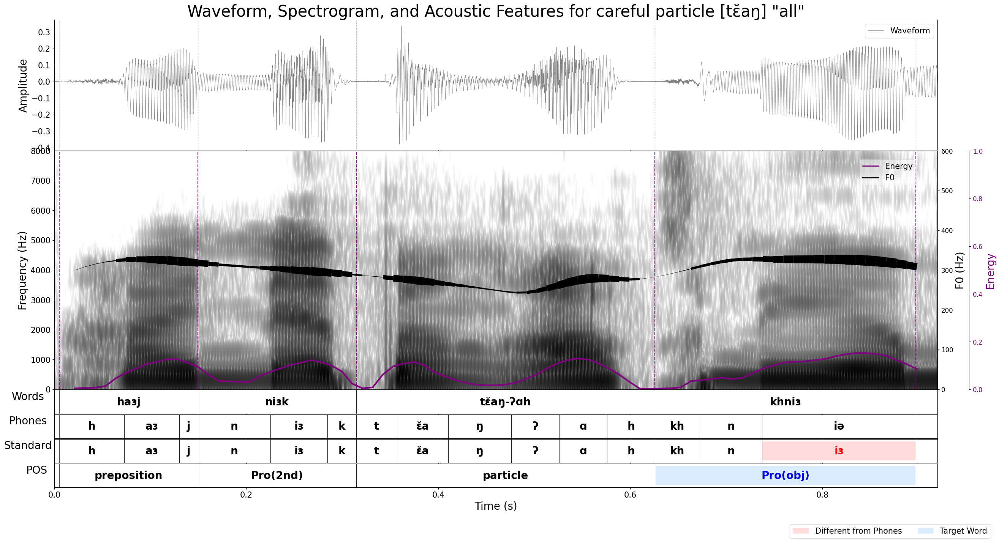

In [9]:
import glob
import pandas as pd
import parselmouth
from parselmouth.praat import call
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
import librosa
import librosa.display
from matplotlib.collections import LineCollection
from scipy.interpolate import UnivariateSpline
from praatio import tgio
from scipy.signal import medfilt
import torch
import torchaudio
import torchaudio.transforms as T

# Load audio file
audio_path = '/content/teang_careful.wav'
y, sr = librosa.load(audio_path, sr=None)

# Calculate the time duration of the audio file
duration = len(y) / sr

# Extract F0 values using Pyin algorithm
f0_values, voiced_flag, _ = librosa.pyin(y, fmin=75, fmax=600, sr=sr)
time_series = np.linspace(0, duration, num=len(f0_values))

# Add artificial zero anchor points before the beginning of the actual audio
# This forces any interpolation to start from zero
num_prefix_points = 1  # Number of artificial zero points to add
prefix_time = np.linspace(-0.1, -0.01, num_prefix_points)  # Small negative time values
prefix_f0 = np.zeros(num_prefix_points)  # All zeros
prefix_voiced = np.ones(num_prefix_points, dtype=bool)  # Mark as voiced so they're used in interpolation

# Combine the prefix with the actual data
extended_time_series = np.concatenate([prefix_time, time_series])
extended_f0_values = np.concatenate([prefix_f0, f0_values])
extended_voiced_flag = np.concatenate([prefix_voiced, voiced_flag])

# Define smoother time series for F0 plotting
window_size = 5
smooth_time = np.convolve(time_series, np.ones(window_size)/window_size, mode='valid')

# Compute energy envelope
energy = librosa.feature.rms(y=y)
scaled_energy = np.interp(smooth_time, np.linspace(0, duration, num=len(energy[0])), energy[0])

# Load TextGrid file
tg_path = '/content/teang_careful.TextGrid'
tg = tgio.openTextgrid(tg_path)

# Get boundaries and labels for all four tiers
# Words tier
words_tier = tg.tierDict['words']
words_boundaries = [(entry[0], entry[1]) for entry in words_tier.entryList]
words_labels = [entry[2] for entry in words_tier.entryList]

# Phones tier
phones_tier = tg.tierDict['phones']
phones_boundaries = [(entry[0], entry[1]) for entry in phones_tier.entryList]
phones_labels = [entry[2] for entry in phones_tier.entryList]

# Standard tier
standard_tier = tg.tierDict['Standard']
standard_boundaries = [(entry[0], entry[1]) for entry in standard_tier.entryList]
standard_labels = [entry[2] for entry in standard_tier.entryList]

# POS tier
pos_tier = tg.tierDict['pos']
pos_boundaries = [(entry[0], entry[1]) for entry in pos_tier.entryList]
pos_labels = [entry[2] for entry in pos_tier.entryList]

# Find differences between phones and Standard tiers
# Create a map of time ranges to identify overlapping segments
phone_time_map = {}
for i, (start, end) in enumerate(phones_boundaries):
    # Use a tuple of rounded values as key for more reliable matching
    key = (round(start, 3), round(end, 3))
    phone_time_map[key] = phones_labels[i]

# Find which Standard segments have different labels than the corresponding phone segments
different_segments = []
for i, (start, end) in enumerate(standard_boundaries):
    key = (round(start, 3), round(end, 3))
    if key in phone_time_map:
        if standard_labels[i] != phone_time_map[key]:
            different_segments.append(i)
    else:
        # If there's no exact match, check for overlapping segments
        for (p_start, p_end), p_label in phone_time_map.items():
            # Check for significant overlap
            if (start < p_end and end > p_start):
                if standard_labels[i] != p_label:
                    different_segments.append(i)
                break

# Identify NEG and final particle in POS tier
highlight_pos_indices = []
for i, label in enumerate(pos_labels):
    if label == "POS" or label == "Pro(obj)":
        highlight_pos_indices.append(i)

# Smooth F0 values using spline interpolation
s = 1000
# Use the extended data with prefix zero points for interpolation
spline = UnivariateSpline(extended_time_series[extended_voiced_flag],
                          extended_f0_values[extended_voiced_flag], s=s)

# Apply spline to the original smooth_time
smoothed_f0_values = spline(smooth_time)

# Explicitly force early parts to have zero F0
start_period = int(len(smoothed_f0_values) * 0.0001)  # First 5% of the audio
smoothed_f0_values[:start_period] = np.linspace(75, smoothed_f0_values[start_period], start_period)

# Handle unvoiced regions
smoothed_voiced_flag = ~np.isnan(smoothed_f0_values)
smoothed_f0_values[~smoothed_voiced_flag] = 0.0  # Set to zero instead of NaN

# Calculate Center of Gravity (COG)
def calculate_cog(audio_segment, sr):
    """Calculate the center of gravity (spectral centroid weighted by power)"""
    if len(audio_segment) < 32:
        return np.nan

    try:
        # Apply Hanning window
        n_fft = 1024
        if len(audio_segment) >= n_fft:
            windowed = audio_segment[:n_fft] * np.hanning(n_fft)
        else:
            windowed = np.zeros(n_fft)
            windowed[:len(audio_segment)] = audio_segment * np.hanning(len(audio_segment))

        # Calculate power spectrum
        spectrum = np.abs(np.fft.rfft(windowed))**2
        frequencies = np.fft.rfftfreq(n_fft, d=1.0/sr)

        # Calculate COG
        if np.sum(spectrum) > 0:
            return np.sum(frequencies * spectrum) / np.sum(spectrum)
        return np.nan
    except Exception as e:
        print(f"COG calculation error: {e}")
        return np.nan

# Calculate Spectral Centroid (SC)
def calculate_spectral_centroid(audio_segment, sr):
    """Calculate spectral centroid (weighted by magnitude, not power)"""
    if len(audio_segment) < 32:
        return np.nan

    try:
        # Apply Hanning window
        n_fft = 1024
        if len(audio_segment) >= n_fft:
            windowed = audio_segment[:n_fft] * np.hanning(n_fft)
        else:
            windowed = np.zeros(n_fft)
            windowed[:len(audio_segment)] = audio_segment * np.hanning(len(audio_segment))

        # Calculate magnitude spectrum
        spectrum = np.abs(np.fft.rfft(windowed))
        frequencies = np.fft.rfftfreq(n_fft, d=1.0/sr)

        # Calculate spectral centroid
        if np.sum(spectrum) > 0:
            return np.sum(frequencies * spectrum) / np.sum(spectrum)
        return np.nan
    except Exception as e:
        print(f"SC calculation error: {e}")
        return np.nan

# Calculate COG and SC as time series using sliding windows
print("Calculating COG and SC time series...")
window_size_seconds = 0.025  # 25ms window
hop_size_seconds = 0.010     # 10ms hop
window_size_samples = int(window_size_seconds * sr)
hop_size_samples = int(hop_size_seconds * sr)

# Initialize arrays
cog_times, cog_values = [], []
sc_times, sc_values = [], []

# Process audio in sliding windows
for start_sample in range(0, len(y) - window_size_samples, hop_size_samples):
    end_sample = start_sample + window_size_samples
    audio_segment = y[start_sample:end_sample]
    time_point = (start_sample + (window_size_samples / 2)) / sr

    # Calculate COG and SC
    cog = calculate_cog(audio_segment, sr)
    sc = calculate_spectral_centroid(audio_segment, sr)

    # Store valid values
    if np.isfinite(cog):
        cog_times.append(time_point)
        cog_values.append(cog)

    if np.isfinite(sc):
        sc_times.append(time_point)
        sc_values.append(sc)

# Convert to numpy arrays
cog_times, cog_values = np.array(cog_times), np.array(cog_values)
sc_times, sc_values = np.array(sc_times), np.array(sc_values)

# Apply median filtering to smooth out noise
if len(cog_values) > 5:
    cog_values = medfilt(cog_values, kernel_size=5)
if len(sc_values) > 5:
    sc_values = medfilt(sc_values, kernel_size=5)

# Normalize for plotting on waveform
waveform_max = np.max(np.abs(y))
if len(cog_values) > 0 and np.max(cog_values) > 0:
    cog_values_normalized = (cog_values / np.max(cog_values)) * (waveform_max * 0.5)
else:
    cog_values_normalized = np.array([])

if len(sc_values) > 0 and np.max(sc_values) > 0:
    sc_values_normalized = (sc_values / np.max(sc_values)) * (waveform_max * 0.5)
else:
    sc_values_normalized = np.array([])

print(f"Generated {len(cog_times)} COG values and {len(sc_times)} SC values")

# Compute spectrogram using the original method
n_fft = 1024 * 2
win_length = 200
hop_length = 20

# Convert audio to tensor format for consistency with original code
import torch
import torchaudio
import torchaudio.transforms as T

waveform = torch.tensor(y).float()
spectrogram_transform = T.Spectrogram(
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    power=2.0  # Power spectrogram (magnitude squared)
)

# Calculate spectrogram
S_torch = spectrogram_transform(waveform)
# Convert spectrogram to dB scale using torchaudio's method
D_torch = torchaudio.functional.amplitude_to_DB(S_torch, multiplier=10.0, amin=1e-10, db_multiplier=1.0, top_db=80.0)
D = D_torch.numpy()

# Create the figure with updated gridspec to include all four tiers
fig = plt.figure(figsize=(30, 16))  # Increased height to accommodate all tiers
gs = fig.add_gridspec(6, 1, height_ratios=[3, 5.5, 0.55, 0.55, 0.55, 0.55], hspace=0.009)  # Added two more rows for the additional tiers

# Create axes
ax_wave = fig.add_subplot(gs[0])
ax_spec = fig.add_subplot(gs[1], sharex=ax_wave)
ax_f0 = ax_spec.twinx()
ax_energy = ax_f0.twinx()
ax_words = fig.add_subplot(gs[2], sharex=ax_spec)  # Words tier
ax_phones = fig.add_subplot(gs[3], sharex=ax_spec)  # Phones tier
ax_standard = fig.add_subplot(gs[4], sharex=ax_spec)  # Standard tier
ax_pos = fig.add_subplot(gs[5], sharex=ax_spec)     # POS tier

# Plot the waveform with COG and SC
time_waveform = np.linspace(0, duration, len(y))
ax_wave.plot(time_waveform, y, color='grey', linewidth=0.5, label='Waveform')
ax_wave.set_ylabel('Amplitude', fontsize=20)
ax_wave.set_title('Waveform, Spectrogram, and Acoustic Features for careful particle [tɛ̆aŋ] "all"', fontsize=30)
ax_wave.tick_params(axis='x', labelbottom=False)
ax_wave.tick_params(axis='y', labelsize=15)
ax_wave.set_xlim(0, duration)

# Add word boundaries to waveform
for start, end in words_boundaries:
    ax_wave.axvline(x=start, color='gray', linestyle='--', linewidth=1, alpha=0.3)
    ax_wave.axvline(x=end, color='gray', linestyle='--', linewidth=1, alpha=0.3)

# Legend for waveform
ax_wave.legend(loc='upper right', framealpha=0.7, fontsize=15)

# Plot spectrogram using the original method
freq_bins = torch.fft.rfftfreq(n_fft, d=1.0/sr).numpy()
freq_mask = freq_bins <= 8000
freq_bins_limited = freq_bins[freq_mask]
D_limited = D[freq_mask, :]

img = ax_spec.pcolormesh(
    np.linspace(0, duration, D.shape[1]),
    freq_bins_limited,
    D_limited,
    cmap='gist_yarg',
    shading='gouraud'
)
ax_spec.set_ylim(0, 8000)
ax_spec.set_ylabel('Frequency (Hz)', fontsize=20)
ax_spec.tick_params(axis='x', labelbottom=False)
ax_spec.tick_params(axis='y', labelsize=15)

# Plot F0
ax_f0.yaxis.set_label_position("right")
ax_f0.yaxis.tick_right()
ax_f0.set_ylabel('F0 (Hz)', color='black', fontsize=20)
ax_f0.tick_params(axis='y', labelcolor='black', labelsize=12)
ax_f0.set_ylim(0, 600)  # Standard y-axis (not inverted)

# Plot energy
ax_energy.spines['right'].set_position(('outward', 60))
ax_energy.yaxis.set_label_position("right")
ax_energy.yaxis.tick_right()
ax_energy.set_ylabel('Energy', color='purple', fontsize=20)
ax_energy.tick_params(axis='y', labelcolor='purple', labelsize=12)
ax_energy.set_ylim(0, 1)

# Prepare F0 line with varying width based on energy
# Replace NaN values with 0 to ensure the line is drawn at the bottom for unvoiced regions
smoothed_f0_for_plot = np.nan_to_num(smoothed_f0_values, nan=0.0)

points = np.array([smooth_time, smoothed_f0_for_plot]).T.reshape(-1, 1, 2)
segments = np.concatenate([points[:-1], points[1:]], axis=1)
linewidths = scaled_energy * 130
trimmed_linewidths = linewidths[:len(segments)]
lc = LineCollection(segments, linewidths=trimmed_linewidths, color='black')
ax_f0.add_collection(lc)

# Plot energy
ax_energy.plot(smooth_time, scaled_energy, color='purple', linewidth=3)

# Word boundaries on spectrogram
for start, end in words_boundaries:
    ax_spec.axvline(x=start, color='purple', linestyle='--', linewidth=1.5, alpha=0.8)
    ax_spec.axvline(x=end, color='purple', linestyle='--', linewidth=1.5, alpha=0.8)

# Legend for spectrogram
ax_spec.legend(
    [plt.Line2D([0], [0], color='purple', linewidth=2),
     plt.Line2D([0], [0], color='black', linewidth=2)],
    ['Energy', 'F0'],
    loc='upper right',
    bbox_to_anchor=(0.98, 0.98),
    framealpha=0.5, fontsize=15
)

# ==========================================
# Plot WORDS tier
# ==========================================
ax_words.set_ylim(0, 1)
ax_words.set_ylabel('Words', fontsize=20, rotation=0)
ax_words.yaxis.set_label_coords(-0.03, 0.5)  # (x, y) coords in axis fraction
ax_words.tick_params(axis='x', labelbottom=False)  # Hide x-axis labels for words tier
ax_words.set_xlim(0, duration)

# Plot words labels
for i, ((start, end), label) in enumerate(zip(words_boundaries, words_labels)):
    # Add text label in the middle of each segment
    ax_words.text((start + end) / 2, 0.5, label,
             ha='center', va='center',
             fontsize=20, fontweight='bold')

    # Add vertical boundary lines
    ax_words.axvline(x=start, color='k', linestyle='-', linewidth=0.5)
    ax_words.axvline(x=end, color='k', linestyle='-', linewidth=0.5)

# Remove y-ticks for words plot
ax_words.set_yticks([])

# ==========================================
# Plot PHONES tier
# ==========================================
ax_phones.set_ylim(0, 1)
ax_phones.set_ylabel('Phones', fontsize=20, rotation=0)
ax_phones.yaxis.set_label_coords(-0.03, 0.5)  # (x, y) coords in axis fraction
ax_phones.tick_params(axis='x', labelbottom=False)  # Hide x-axis labels for phones tier
ax_phones.set_xlim(0, duration)

# Plot phones labels
for i, ((start, end), label) in enumerate(zip(phones_boundaries, phones_labels)):
    # Add text label in the middle of each segment
    ax_phones.text((start + end) / 2, 0.5, label,
             ha='center', va='center',
             fontsize=20, fontweight='bold')  # Slightly smaller font due to potentially more labels

    # Add vertical boundary lines
    ax_phones.axvline(x=start, color='k', linestyle='-', linewidth=0.5)
    ax_phones.axvline(x=end, color='k', linestyle='-', linewidth=0.5)

# Remove y-ticks for phones plot
ax_phones.set_yticks([])

# ==========================================
# Plot STANDARD tier with highlighting
# ==========================================
ax_standard.set_ylim(0, 1)
ax_standard.set_ylabel('Standard', fontsize=20, rotation=0)
ax_standard.yaxis.set_label_coords(-0.03, 0.5)  # (x, y) coords in axis fraction
ax_standard.tick_params(axis='x', labelbottom=False)  # Hide x-axis labels for Standard tier
ax_standard.set_xlim(0, duration)

# Plot Standard labels with highlighting for different phonemes
for i, ((start, end), label) in enumerate(zip(standard_boundaries, standard_labels)):
    # Highlight background for segments that differ from phones tier
    if i in different_segments:
        # Add a colored background for the segment that differs
        rect = plt.Rectangle((start, 0.1), end - start, 0.8,
                             facecolor='#FFCCCC', edgecolor='none', alpha=0.7)
        ax_standard.add_patch(rect)

        # Add text label with different color
        ax_standard.text((start + end) / 2, 0.5, label,
                 ha='center', va='center',
                 fontsize=20, fontweight='bold', color='red')
    else:
        # Add regular text label
        ax_standard.text((start + end) / 2, 0.5, label,
                 ha='center', va='center',
                 fontsize=20, fontweight='bold')

    # Add vertical boundary lines
    ax_standard.axvline(x=start, color='k', linestyle='-', linewidth=0.5)
    ax_standard.axvline(x=end, color='k', linestyle='-', linewidth=0.5)

# Remove y-ticks for Standard plot
ax_standard.set_yticks([])

# ==========================================
# Plot POS tier with highlighting
# ==========================================
ax_pos.set_ylim(0, 1)
ax_pos.set_ylabel('POS', fontsize=20, rotation=0)
ax_pos.yaxis.set_label_coords(-0.02, 0.5)  # (x, y) coords in axis fraction
ax_pos.set_xlabel('Time (s)', fontsize=20)  # Only add x-axis label on the bottom subplot
ax_pos.set_xlim(0, duration)
ax_pos.tick_params(axis='x', labelsize=15)  # Show x-axis labels for pos tier

# Plot POS labels with highlighting for NEG and final particle
for i, ((start, end), label) in enumerate(zip(pos_boundaries, pos_labels)):
    # Highlight NEG and final particle
    if i in highlight_pos_indices:
        # Add a colored background for the highlighted segments
        rect = plt.Rectangle((start, 0.1), end - start, 0.8,
                             facecolor='#CCE5FF', edgecolor='none', alpha=0.7)
        ax_pos.add_patch(rect)

        # Add text label with different color
        ax_pos.text((start + end) / 2, 0.5, label,
              ha='center', va='center',
              fontsize=20, fontweight='bold', color='blue')
    else:
        # Add regular text label
        ax_pos.text((start + end) / 2, 0.5, label,
              ha='center', va='center',
              fontsize=20, fontweight='bold')

    # Add vertical boundary lines
    ax_pos.axvline(x=start, color='k', linestyle='-', linewidth=0.5)
    ax_pos.axvline(x=end, color='k', linestyle='-', linewidth=0.5)

# Remove y-ticks for POS plot
ax_pos.set_yticks([])

# Add legend for the highlights
highlight_legend_elements = [
    plt.Rectangle((0, 0), 1, 1, facecolor='#FFCCCC', alpha=0.7, label='Different from Phones'),
    plt.Rectangle((0, 0), 1, 1, facecolor='#CCE5FF', alpha=0.7, label='Target Word')
]
fig.legend(handles=highlight_legend_elements, loc='lower right', bbox_to_anchor=(0.95, 0.02),
           framealpha=0.7, fontsize=15, ncol=2)

# Adjust layout and save
plt.tight_layout()
save_path = '/content/teang_careful.png'
plt.savefig(save_path, bbox_inches='tight', dpi=300)
plt.show()